In [2]:
#import libraries
import os
import numpy as np 
import pandas as pd 
from scipy.signal import resample
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
import scipy.stats as stats
import statistics as st

#import the PCA function
from sklearn.decomposition import PCA



# Step 1: Normalize all columns in every sheet to 101 data points and calculate ensemble averages of each subject

In [3]:
#create directories for Visual 3D data
kin_V3D_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/V3D_data')))
kin_V3D_data.remove('.DS_Store')
emg_V3D_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/V3D_data')))
emg_V3D_data.remove('.DS_Store')

In [4]:
#loop over each file and resample to 101 datapoints
#kinetic and kinematic
#loop through files in directory
for file_idx,file_name in enumerate(kin_V3D_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/V3D_data/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep='\t',skiprows=4)
    raw_file_headers = pd.read_csv(file_path,sep='\t',skiprows=1).columns.values.tolist()
    _,num_cols = raw_file.shape
    #preallocate a matrix to store the resampled data in
    resampled_matrix = np.zeros([101,num_cols-1])
    #loop through each column in the raw_file and resample to 101 data points
    #list of the varaibles which represent each column
    column_list=raw_file.columns
    #loop through each column
    for col_idx,column_id in enumerate(column_list[1:]):
        #get the current column as a vector
        current_col = np.array(raw_file.loc[:,column_id].dropna())
        #resample to 101 data points
        resamp_col = resample(current_col,101)
        #store resamples vector in resampled matrix
        resampled_matrix[:,col_idx] = resamp_col
        #resampled_df = pd.DataFrame(resampled_matrix, columns = raw_file_headers[1:])
        
    
    #calculate ensemble average of all strides 
    num_rows,num_cols = resampled_matrix.shape
    stride_count=num_cols/18
    
    #create an empty data array to for appending data
    #for kinetic and kinematic data
    mean_df = np.zeros((101,18))
    #for EMG data
    #mean_df = np.zeros((101,11))
    
    #loop over each set of rows determined by the stride count and average rows together
    #for kinetic and kinematic data
    for metric in range(18):
    #for EMG data
    #for metric in range(11):
        current_metric = resampled_matrix[:,int(metric*stride_count):int(metric*stride_count+stride_count)]
        mean_metric = current_metric.mean(axis=1)
        mean_df[:,metric] = mean_metric
    
    subject_mean_df = pd.DataFrame(mean_df, columns = ['hip_angle_x', 'hip_angle_y', 'hip_angle_z', 
                                                      'knee_angle_x', 'knee_angle_y', 'knee_angle_z',
                                                      'ankle_angle_x', 'ankle_angle_y', 'ankle_angle_z',
                                                      'hip_moment_x', 'hip_moment_y', 'hip_moment_z',
                                                      'knee_moment_x', 'knee_moment_y', 'knee_moment_z',
                                                      'ankle_moment_x', 'ankle_moment_y', 'ankle_moment_z'])
    
    #save the resampled df to folder
    pd.DataFrame.to_csv(subject_mean_df,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/subject_ensembles/'+file_name[:-4]+'.csv', sep=',')
    

In [5]:
#loop over each file and resample to 101 datapoints
#EMG
#loop through files in directory
for file_idx,file_name in enumerate(emg_V3D_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/V3D_data/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep='\t',skiprows=4)
    raw_file_headers = pd.read_csv(file_path,sep='\t',skiprows=1).columns.values.tolist()
    _,num_cols = raw_file.shape
    #preallocate a matrix to store the resampled data in
    resampled_matrix = np.zeros([101,num_cols-1])
    #loop through each column in the raw_file and resample to 101 data points
    #list of the varaibles which represent each column
    column_list=raw_file.columns
    #loop through each column
    for col_idx,column_id in enumerate(column_list[1:]):
        #get the current column as a vector
        current_col = np.array(raw_file.loc[:,column_id].dropna())
        #resample to 101 data points
        resamp_col = resample(current_col,101)
        #store resamples vector in resampled matrix
        resampled_matrix[:,col_idx] = resamp_col
        #resampled_df = pd.DataFrame(resampled_matrix, columns = raw_file_headers[1:])
        
    
    #calculate ensemble average of all strides 
    num_rows,num_cols = resampled_matrix.shape
    stride_count=num_cols/18
    #create an empty data array to for appending data
    mean_df = np.zeros((101,11))
    #loop over each set of rows determined by the stride count and average rows together
    for metric in range(11):
        current_metric = resampled_matrix[:,int(metric*stride_count):int(metric*stride_count+stride_count)]
        mean_metric = current_metric.mean(axis=1)
        mean_df[:,metric] = mean_metric
    
    subject_mean_df = pd.DataFrame(mean_df, columns = ['biceps_femoris', 'glute_max', 'glute_med', 
                                                      'lat_gastroc', 'med_gastroc', 'rectus_femoris',
                                                      'soleus', 'semi_tendinosus', 'tibialis_anterior',
                                                      'vastus_lateralis', 'vastus_medialis'])
    
    #save the resampled df to folder
    pd.DataFrame.to_csv(subject_mean_df,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/subject_ensembles/'+file_name[:-4]+'.csv', sep=',')

# Step 2: Generate matrices for each variable, where each row of the matrix corresponds to a subject's ensemble average and each column is a time point

In [33]:
#create directories for ensemble averages
kin_ensemble_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/subject_ensembles')))
kin_ensemble_data.remove('.DS_Store')
emg_ensemble_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/subject_ensembles')))
#emg_ensemble_data.remove('.DS_Store')

In [45]:
#create a list of subject IDs and labels for ML matrices
subject_IDs = []
for file_idx,file_name in enumerate(kin_ensemble_data):
    file_name_ = file_name.replace("_kinetic_kinematic","")
    file_name_ = file_name_.replace(".csv","")
    subject_IDs.append(file_name_)

#also create labels 
#Healthy minute 1 - 1
#Healthy minute 21 - 2
#Injured minute 1 - 3
#Injured minute 21 - 4
#Recovered minute 1 - 5
#Recovered minute 21 - 6
labels = [1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 3, 4, 5, 6, 5, 6, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 3, 4, 3, 4, 3, 4, 3, 4, 1, 2, 5, 6, 1, 2, 5, 6, 5, 6, 3, 4, 5, 6, 1, 2, 5, 6, 1, 2, 5, 6, 1, 2, 3, 4, 1, 2, 5, 6, 5, 6, 5, 6, 1, 2, 5, 6, 5, 6, 5, 6, 3, 4, 3, 4, 3, 4, 3, 4, 3, 4, 3, 4, 5, 6]
limb = ['R','R','R','R','R','R','R','R','R','R','R','R','R','R','R','R','L','L','L','L','R','R','R','R','R','R','R','R','R','R','R','R','R','R','L','L','L','L','L','L','L','L','R','R','R','R','R','R','L','L','L','L','R','R','L','L','R','R','L','L','R','R','R','R','R','R','L','L','R','R','R','R','R','R','R','R','R','R','R','R','R','R','L','L','R','R','L','L','R','R','L','L','R','R','L','L','R','R']

In [46]:
#kinetic and kinematic data
#create empty dataframes to append with data
hip_angle_x = pd.DataFrame()
hip_angle_y = pd.DataFrame()
hip_angle_z = pd.DataFrame()
knee_angle_x = pd.DataFrame()
knee_angle_y = pd.DataFrame()
knee_angle_z = pd.DataFrame()
ankle_angle_x = pd.DataFrame()
ankle_angle_y = pd.DataFrame()
ankle_angle_z = pd.DataFrame()
hip_moment_x = pd.DataFrame()
hip_moment_y = pd.DataFrame()
hip_moment_z = pd.DataFrame()
knee_moment_x = pd.DataFrame()
knee_moment_y = pd.DataFrame()
knee_moment_z = pd.DataFrame()
ankle_moment_x = pd.DataFrame()
ankle_moment_y = pd.DataFrame()
ankle_moment_z = pd.DataFrame()

#loop through files in directory
for file_idx,file_name in enumerate(kin_ensemble_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/subject_ensembles/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    raw_file = raw_file.drop(columns = 'Unnamed: 0')
    
    #append each subjects ensemble average to the dataframe
    hip_angle_x = pd.concat([hip_angle_x, raw_file['hip_angle_x']], axis=1)
    hip_angle_y = pd.concat([hip_angle_y, raw_file['hip_angle_y']], axis=1)
    hip_angle_z = pd.concat([hip_angle_z, raw_file['hip_angle_z']], axis=1)
    knee_angle_x = pd.concat([knee_angle_x, raw_file['knee_angle_x']], axis=1)
    knee_angle_y = pd.concat([knee_angle_y, raw_file['knee_angle_y']], axis=1)
    knee_angle_z = pd.concat([knee_angle_z, raw_file['knee_angle_z']], axis=1)
    ankle_angle_x = pd.concat([ankle_angle_x, raw_file['ankle_angle_x']], axis=1)
    ankle_angle_y = pd.concat([ankle_angle_y, raw_file['ankle_angle_y']], axis=1)
    ankle_angle_z = pd.concat([ankle_angle_z, raw_file['ankle_angle_z']], axis=1)
    hip_moment_x = pd.concat([hip_moment_x, raw_file['hip_moment_x']], axis=1)
    hip_moment_y = pd.concat([hip_moment_y, raw_file['hip_moment_y']], axis=1)
    hip_moment_z = pd.concat([hip_moment_z, raw_file['hip_moment_z']], axis=1)
    knee_moment_x = pd.concat([knee_moment_x, raw_file['knee_moment_x']], axis=1)
    knee_moment_y = pd.concat([knee_moment_y, raw_file['knee_moment_y']], axis=1)
    knee_moment_z = pd.concat([knee_moment_z, raw_file['knee_moment_z']], axis=1)
    ankle_moment_x = pd.concat([ankle_moment_x, raw_file['ankle_moment_x']], axis=1)
    ankle_moment_y = pd.concat([ankle_moment_y, raw_file['ankle_moment_y']], axis=1)
    ankle_moment_z = pd.concat([ankle_moment_z, raw_file['ankle_moment_z']], axis=1)
    

    
metric_dataframes = [hip_angle_x,hip_angle_y,hip_angle_z,knee_angle_x,knee_angle_y,knee_angle_z,ankle_angle_x,
                 ankle_angle_y,ankle_angle_z,hip_moment_x,hip_moment_y,hip_moment_z,knee_moment_x,knee_moment_y,
                 knee_moment_z,ankle_moment_x,ankle_moment_y,ankle_moment_z]

for df in metric_dataframes:
    variable_id = df.columns[0]
    df = df.transpose()
    df.insert(0, 'Subject_IDs', subject_IDs)
    df.insert(1, 'label', labels)
    df.insert(2, 'limb', limb)
    pd.DataFrame.to_csv(df,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices/'+variable_id+'.csv', sep=',', index=False)

In [47]:
#EMG data
#create empty dataframes to append with data
biceps_femoris = pd.DataFrame()
glute_max = pd.DataFrame()
glute_med = pd.DataFrame()
lat_gastroc = pd.DataFrame()
med_gastroc = pd.DataFrame()
rectus_femoris = pd.DataFrame()
soleus = pd.DataFrame()
semi_tendinosus = pd.DataFrame()
tibialis_anterior = pd.DataFrame()
vastus_lateralis = pd.DataFrame()
vastus_medialis = pd.DataFrame()

#loop through files in directory
for file_idx,file_name in enumerate(emg_ensemble_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/subject_ensembles/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    raw_file = raw_file.drop(columns = 'Unnamed: 0')
    
    #append each subjects ensemble average to the dataframe
    biceps_femoris = pd.concat([biceps_femoris, raw_file['biceps_femoris']], axis=1)
    glute_max = pd.concat([glute_max, raw_file['glute_max']], axis=1)
    glute_med = pd.concat([glute_med, raw_file['glute_med']], axis=1)
    lat_gastroc = pd.concat([lat_gastroc, raw_file['lat_gastroc']], axis=1)
    med_gastroc = pd.concat([med_gastroc, raw_file['med_gastroc']], axis=1)
    rectus_femoris = pd.concat([rectus_femoris, raw_file['rectus_femoris']], axis=1)
    soleus = pd.concat([soleus, raw_file['soleus']], axis=1)
    semi_tendinosus = pd.concat([semi_tendinosus, raw_file['semi_tendinosus']], axis=1)
    tibialis_anterior = pd.concat([tibialis_anterior, raw_file['tibialis_anterior']], axis=1)
    vastus_lateralis = pd.concat([vastus_lateralis, raw_file['vastus_lateralis']], axis=1)
    vastus_medialis = pd.concat([vastus_medialis, raw_file['vastus_medialis']], axis=1)
    
metric_dataframes = [biceps_femoris, glute_max, glute_med, lat_gastroc, med_gastroc,
                rectus_femoris, semi_tendinosus, soleus, tibialis_anterior, vastus_lateralis,
                vastus_medialis]


for df in metric_dataframes:
    variable_id = df.columns[0]
    df = df.transpose()
    df.insert(0, 'Subject_IDs', subject_IDs)
    df.insert(1, 'label', labels)
    df.insert(2, 'limb', limb)
    pd.DataFrame.to_csv(df,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices/'+variable_id+'.csv', sep=',', index=False)

# Step 3: Left leg subjects must be inverted because of coordinate system orientation in lab space


In [48]:
#create directories for ensemble averages
kin_variable_matrices_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices')))
kin_variable_matrices_data.remove('.DS_Store')
emg_variable_matrices_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices')))
#emg_variable_matrices_data.remove('.DS_Store')

In [49]:
for file_idx,file_name in enumerate(kin_variable_matrices_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    if "angle" in file_name: 
        
        #check if file name contains y or z because frontal and rotational planes are the only ones we need to invert
        if "z" in file_name or "y" in file_name:

            #loop over rows of dataframe
            for index, row in file.iterrows():
                if row.limb == "L":
                    file.iloc[index,3::] = file.iloc[index,3::]*-1

    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted/'+file_name[0:-4]+'.csv', sep=',', index=False)

# Step 4: Create a plot for each ensemble average

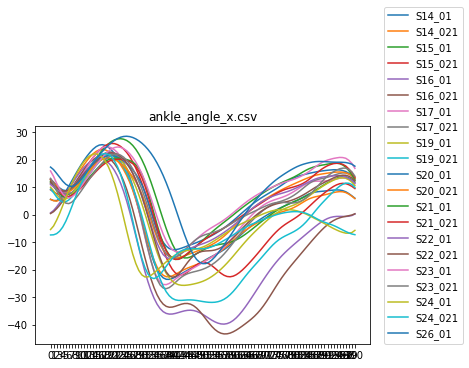

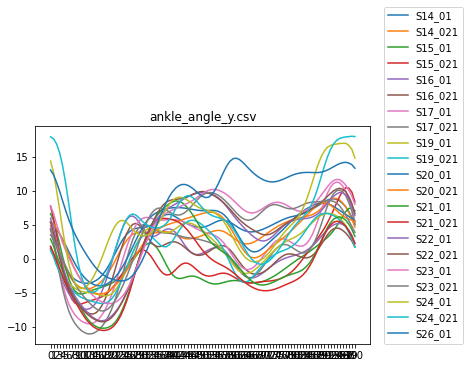

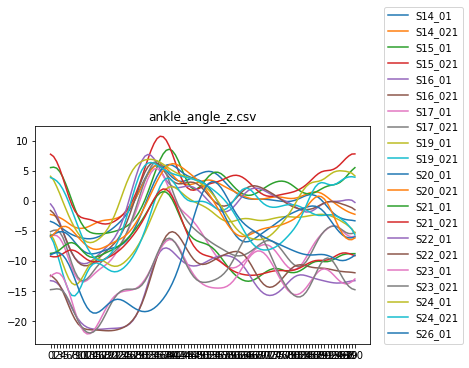

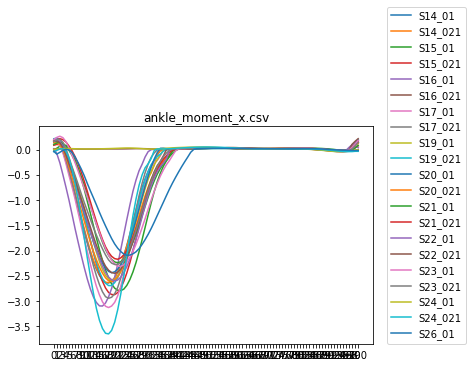

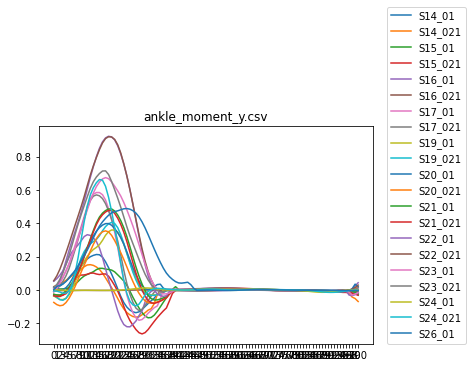

...

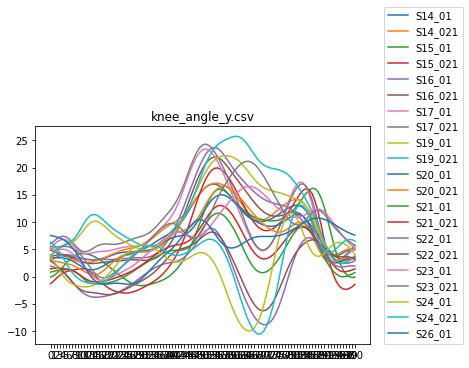

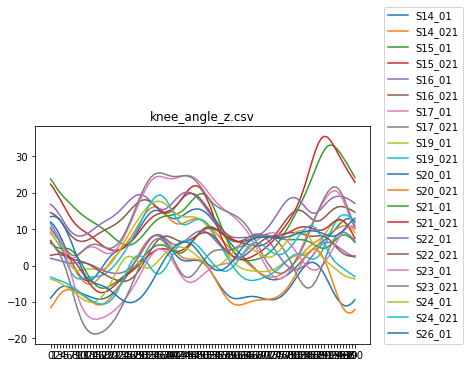

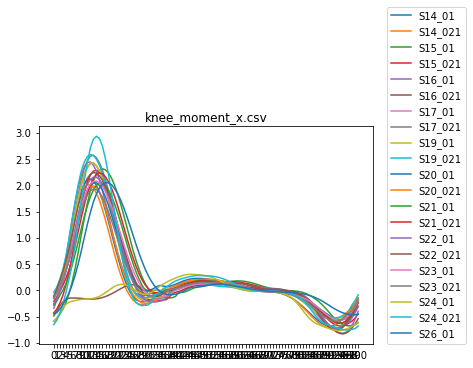

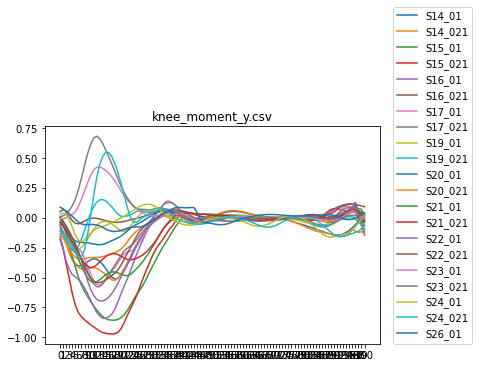

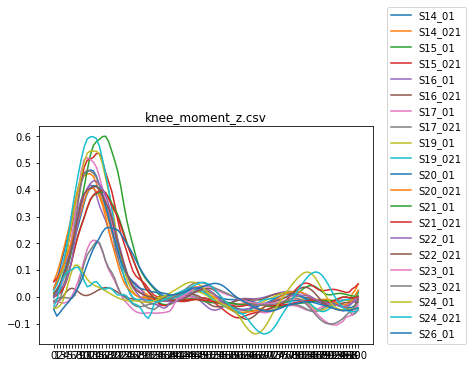

In [60]:
#create directory
kin_variable_matrices_inverted_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted')))
#kin_variable_matrices_inverted_data.remove('.DS_Store')
#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_inverted_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    #for index, row in raw_file.iterrows():
        #plt.plot(row[3:])
    #plt.title(file_name)
    #plt.show()
    
    for index, row in raw_file.iterrows():
        if index >= 20 and index <= 40:
            plt.plot(row[3:], label=row.Subject_IDs)
    
    plt.title(file_name)
    plt.legend(loc = (1.04,0))
    plt.show()
        

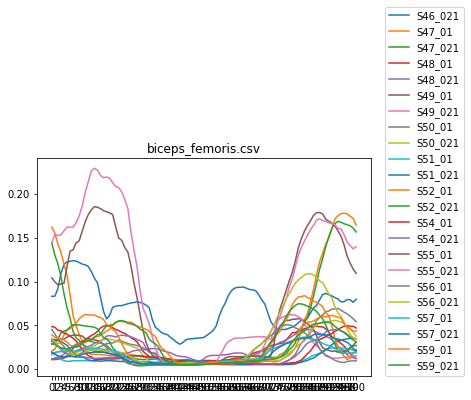

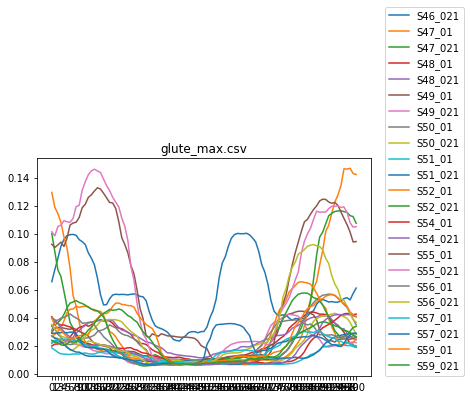

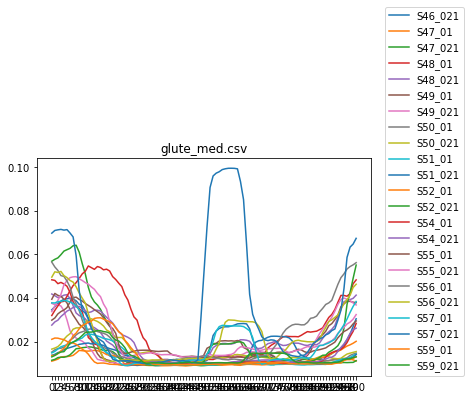

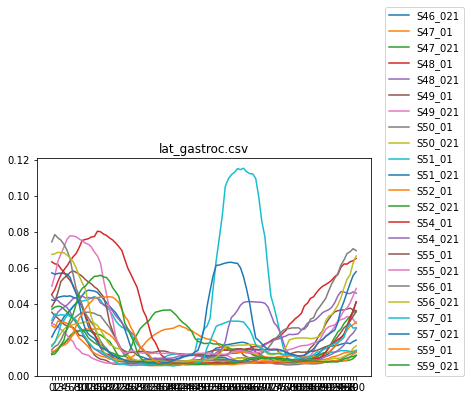

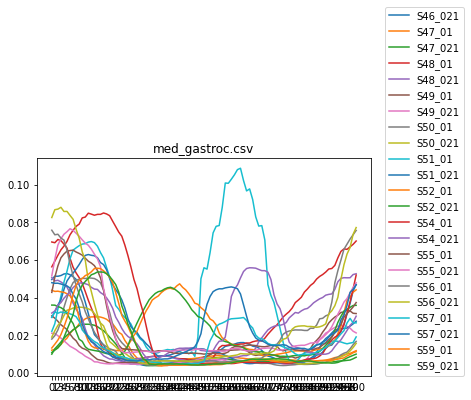

...

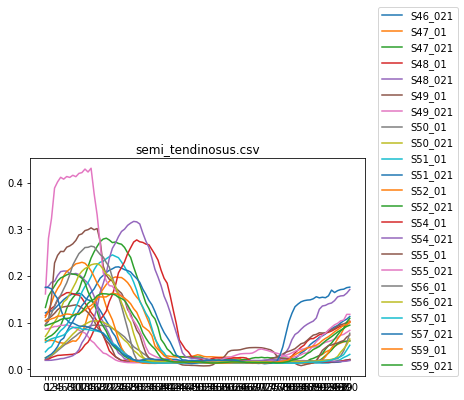

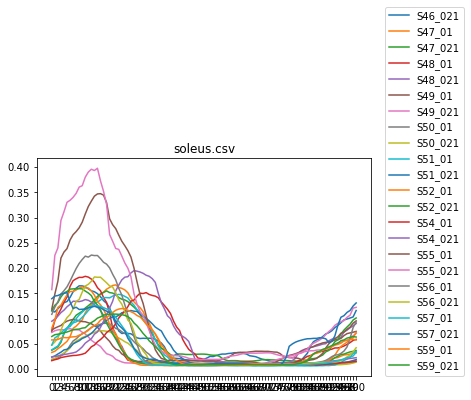

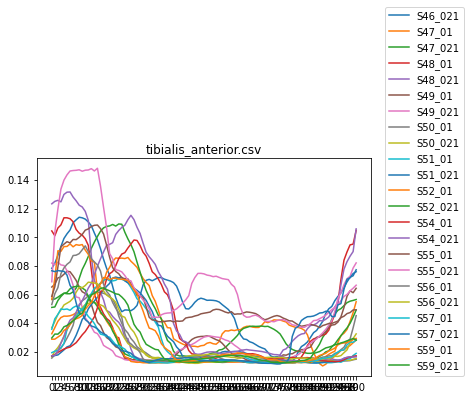

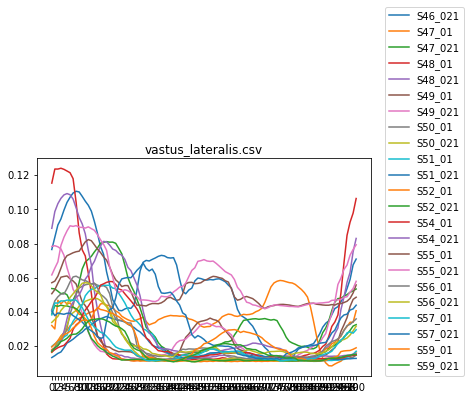

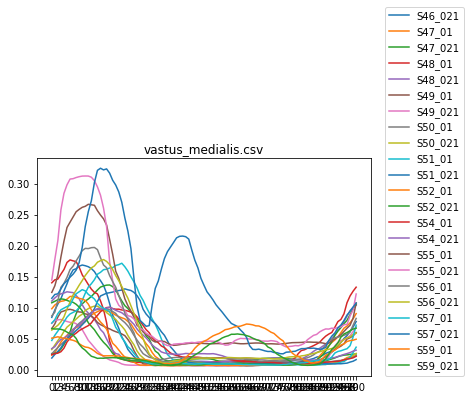

In [51]:
#repeat the plotting for EMG data
emg_variable_matrices_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices')))
#emg_variable_matrices_data.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    #for index, row in raw_file.iterrows():
        #plt.plot(row[3:])
    #plt.title(file_name)
    #plt.show()
    
    for index, row in raw_file.iterrows():
        if index >= 75 and index <= 100:
            plt.plot(row[3:], label=row.Subject_IDs)
    plt.title(file_name)
    plt.legend(loc = (1.04,0))
    plt.show()

Notes on subjects with bad signals 
Kinetic/Kinematic:
* S03_21 - noisy moments
* S08_021 - noisy moments
* S15_021 - noisy moments
* S16_021 - bad moments
* S24_01 - bad moments (especially knee)
* S31_01 - noisy moments
* S31_021 - noisy moments
* S48_01 and _021 have strange ankle adduction moments

EMG: 
* S08_01 - bad VL signal
* S20_021 - bad TA and VL signals
* S43_021 - bad rec fem signal

^Remove these subjects from both kinetic/kinematic and EMG 


Check if moments are only noisy during swing phase

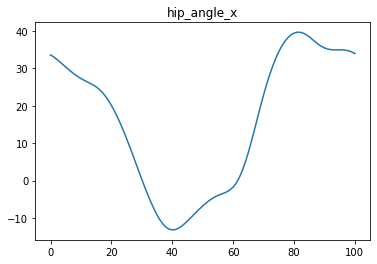

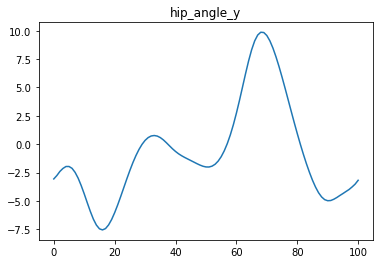

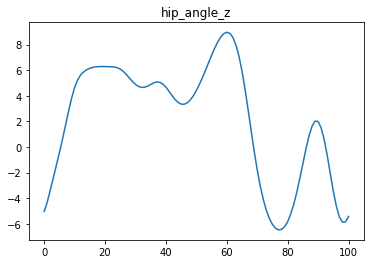

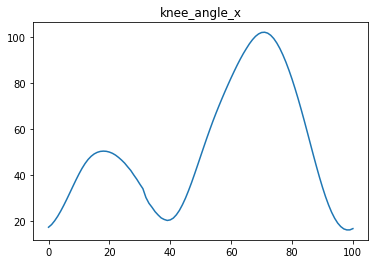

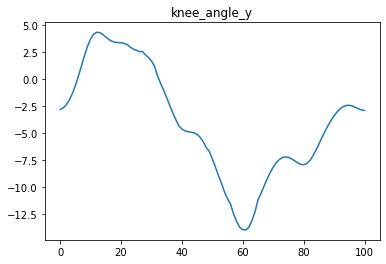

...

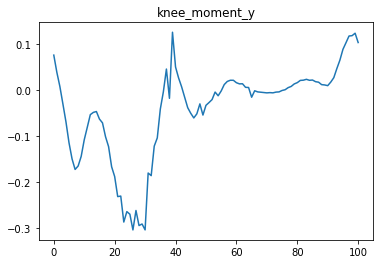

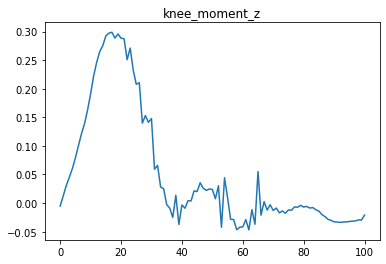

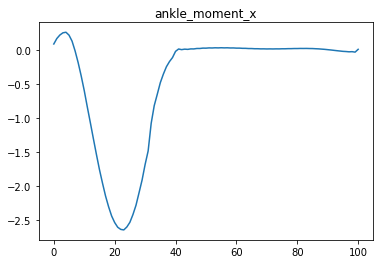

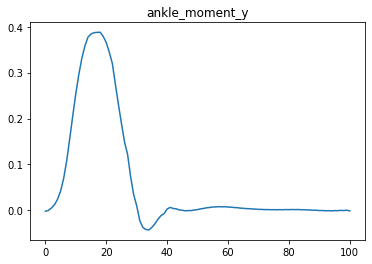

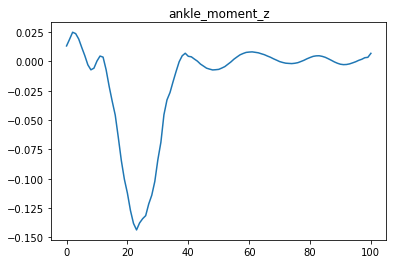

<Figure size 432x288 with 0 Axes>

In [28]:
#subject_id
#subject_id='S31_kinetic_kinematic_01'
#load file
#file = pd.read_csv('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/subject_ensembles/'+subject_id+'.csv',sep=',')
#file['hip_angle_z'] = file['hip_angle_z']*-1
#file['ankle_moment_y'] = file['ankle_moment_y']*-1
#for col in file.iloc[:,1:]:
    #plt.plot(file[col].values)
    #plt.title(col)
    #plt.show()
    #plt.clf()

#pd.DataFrame.to_csv(file, '/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/subject_ensembles/'+subject_id+'.csv',sep=',')






# Step 5: Remove noisy signals

In [173]:
#create directory
kin_variable_matrices_inverted_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted')))
#kin_variable_matrices_inverted_data.remove('.DS_Store')
#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_inverted_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #loop over rows of dataframe
    for index, row in file.iterrows():
        if "S03" in row.Subject_IDs or "S15" in row.Subject_IDs or "S08" in row.Subject_IDs or "S16" in row.Subject_IDs or "S24" in row.Subject_IDs or "S31" in row.Subject_IDs or "S20" in row.Subject_IDs or "S43" in row.Subject_IDs:
        #if "S08" in row.Subject_IDs or "S16" in row.Subject_IDs or "S24" in row.Subject_IDs or "S31" in row.Subject_IDs or "S20" in row.Subject_IDs or "S43" in row.Subject_IDs:
    
            file.drop([index], axis=0, inplace=True)
    
    #invert the KAM of subject 23
    #if file_name == 'knee_moment_y.csv':
        #sub_23_01_row = file[file['Subject_IDs'] == 'S23_01'].index[0]
        #file.iloc[sub_23_01_row, 3::] = file.iloc[sub_23_01_row, 3::]*-1
        #file.iloc[sub_23_01_row+1, 3::] = file.iloc[sub_23_01_row+1, 3::]*-1

    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers/'+file_name[0:-4]+'.csv', sep=',', index=False)


In [168]:
#create directory
emg_variable_matrices_inverted_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices')))
#kin_variable_matrices_inverted_data.remove('.DS_Store')
#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_inverted_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #loop over rows of dataframe
    for index, row in file.iterrows():
        if "S03" in row.Subject_IDs or "S15" in row.Subject_IDs or "S08" in row.Subject_IDs or "S16" in row.Subject_IDs or "S24" in row.Subject_IDs or "S31" in row.Subject_IDs or "S20" in row.Subject_IDs or "S43" in row.Subject_IDs:
        #if "S08" in row.Subject_IDs or "S16" in row.Subject_IDs or "S24" in row.Subject_IDs or "S31" in row.Subject_IDs or "S20" in row.Subject_IDs or "S43" in row.Subject_IDs:
                file.drop([index], axis=0, inplace=True)
            
    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers/'+file_name[0:-4]+'.csv', sep=',', index=False)
            

Replot the waveforms with outliers removed as a final check. Two of the knee adduction moments were flipped (S23_01 and S23_021), so I went into the variable_matrices_inverted_without_outliers and manually inverted them:

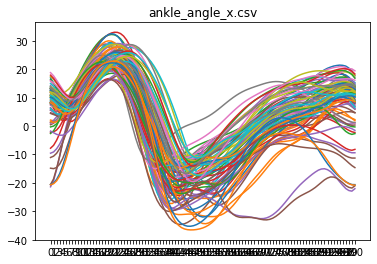

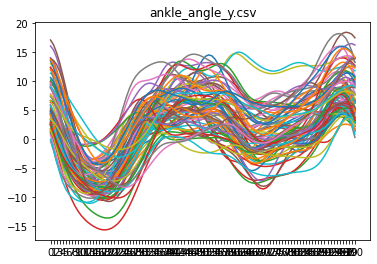

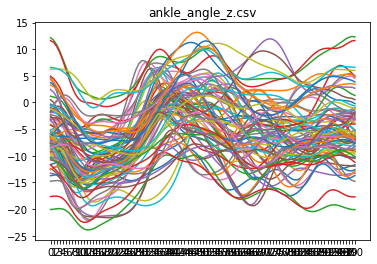

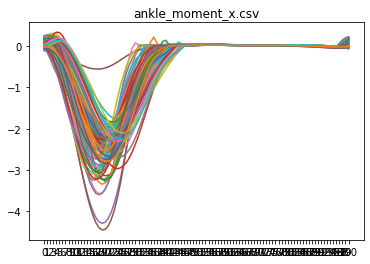

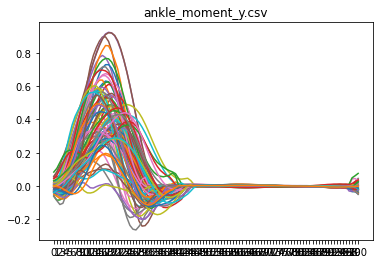

...

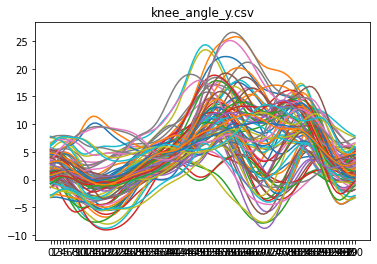

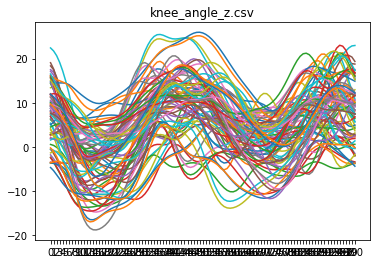

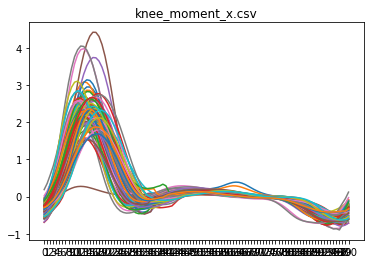

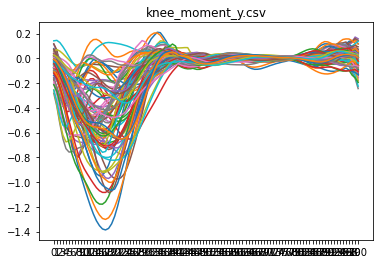

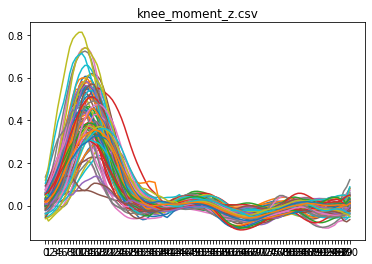

In [174]:
#create directory
kin_variable_matrices_inverted_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers')))
#kin_variable_matrices_inverted_data.remove('.DS_Store')
#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_inverted_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()
    



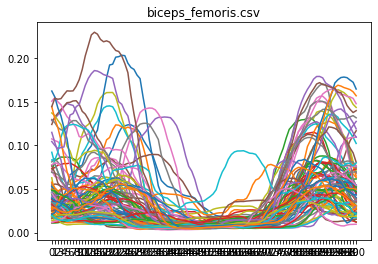

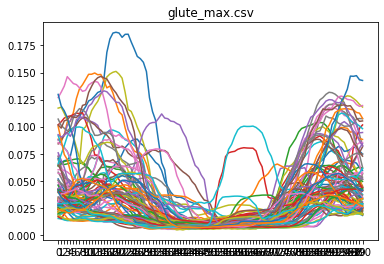

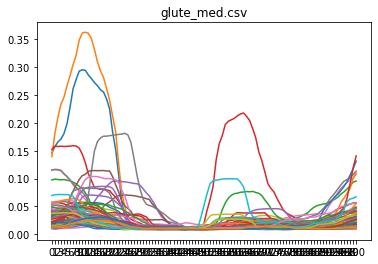

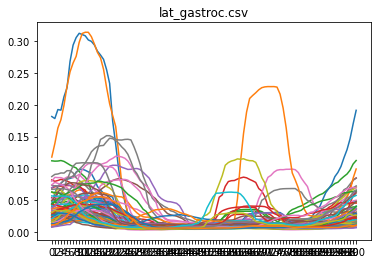

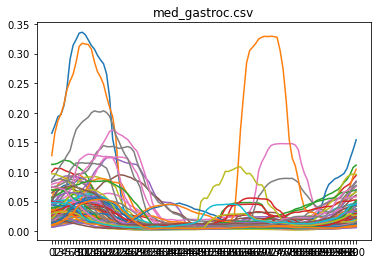

...

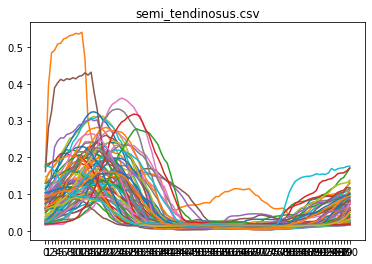

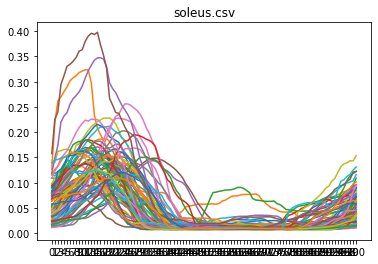

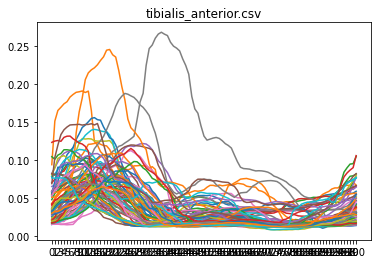

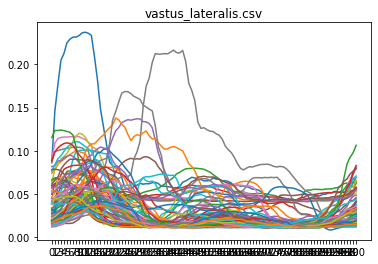

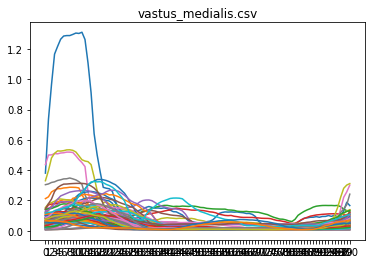

In [175]:
#create directory
emg_variable_matrices_inverted_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers')))
emg_variable_matrices_inverted_data.remove('.DS_Store')
#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_inverted_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()

# Step 6: Clip moments and angles (transverse and rotational) to stance phase. Also clip EMG to preactivation + stance phase

In [ ]:
#attempt at extrapolating, but failed
#y = clipped_row.values
#x = np.linspace(0,len(y)-1,len(y))
#new_data = interp1d(x, y, kind='linear', fill_value='extrapolate')
#x_new = np.linspace(0,100,num=101)
#resampled_row = new_data(x_new)
#plt.plot(resampled_row)

In [176]:
#determine indices of heel strike from ankle flexion moment data. Toe off is the frame where the moment is approximately 0
#create a data frame with the toe off frame for each subject
ankle_flexion_moment_data = pd.read_csv('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers/ankle_moment_x.csv')

toe_off_list = []
for index, row in ankle_flexion_moment_data.iterrows():
    for time_point, val in enumerate(row[0:50]):
        if row[time_point+3]<0 and row[time_point+4]>0:
            toe_off = time_point+5
    toe_off_list.append(toe_off)

subject_IDs = ankle_flexion_moment_data['Subject_IDs']
#convert list of toe_off indices to pandas data frame
toe_off_df = pd.DataFrame(list(zip(subject_IDs, toe_off_list)), columns=['Subject_IDs','toe_off'])    
toe_off_df

,Subject_IDs,toe_off
0,S02_01,42
1,S02_021,37
2,S05_01,42
3,S05_021,43
4,S06_01,43
...,...,...
77,S56_021,45
78,S57_01,50
79,S57_021,51
80,S59_01,46


In [180]:
#create directory for kinetic and kinematic data
kin_gc_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers/')))
#kin_gc_data.remove('.DS_Store')

#create a list of strings to search for in the file_name
matches = ['angle_y', 'angle_z', 'moment']

#loop over each file
for file_idx,file_name in enumerate(kin_gc_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_inverted_without_outliers/'+file_name)
    #load the file
    file = pd.read_csv(file_path)
    #create an empty np array to store clipped and resampled data
    resampled_matrix = np.zeros([82,101])
    #check is the file_name contains any keywords, which indicate the trials need to be clipped
    if any(x in file_name for x in matches):
        #loop over every row in the data frame
        for index, row in file.iterrows():
            #get the frame of toe_off from toe_off_df
            toe_off = toe_off_df['toe_off'][index]
            #clip the row up to the frame of toe_off
            stance_phase = row[3:toe_off]
            #resample the clipped row to 101 data points
            resampled_row = resample(stance_phase,101)
            #apply smoothing filter
            resampled_row = savgol_filter(resampled_row, 9, 3)
            #store the resampled row in the resampled matrix 
            resampled_matrix[index,:] = resampled_row
        #create a data frame using original file and clipped/resampled data matrix
        clipped_df = pd.DataFrame(resampled_matrix)
        #add the Subject_IDs, label, and limb back into the data frame
        clipped_df.insert(0,'limb',file['limb'])
        clipped_df.insert(0,'label',file['label'])
        clipped_df.insert(0,'Subject_IDs',file['Subject_IDs'])
        #overwrite the variable "file" as the clipped_df for easy saving, because not all the kinetic/kinematic data was clipped
        file = clipped_df
    #if file is sagittal plane (x), do not clip it
    else:
        file = file
    #save to new folder
    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped/'+file_name[0:-4]+'.csv', sep=',', index=False)

In [181]:
#create directory for EMG data
EMG_gc_data = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers/')))
EMG_gc_data.remove('.DS_Store')

#loop over each file
for file_idx,file_name in enumerate(EMG_gc_data):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers/'+file_name)
    #load the file
    file = pd.read_csv(file_path)
    #create an empty np array to store clipped and resampled data
    resampled_matrix = np.zeros([82,101])
    #loop over every row in the data frame
    for index, row in file.iterrows():
        #get the frame of toe_off from toe_off_df
        toe_off = toe_off_df['toe_off'][index]
        #clip the row up to the frame of toe_off
        stance_phase = row[3:toe_off]
        #pre-activation phase (last 10% of gait cycle)
        pre_activation_phase = row[-10:]
        #stack pre_activation_phase in front of stance phase
        pre_activation_plus_stance = np.concatenate((pre_activation_phase.values, stance_phase.values))
        #resample the clipped row to 101 data points
        resampled_row = resample(pre_activation_plus_stance,101)
        #apply smoothing filter
        resampled_row = savgol_filter(resampled_row, 11, 3)
        #store the resampled row in the resampled matrix 
        resampled_matrix[index,:] = resampled_row
    #create a data frame using original file and clipped/resampled data matrix
    clipped_df = pd.DataFrame(resampled_matrix)
    #add the Subject_IDs, label, and limb back into the data frame
    clipped_df.insert(0,'limb',file['limb'])
    clipped_df.insert(0,'label',file['label'])
    clipped_df.insert(0,'Subject_IDs',file['Subject_IDs'])
    #overwrite the variable "file" as the clipped_df for easy saving, because not all the kinetic/kinematic data was clipped
    file = clipped_df
    #save to new folder
    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped/'+file_name[0:-4]+'.csv', sep=',', index=False)

Plot the clipped waveforms

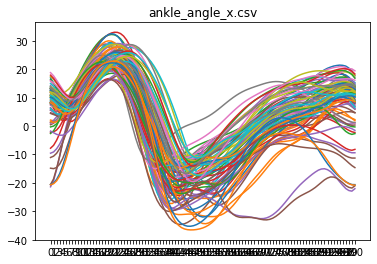

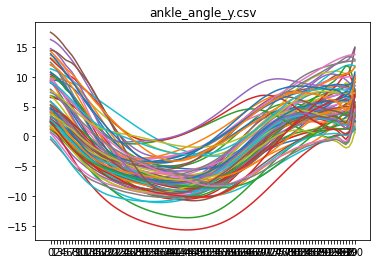

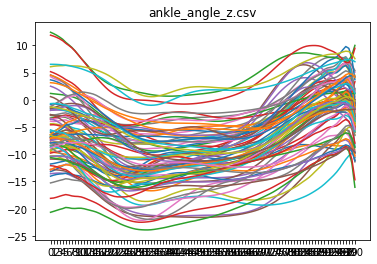

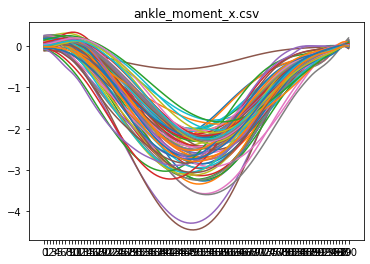

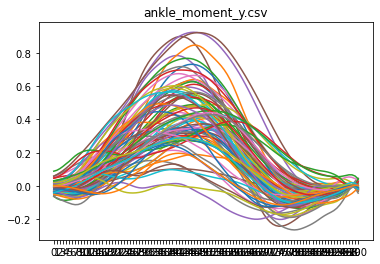

...

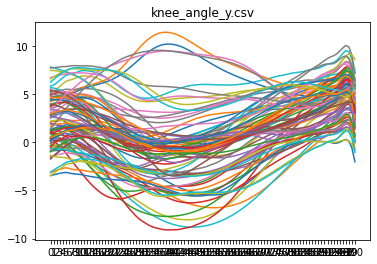

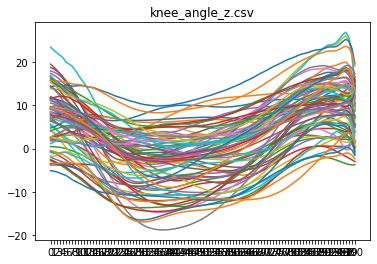

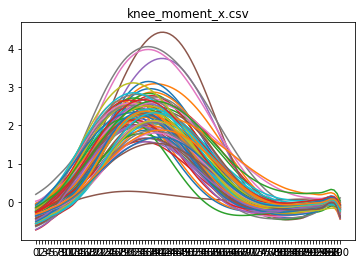

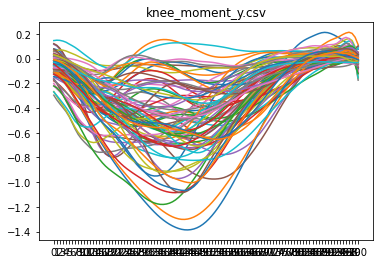

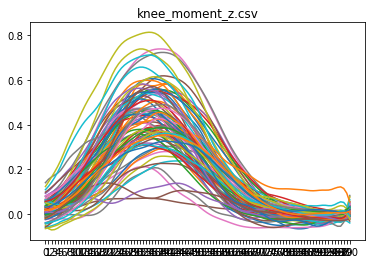

In [182]:
#create directory
kin_variable_matrices_clipped = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped')))
kin_variable_matrices_clipped.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_clipped):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()

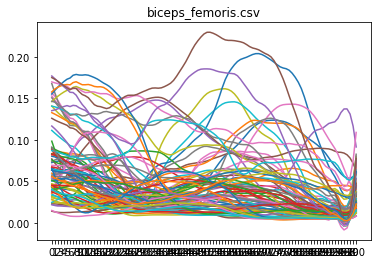

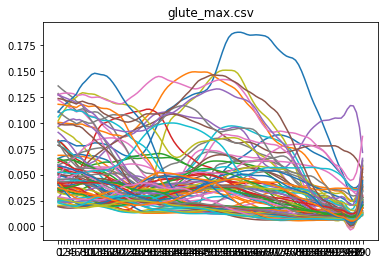

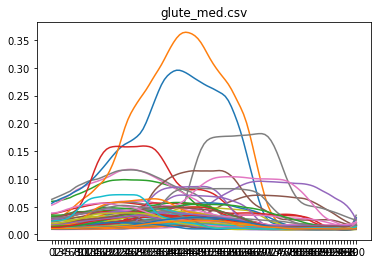

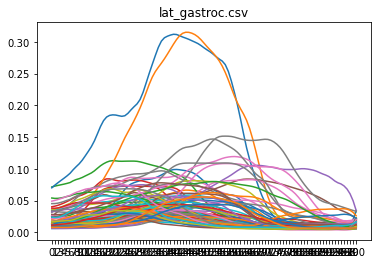

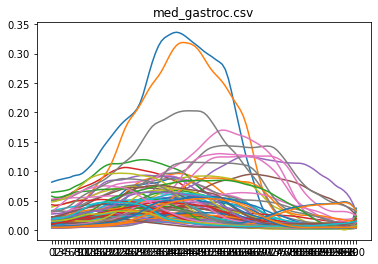

...

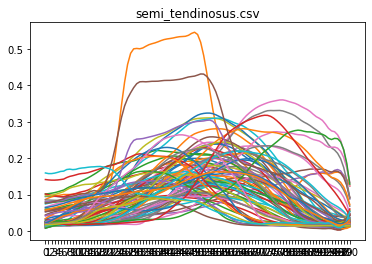

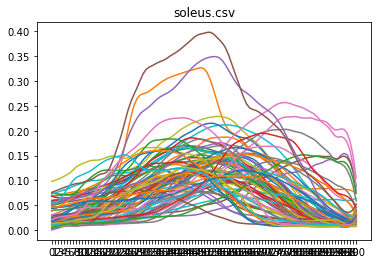

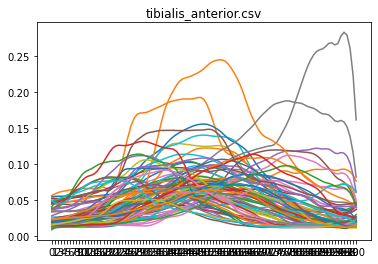

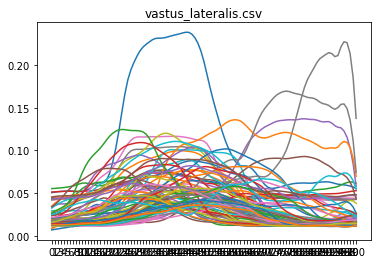

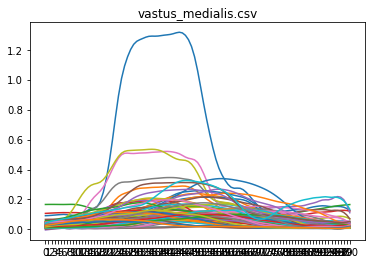

In [183]:
#create directory
emg_variable_matrices_clipped = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped')))
#emg_variable_matrices_clipped.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_clipped):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()

# Step 7: Normalization

All timepoints in EMG data should be normalized to max value of contraction during the trial and then both EMG and kinetic/kinematic should be z-transformed for PCA - Not sure if we actually need to z-score the kinetic and kinematic data?

In [184]:
#z-transform all kinetic and kinematic variables
#create directory
#gait cycle:
#kin_variable_matrices = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices')))
#stance:
kin_variable_matrices = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped')))
#kin_variable_matrices.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_clipped):
    #set variable as file path
    #gait cycle
    #file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices/'+file_name)
    #stance:
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #z-score
    for index, row in file.iterrows():
        mean = st.mean(row[3:].values)
        stdev = st.stdev(row[3:].values)
        file.iloc[index, 3:] = (file.iloc[index, 3:] - mean)/stdev
    
    #gait cycle
    #pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance
    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final_clipped/'+file_name[0:-4]+'.csv', sep=',', index=False)

In [185]:
#Divide all EMG signals by max of waveform
#create directory
#gait cycle:
#emg_variable_matrices_unormalized = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers')))
#stance:
emg_variable_matrices_unormalized = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped')))
#emg_variable_matrices_unormalized.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_unormalized):
    #set variable as file path
    #gait cycle:
    #file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_without_outliers/'+file_name)
    #stance:
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #loop over rows of dataframe
    for index, row in file.iterrows():
        #divide by max value
        file.iloc[index,3::] = file.iloc[index,3::]/max(file.iloc[index,3::])
    
    #z-score
    for index, row in file.iterrows():
        mean = st.mean(row[3:].values)
        stdev = st.stdev(row[3:].values)
        file.iloc[index, 3:] = (file.iloc[index, 3:] - mean)/stdev
    
    #gait cycle
    #pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance
    pd.DataFrame.to_csv(file,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final_clipped/'+file_name[0:-4]+'.csv', sep=',', index=False)

Replot data to check normalization

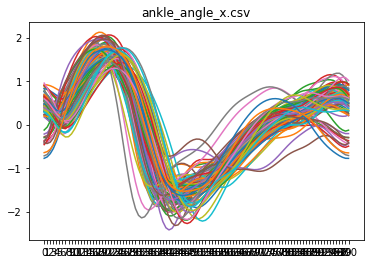

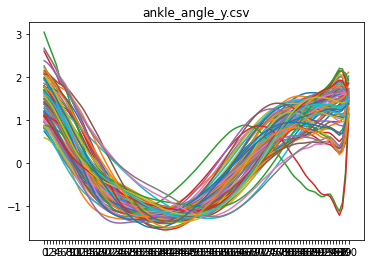

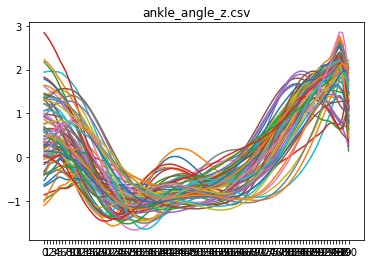

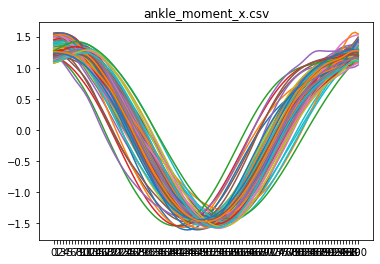

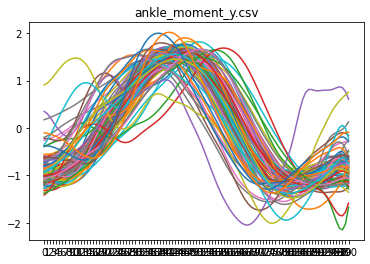

...

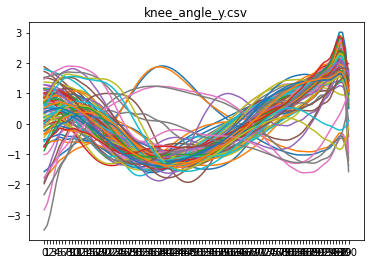

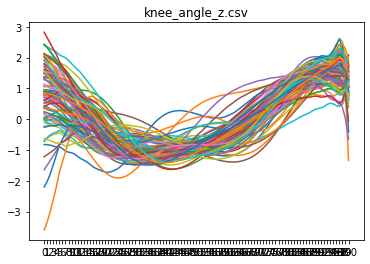

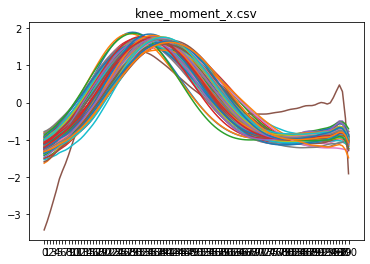

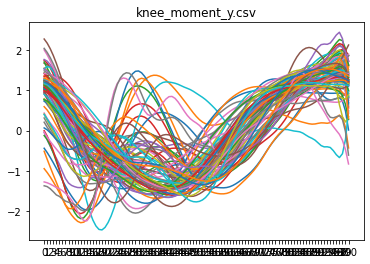

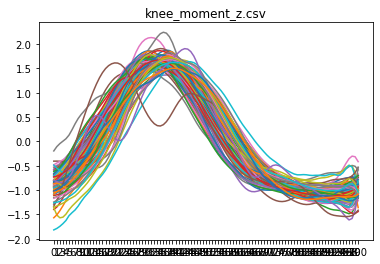

In [186]:
#create directory
kin_variable_matrices_clipped = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final_clipped')))
#kin_variable_matrices_clipped.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(kin_variable_matrices_clipped):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final_clipped/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()

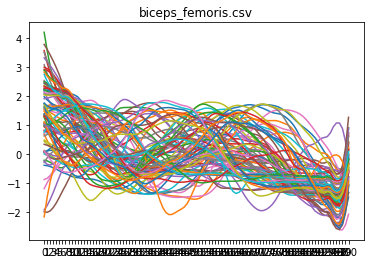

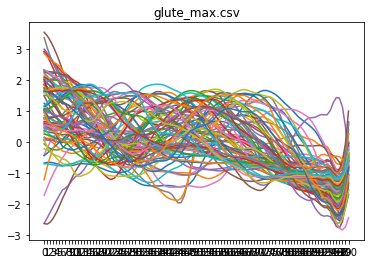

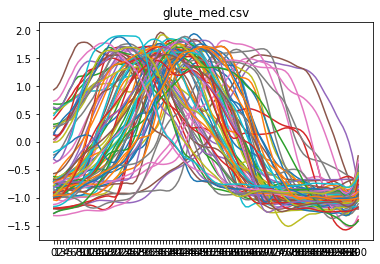

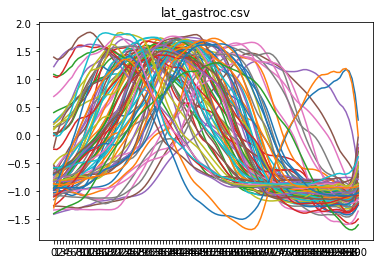

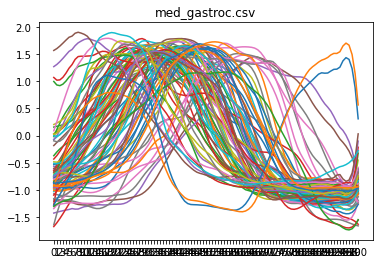

...

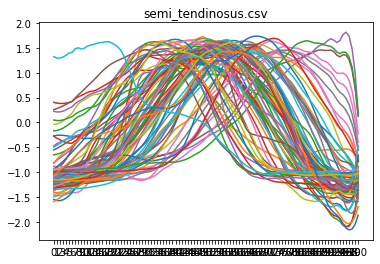

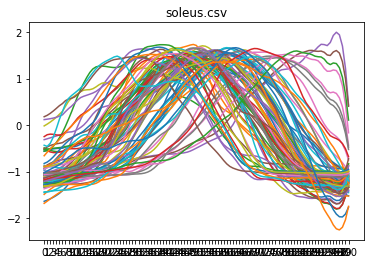

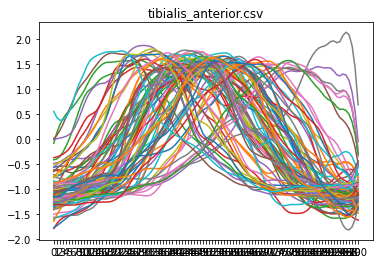

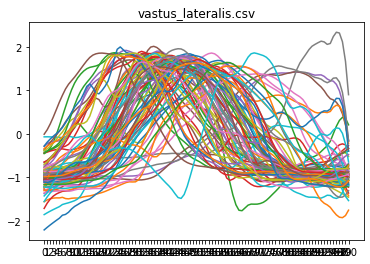

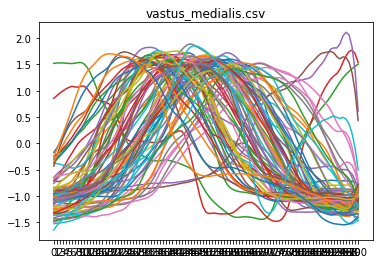

In [187]:
#create directory
emg_variable_matrices_clipped = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final_clipped')))
#emg_variable_matrices_clipped.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(emg_variable_matrices_clipped):
    #set variable as file path
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final_clipped/'+file_name)
    #load the file
    raw_file = pd.read_csv(file_path,sep=',')
    
    for index, row in raw_file.iterrows():
        plt.plot(row[3:])
    plt.title(file_name)
    plt.show()

# Step 8: Run PCA on each waveform matrix

For both kinetic/kinematic and EMG data, there were two separate PCAs ran for each variable:
1) full gait cycle data
2) only stance phase for kinetics and kinematics (only transverse and frontal plane) and all EMG

In [188]:
#create directory of kinetic and kinematic waveforms

#full gait cycle:
#kin_final_variables = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final')))
#stance phase for kinetics and kinematics (frontal and transverse):
kin_final_variables = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final_clipped')))
#kin_final_variables.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(kin_final_variables):
    #set variable as file path
    #full gait cycle:
    #file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final/'+file_name)
    #stance:
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_final_clipped/'+file_name)
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #Set data and labels
    X = file.drop(columns = ['Subject_IDs', 'label', 'limb'])
    Y = file['label']
    
    #initialize the principal component analysis
    pca = PCA()

    #fit_transform the data matrix (these are the PC scores)
    scores = pca.fit_transform(X=X)
    scores_df = pd.DataFrame(scores)
    scores_df.insert(0, 'Subject_IDs', file['Subject_IDs'])
    scores_df.insert(1, 'label', file['label'])
    
    
    #export the scores
    #full gait cycle:
    #pd.DataFrame.to_csv(scores_df,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_GC/scores/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(scores_df,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_stance/scores/'+file_name[0:-4]+'.csv', sep=',', index=False)

    #get loadings (also referred to as eigenvectors or PCs)
    loadings = pd.DataFrame(pca.components_)
    #export the loadings
    #full gait cycle:
    #pd.DataFrame.to_csv(loadings,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_GC/loadings/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(loadings,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_stance/loadings/'+file_name[0:-4]+'.csv', sep=',', index=False)

    #get explained variance
    explained_variance = pd.DataFrame(pca.explained_variance_ratio_.round(2))
    #export the explaiend variance
    #full gait cycle:
    #pd.DataFrame.to_csv(explained_variance,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_GC/explained_variance/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(explained_variance,'/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_Data_stance/explained_variance/'+file_name[0:-4]+'.csv', sep=',', index=False)


In [189]:
#create directory of EMG data

#full gait cycle:
#emg_final_variables = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final')))
#stance:
emg_final_variables = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final_clipped')))
#emg_final_variables.remove('.DS_Store')

#loop through files in directory
for file_idx,file_name in enumerate(emg_final_variables):
    #set variable as file path
    #gait cycle
    #file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final/'+file_name)
    #stance
    file_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_final_clipped/'+file_name)
    
    #load the file
    file = pd.read_csv(file_path,sep=',')
    
    #Set data and labels
    X = file.drop(columns = ['Subject_IDs', 'label', 'limb'])
    Y = file['label']
    
    #initialize the principal component analysis
    pca = PCA()

    #fit_transform the data matrix (these are the PC scores)
    scores = pca.fit_transform(X=X)
    scores_df = pd.DataFrame(scores)
    scores_df.insert(0, 'Subject_IDs', file['Subject_IDs'])
    scores_df.insert(1, 'label', file['label'])
    
    #export the scores
    #gait cycle:
    #pd.DataFrame.to_csv(scores_df,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_GC/scores/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(scores_df,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_stance/scores/'+file_name[0:-4]+'.csv', sep=',', index=False)

    #get loadings (also referred to as eigenvectors or PCs)
    loadings = pd.DataFrame(pca.components_)
    #export loadings
    #gait cycle:
    #pd.DataFrame.to_csv(loadings,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_GC/loadings/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(loadings,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_stance/loadings/'+file_name[0:-4]+'.csv', sep=',', index=False)

    #get explained variance
    explained_variance = pd.DataFrame(pca.explained_variance_ratio_.round(2))
    #gait cycle:
    #pd.DataFrame.to_csv(explained_variance,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_GC/explained_variance/'+file_name[0:-4]+'.csv', sep=',', index=False)
    #stance:
    pd.DataFrame.to_csv(explained_variance,'/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_Data_stance/explained_variance/'+file_name[0:-4]+'.csv', sep=',', index=False)



# Part 7: Concatenate the scores of the PCs that explain 90% of the variance

In [190]:
#full gait cycle or stance phase only
x_axis = 'stance'

kin_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores')))
#kin_pc_scores.remove('.DS_Store')
emg_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores')))
#emg_pc_scores.remove('.DS_Store')

#create a data frame to store the scores
all_pc_scores_df = pd.DataFrame()
all_pc_scores_df.insert(0, 'Subject_IDs', file['Subject_IDs'])
all_pc_scores_df.insert(1, 'label', file['label'])

#loop through files in directory
for file_idx,file_name in enumerate(kin_pc_scores):
    #load the scores
    scores_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores/'+file_name)
    scores_file = pd.read_csv(scores_path,sep=',')
    
    #load the explained variance
    ev_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/explained_variance/'+file_name)
    ev_file = pd.read_csv(ev_path,sep=',')
    
    total_variance = 0
    for index, row in ev_file.iterrows():
        #count total explained variance
        if total_variance < 0.9:
            total_variance = total_variance + row[0]
        
            #get row of pc score
            column_name = [file_name[0:-4]+'_PC_'+str(row.name+1)]
            all_pc_scores_df[column_name] = scores_file[str(row.name)]
            #print(column_name)
            
#Repeat for EMG scores
#loop through files in directory
for file_idx,file_name in enumerate(emg_pc_scores):
    #load the scores
    scores_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores/'+file_name)
    scores_file = pd.read_csv(scores_path,sep=',')
    
    #load the explained variance
    ev_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/explained_variance/'+file_name)
    ev_file = pd.read_csv(ev_path,sep=',')
    
    total_variance = 0
    for index, row in ev_file.iterrows():
        #count total explained variance
        if total_variance < 0.9:
            total_variance = total_variance + row[0]
        
            #get row of pc score
            column_name = [file_name[0:-4]+'_PC_'+str(row.name+1)]
            all_pc_scores_df[column_name] = scores_file[str(row.name)]
            #print(column_name)
            

pd.DataFrame.to_csv(all_pc_scores_df,'/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/data/pc_scores_90_percent_'+x_axis+'.csv', sep=',', index=False)

# Part 8: Plot Principal Components and ensemble average waveforms at M1

Currently have it set to multiply the mean score for the healthy and injured groups by the loading instead of using 5th and 95th percentile scores. 
    

----------------------
Average Healthy Score: 0.49699006650986566
Average Injured Score: -0.7578993852693685
Average Recovered Score: 0.7404252704436466


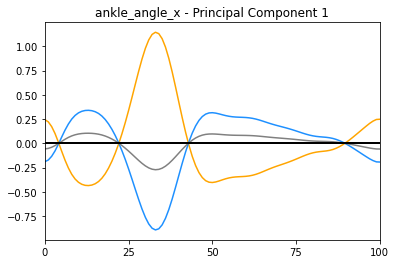

----------------------
Average Healthy Score: -0.3293642173845113
Average Injured Score: -0.878841975991245
Average Recovered Score: 0.14963532347901545


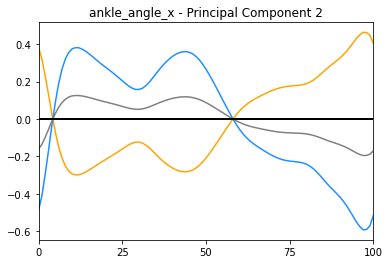

----------------------
Average Healthy Score: -0.19758721553891057
Average Injured Score: 0.2349595134298114
Average Recovered Score: 0.498018628464086


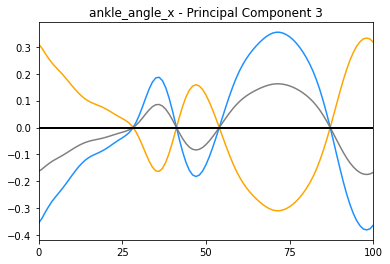

----------------------
Average Healthy Score: -0.05296480032474233
Average Injured Score: 0.03349085935691781
Average Recovered Score: 0.09357356816457142


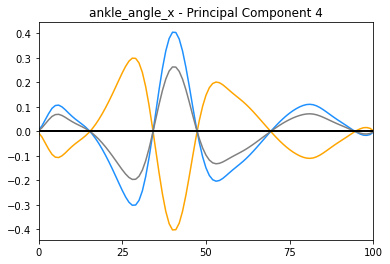

----------------------
Average Healthy Score: -0.16040824074663645
Average Injured Score: 0.06619945890034579
Average Recovered Score: -0.11417860023337566


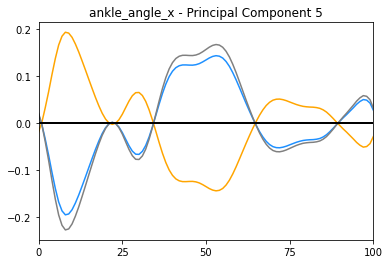

----------------------
Average Healthy Score: 0.19038360209768015
Average Injured Score: 0.16651946020950112
Average Recovered Score: -0.1691099842710577


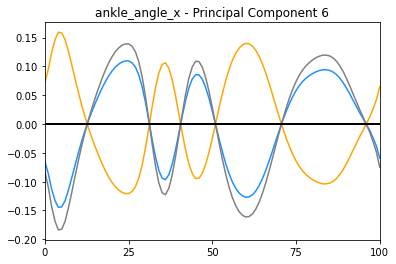

----------------------
Average Healthy Score: -0.898763145263323
Average Injured Score: 0.9866537962841925
Average Recovered Score: -0.8185669978297402


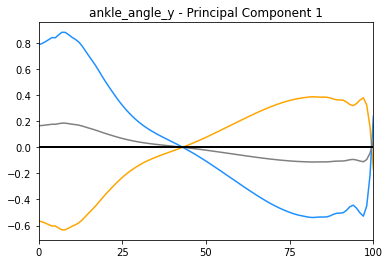

----------------------
Average Healthy Score: -0.07301615809231028
Average Injured Score: -0.725250808097219
Average Recovered Score: 1.318064522081733


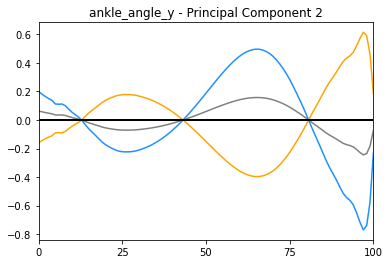

----------------------
Average Healthy Score: 0.05487089843237145
Average Injured Score: -0.26615801796493
Average Recovered Score: 0.4610641290392699


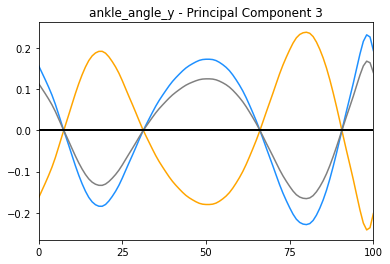

----------------------
Average Healthy Score: -0.14212323797760804
Average Injured Score: 0.07015510990525813
Average Recovered Score: -0.03520666806814543


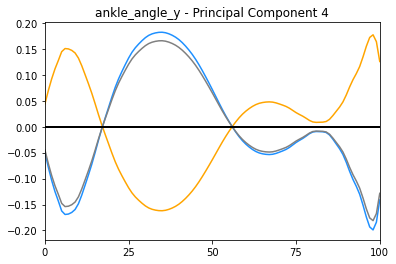

----------------------
Average Healthy Score: -0.08539077124590774
Average Injured Score: -0.0964655513487922
Average Recovered Score: 0.13037788521920976


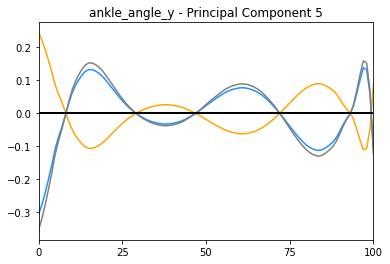

----------------------
Average Healthy Score: 0.08389296550194326
Average Injured Score: -0.060622315960268576
Average Recovered Score: -0.0812263280712773


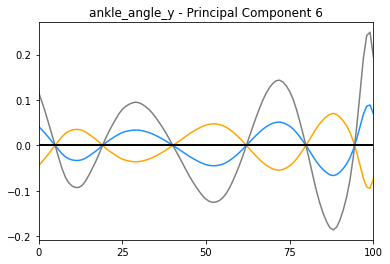

----------------------
Average Healthy Score: -1.2802962975176853
Average Injured Score: 0.6152905565153686
Average Recovered Score: -0.5707361905012457


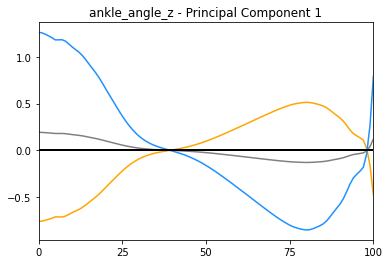

----------------------
Average Healthy Score: 0.09242245019523022
Average Injured Score: -0.2780979328233668
Average Recovered Score: 0.509144094275969


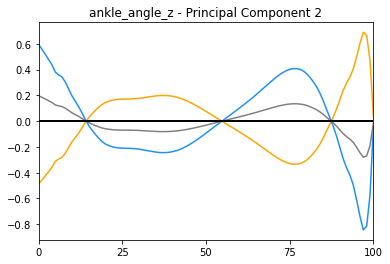

----------------------
Average Healthy Score: 0.3712012532120956
Average Injured Score: -0.5830156100564274
Average Recovered Score: -0.3310733764359918


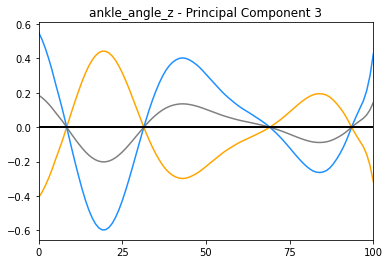

----------------------
Average Healthy Score: 0.13208535661373252
Average Injured Score: -0.30630460739060467
Average Recovered Score: 0.4085553115127227


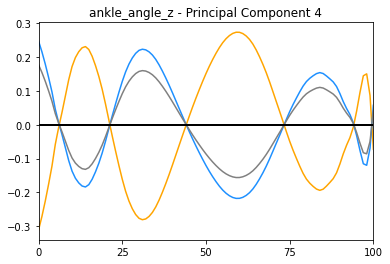

----------------------
Average Healthy Score: -0.05617425225558925
Average Injured Score: -0.08519181495450753
Average Recovered Score: 0.08333500621275884


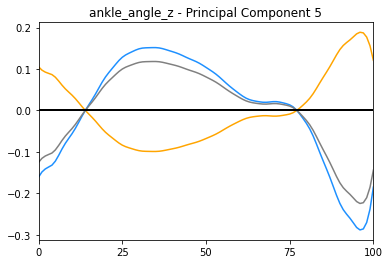

----------------------
Average Healthy Score: 0.06841657228796884
Average Injured Score: 0.10556557816257532
Average Recovered Score: -0.09562384082583258


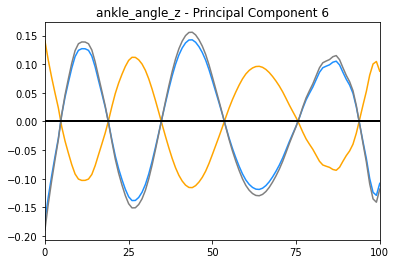

----------------------
Average Healthy Score: -0.0768306409055861
Average Injured Score: -0.8429262484888819
Average Recovered Score: 1.2829411178777406


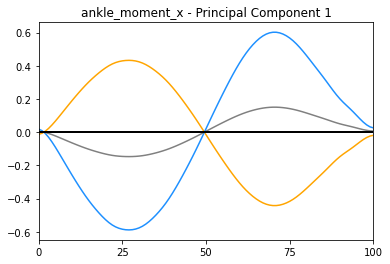

----------------------
Average Healthy Score: -0.03429479502263801
Average Injured Score: -0.11008449593426713
Average Recovered Score: 0.016877994658123407


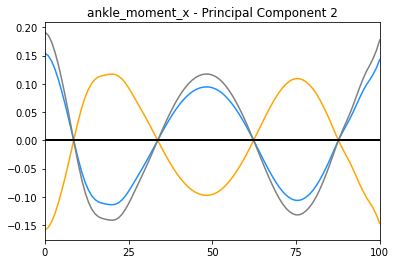

----------------------
Average Healthy Score: 0.04769370697998981
Average Injured Score: 0.0637323713069774
Average Recovered Score: -0.07534266577696093


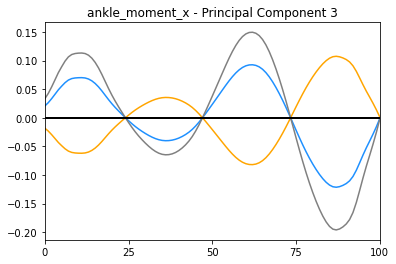

----------------------
Average Healthy Score: -0.14706027220493703
Average Injured Score: 0.08249876612852332
Average Recovered Score: 0.12273917592849914


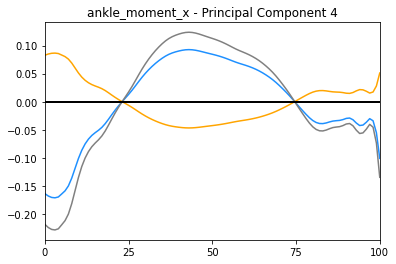

----------------------
Average Healthy Score: 0.00813791135787579
Average Injured Score: -0.0039704571548591
Average Recovered Score: -0.013677801093506484


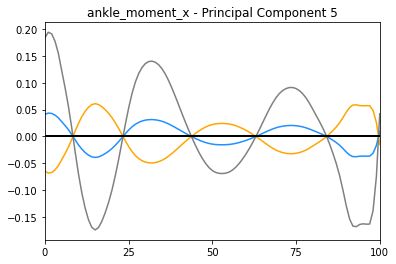

----------------------
Average Healthy Score: 0.01859495694822085
Average Injured Score: -0.00721334163771048
Average Recovered Score: 0.025161157178302442


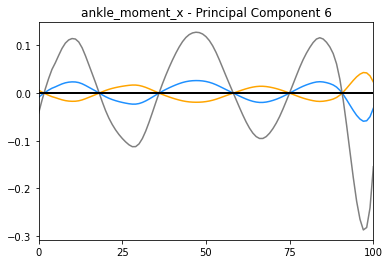

----------------------
Average Healthy Score: -0.3271217925520363
Average Injured Score: -0.5645408201076891
Average Recovered Score: 1.5210890946175397


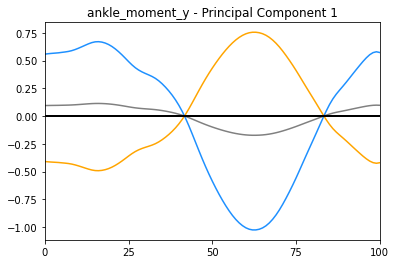

----------------------
Average Healthy Score: -0.4090156055641305
Average Injured Score: 0.2902595893619933
Average Recovered Score: -0.05598814580061499


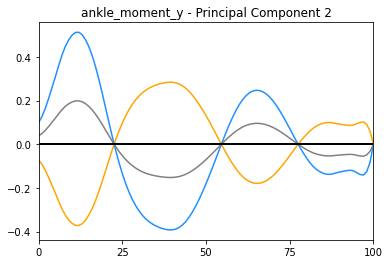

----------------------
Average Healthy Score: 0.10693354858366298
Average Injured Score: -0.0007823944147343617
Average Recovered Score: 0.0792281846625499


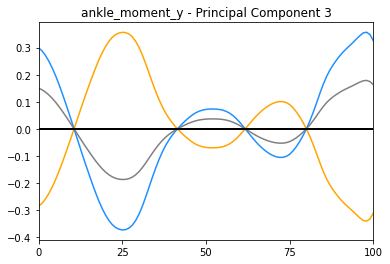

----------------------
Average Healthy Score: -0.28938876662765073
Average Injured Score: 0.08126644611148141
Average Recovered Score: 0.48575243724507633


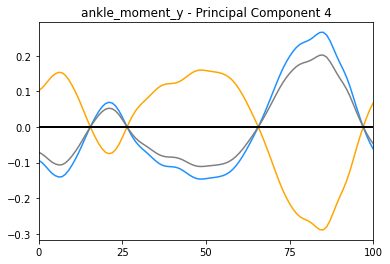

----------------------
Average Healthy Score: 0.1984545332787094
Average Injured Score: -0.11891345178398459
Average Recovered Score: -0.08960729445352474


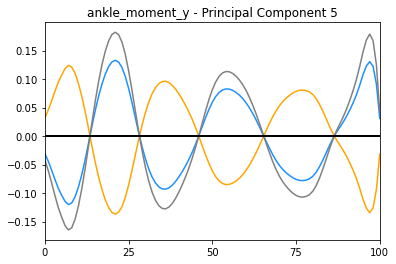

----------------------
Average Healthy Score: -0.08798232984363033
Average Injured Score: 0.07079000670692316
Average Recovered Score: -0.0428185367174768


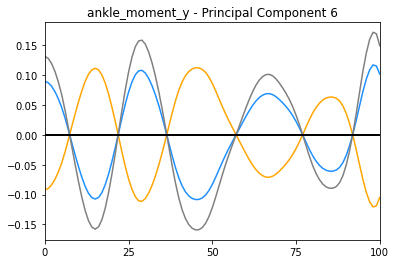

----------------------
Average Healthy Score: -0.8775990983211172
Average Injured Score: 1.8687621570048496
Average Recovered Score: -1.0727160525405093


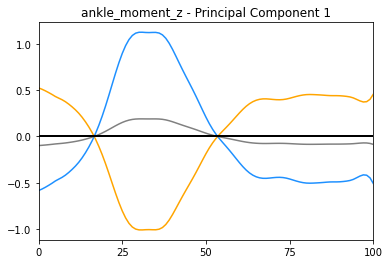

----------------------
Average Healthy Score: -0.5852172705722919
Average Injured Score: 0.0345938320774058
Average Recovered Score: 0.9164949248528181


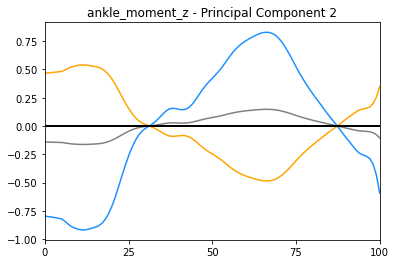

----------------------
Average Healthy Score: -0.13702433281514806
Average Injured Score: -0.15036772811753188
Average Recovered Score: -0.04192360845965557


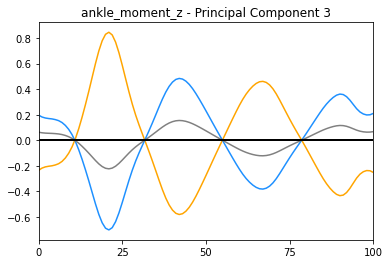

----------------------
Average Healthy Score: -0.2035099215486568
Average Injured Score: -0.5078749173324141
Average Recovered Score: 0.9985588901062904


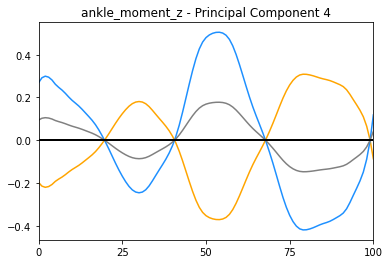

----------------------
Average Healthy Score: 0.007345735424732418
Average Injured Score: 0.2452985539735699
Average Recovered Score: -0.19176345838005804


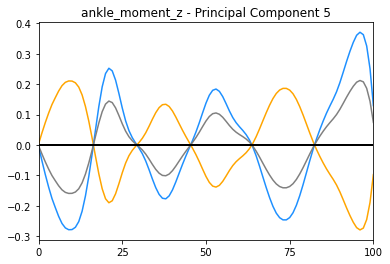

----------------------
Average Healthy Score: -0.025714141586380673
Average Injured Score: -0.028481916118175243
Average Recovered Score: -0.07403004820825364


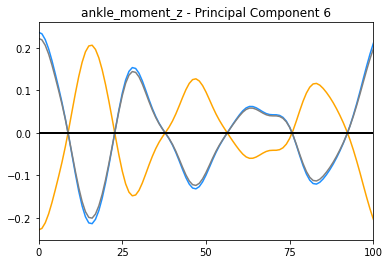

----------------------
Average Healthy Score: 0.505190591385903
Average Injured Score: -0.5530242200340559
Average Recovered Score: -0.11379271304200883


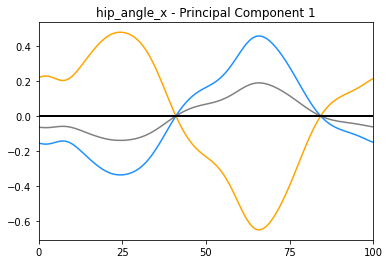

----------------------
Average Healthy Score: -0.09046744920653217
Average Injured Score: 0.06719769564456875
Average Recovered Score: 0.051973780943464006


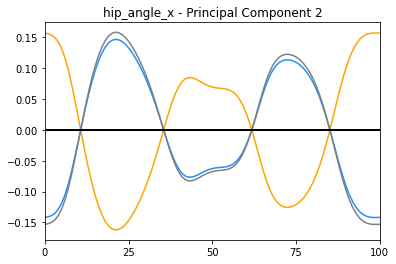

----------------------
Average Healthy Score: 0.06774893256352715
Average Injured Score: 0.09172558247993423
Average Recovered Score: 0.039550059206362044


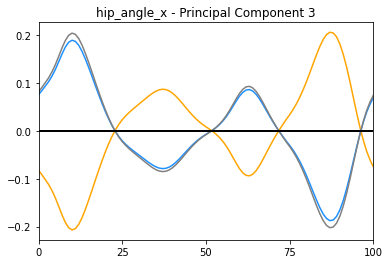

----------------------
Average Healthy Score: -0.10840855550334837
Average Injured Score: 0.033349551239097205
Average Recovered Score: 0.030195114934664553


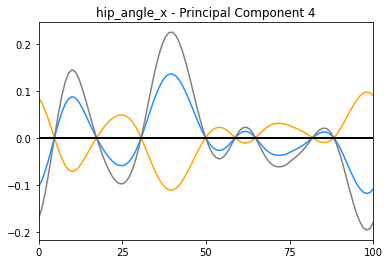

----------------------
Average Healthy Score: -0.0748650767466121
Average Injured Score: 0.0006827330554485256
Average Recovered Score: -0.02771921822925302


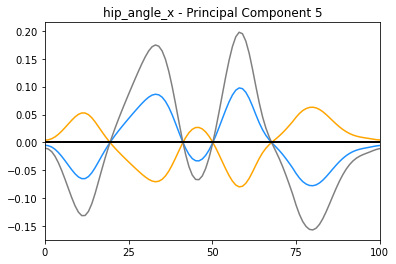

----------------------
Average Healthy Score: 0.07132455079280327
Average Injured Score: -0.020847687428560448
Average Recovered Score: -0.04521321050250195


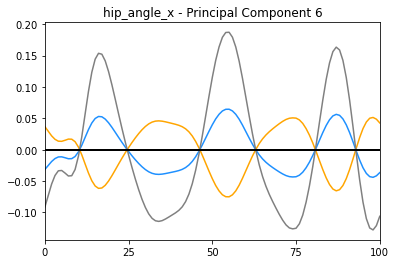

----------------------
Average Healthy Score: 1.195384148899436
Average Injured Score: -0.7392064030948469
Average Recovered Score: -0.06513837550132051


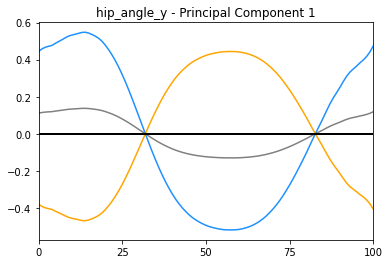

----------------------
Average Healthy Score: 0.3541209150171158
Average Injured Score: -0.5206705287140586
Average Recovered Score: 0.37521832477050054


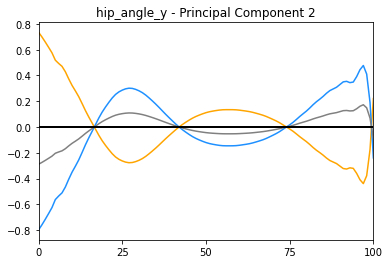

----------------------
Average Healthy Score: -0.11346453205439838
Average Injured Score: 0.13345799658899749
Average Recovered Score: 0.0016468641829122295


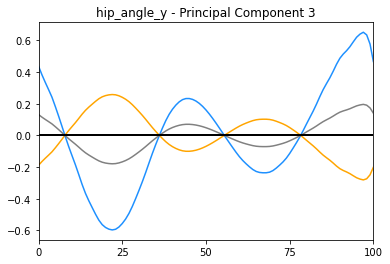

----------------------
Average Healthy Score: -0.1723481455586188
Average Injured Score: 0.12920839609636012
Average Recovered Score: -0.2926487346269206


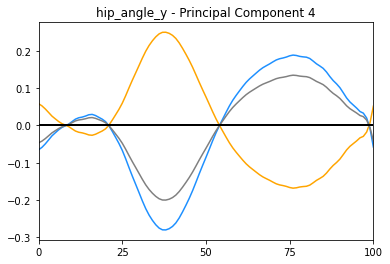

----------------------
Average Healthy Score: -0.1993284752688864
Average Injured Score: 0.0666970433452098
Average Recovered Score: -0.1366948162416449


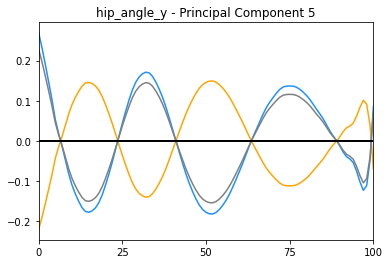

----------------------
Average Healthy Score: -0.15395724813301725
Average Injured Score: 0.07313103333165004
Average Recovered Score: 0.06440084982241821


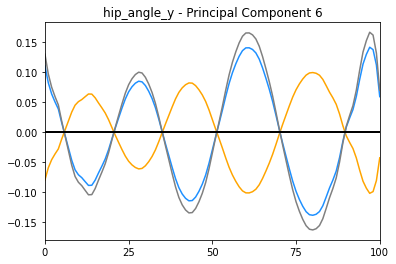

----------------------
Average Healthy Score: -0.683601620732587
Average Injured Score: 0.6405227921514982
Average Recovered Score: -0.06916146428206064


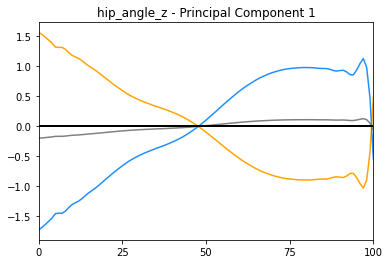

----------------------
Average Healthy Score: 1.2798831639583987
Average Injured Score: -0.46693291393651176
Average Recovered Score: 0.15628903615024803


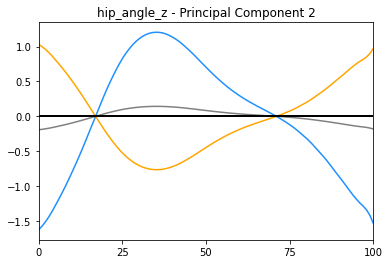

----------------------
Average Healthy Score: 0.1968315375529364
Average Injured Score: 0.9921997692369876
Average Recovered Score: -1.5177857200981268


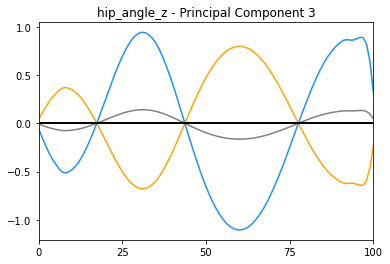

----------------------
Average Healthy Score: 0.5535440515082916
Average Injured Score: -0.7418220892021843
Average Recovered Score: 0.16745423144836216


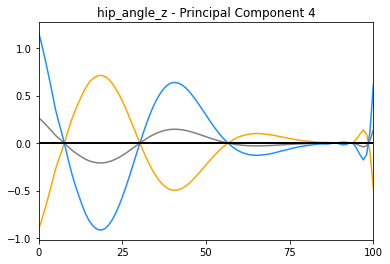

----------------------
Average Healthy Score: -0.1865325953186516
Average Injured Score: 0.3870833667348184
Average Recovered Score: 0.3350816620229144


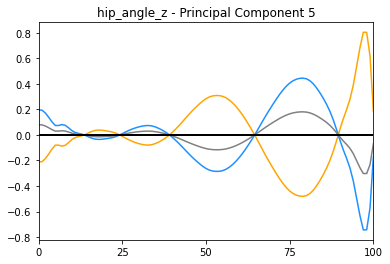

----------------------
Average Healthy Score: 0.05794786270178576
Average Injured Score: 0.37616745186974204
Average Recovered Score: -0.30859319689806497


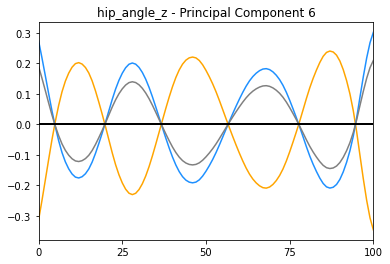

----------------------
Average Healthy Score: -0.2195656960412373
Average Injured Score: -0.030663888551686273
Average Recovered Score: -0.14006074883706643


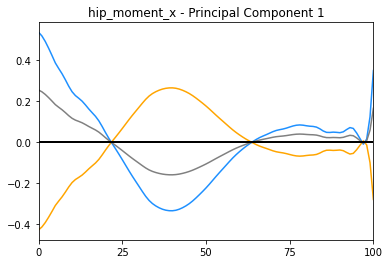

----------------------
Average Healthy Score: 0.06667013522165763
Average Injured Score: 0.08829234124463603
Average Recovered Score: -0.3558285977216158


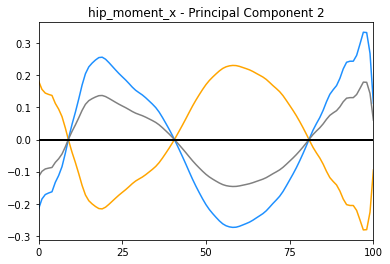

----------------------
Average Healthy Score: -0.13595169876332322
Average Injured Score: -0.07482399192190749
Average Recovered Score: 0.04132352013062233


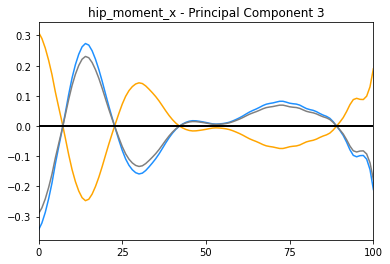

----------------------
Average Healthy Score: 0.1680475698921353
Average Injured Score: 0.0733287192441978
Average Recovered Score: 0.1438832439964954


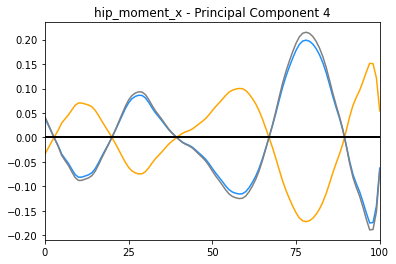

----------------------
Average Healthy Score: -0.0076863901603556346
Average Injured Score: 0.06857343133143498
Average Recovered Score: -0.1800591672675846


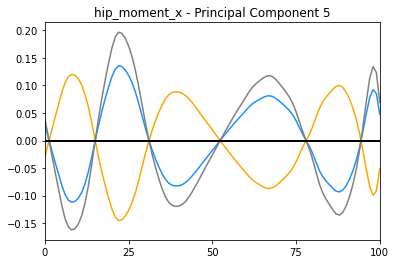

----------------------
Average Healthy Score: 0.05558319414546949
Average Injured Score: -0.05061444125460955
Average Recovered Score: -0.05525759642110769


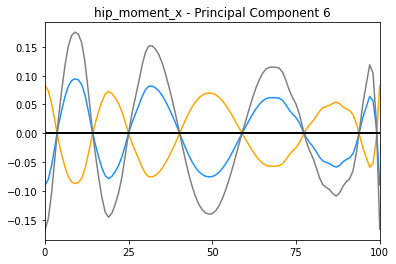

----------------------
Average Healthy Score: 3.7307424776373863
Average Injured Score: -2.3217401277788774
Average Recovered Score: -0.619128685888651


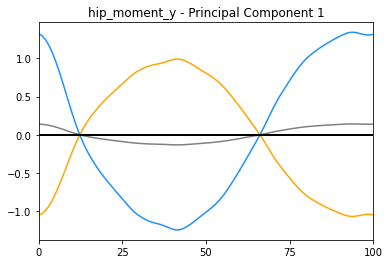

----------------------
Average Healthy Score: -0.44592370280198035
Average Injured Score: -0.010937756064166424
Average Recovered Score: 0.48913043027332154


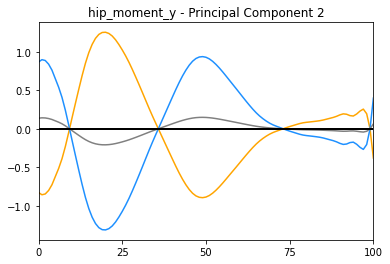

----------------------
Average Healthy Score: -1.1194593011031315
Average Injured Score: 1.455381320813587
Average Recovered Score: -1.6306420229565515


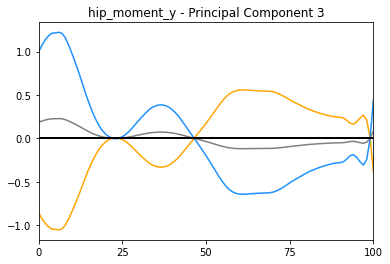

----------------------
Average Healthy Score: -0.5639210786697156
Average Injured Score: -0.3201880324932658
Average Recovered Score: 0.8378514498218524


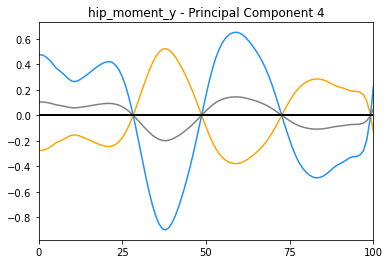

----------------------
Average Healthy Score: 0.1789177570545574
Average Injured Score: -0.024834960068399945
Average Recovered Score: 0.30523329449330666


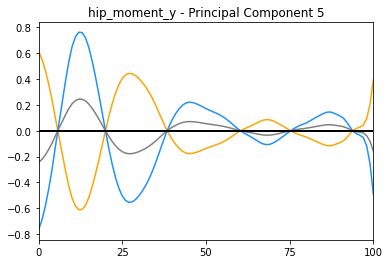

----------------------
Average Healthy Score: -0.004257309339337473
Average Injured Score: -0.0023024497021192337
Average Recovered Score: 0.04706814160126305


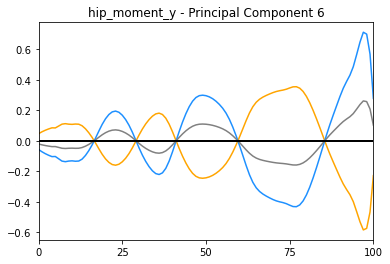

----------------------
Average Healthy Score: -0.27591323732934625
Average Injured Score: 0.2347162381403201
Average Recovered Score: -0.364120076043686


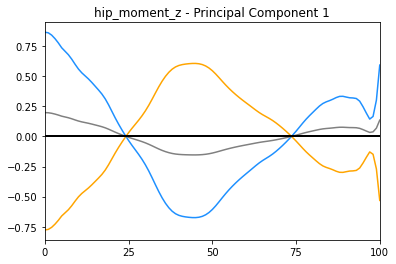

----------------------
Average Healthy Score: 0.7750440049118938
Average Injured Score: -0.4804176297867548
Average Recovered Score: -0.0782692632297247


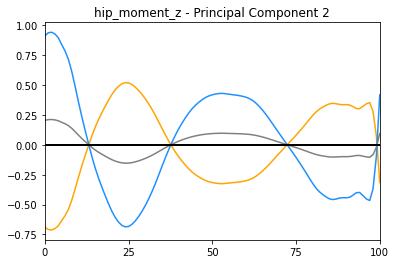

----------------------
Average Healthy Score: 0.8476419744085693
Average Injured Score: -0.41930851555891097
Average Recovered Score: -0.1684139268873833


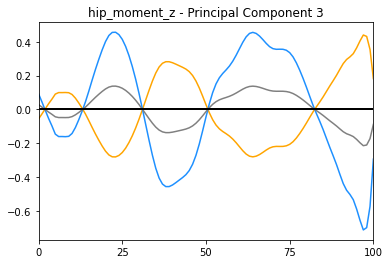

----------------------
Average Healthy Score: 0.25773802189365613
Average Injured Score: 0.035800402066037997
Average Recovered Score: -0.46934478112405936


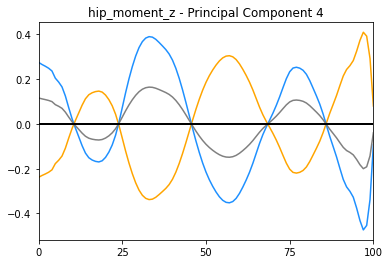

----------------------
Average Healthy Score: 0.03294664525370824
Average Injured Score: 0.014686928252185696
Average Recovered Score: 0.015959677174972948


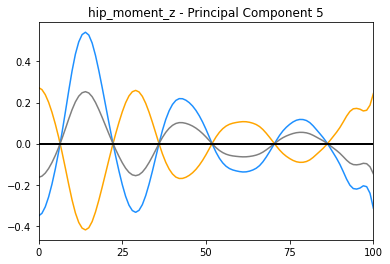

----------------------
Average Healthy Score: -0.136158826584148
Average Injured Score: 0.35424399426614434
Average Recovered Score: -0.0033856588148890123


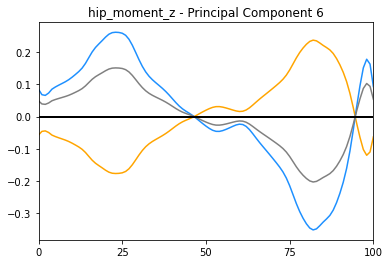

----------------------
Average Healthy Score: 0.44883409351580794
Average Injured Score: -0.4440632508983788
Average Recovered Score: 0.08747998297830845


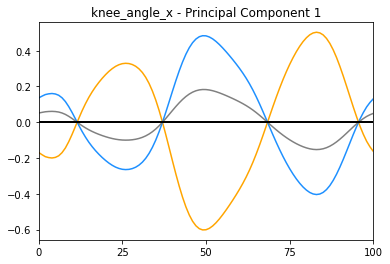

----------------------
Average Healthy Score: -0.2546017801398643
Average Injured Score: 0.08661199167114482
Average Recovered Score: 0.15461378467446096


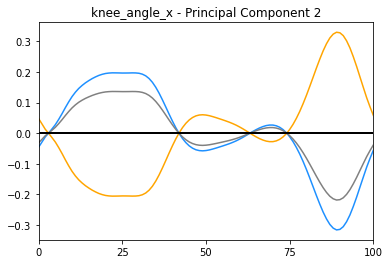

----------------------
Average Healthy Score: -0.1968987647740149
Average Injured Score: 0.3460293837797451
Average Recovered Score: -0.2559222177141141


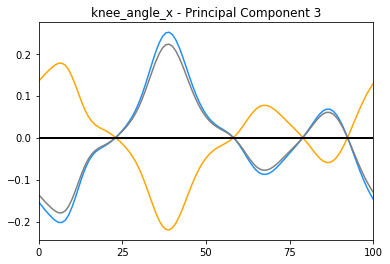

----------------------
Average Healthy Score: -0.051441830440154344
Average Injured Score: -0.08546205865310019
Average Recovered Score: 0.1522154198355451


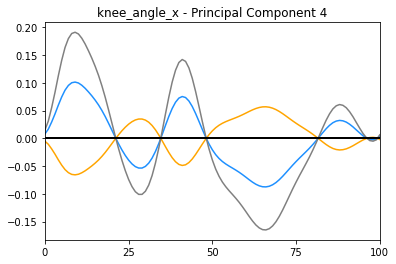

----------------------
Average Healthy Score: -0.008958038536508174
Average Injured Score: -0.06471452748092173
Average Recovered Score: 0.04604928400359495


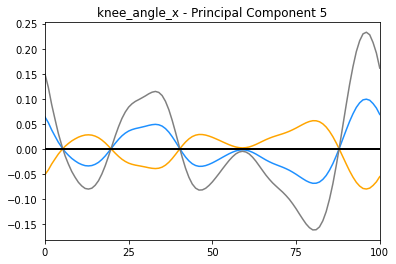

----------------------
Average Healthy Score: 0.11047955481851629
Average Injured Score: -0.0583118255047173
Average Recovered Score: -0.003950612687144962


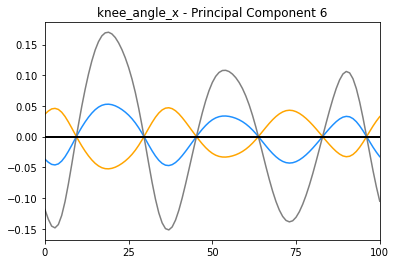

----------------------
Average Healthy Score: 0.14113822124064707
Average Injured Score: -0.3732561023030211
Average Recovered Score: -0.11335916636840593


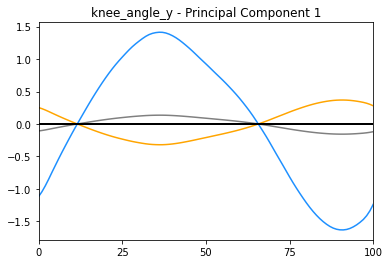

----------------------
Average Healthy Score: -1.0596990450910617
Average Injured Score: 1.6648248529318042
Average Recovered Score: -1.3792945047559773


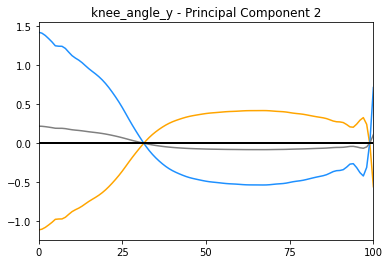

----------------------
Average Healthy Score: 0.17442223165788134
Average Injured Score: 0.12047509512082974
Average Recovered Score: -0.7278364256784581


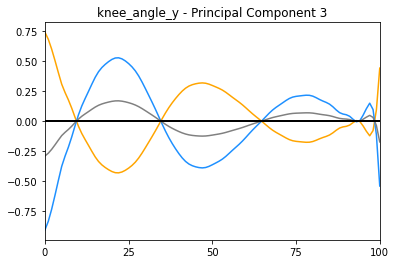

----------------------
Average Healthy Score: -0.1492669381188873
Average Injured Score: -0.14869130782908865
Average Recovered Score: 0.8467553131742293


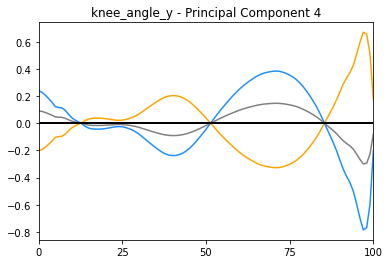

----------------------
Average Healthy Score: -0.16165118347907323
Average Injured Score: 0.1338754315869807
Average Recovered Score: 0.6769938032672732


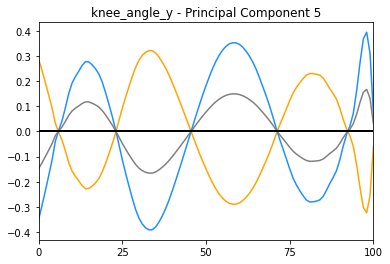

----------------------
Average Healthy Score: 0.3828250695155665
Average Injured Score: 0.2133907670456225
Average Recovered Score: -0.528746120516895


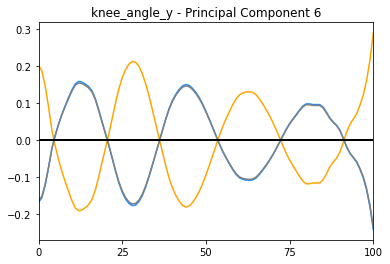

----------------------
Average Healthy Score: -1.4842471337398806
Average Injured Score: 1.3251387097799063
Average Recovered Score: -1.4517030688608548


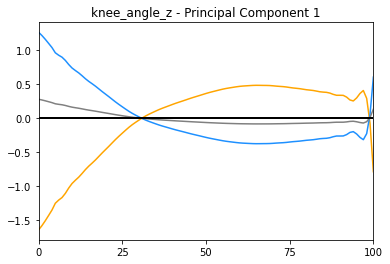

----------------------
Average Healthy Score: -0.0551731362508067
Average Injured Score: 0.47159452919225225
Average Recovered Score: -0.4556460704799176


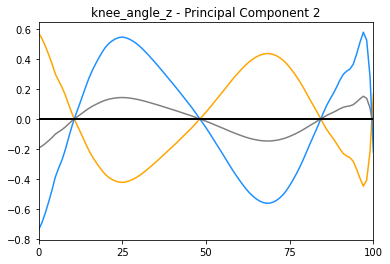

----------------------
Average Healthy Score: -0.1299899355065492
Average Injured Score: 0.272366993223883
Average Recovered Score: -0.5876708623757759


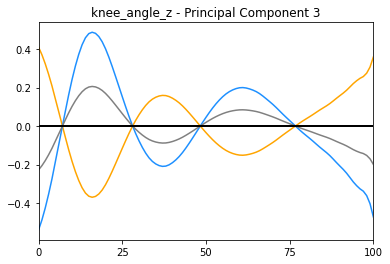

----------------------
Average Healthy Score: 0.18136989178670673
Average Injured Score: -0.5860713532516735
Average Recovered Score: -0.18864640591944867


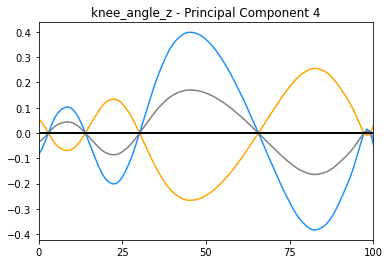

----------------------
Average Healthy Score: 0.026350626135158445
Average Injured Score: 0.5581495365600448
Average Recovered Score: -0.2884903779688077


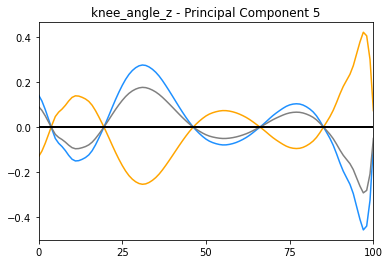

----------------------
Average Healthy Score: 0.009423462990069202
Average Injured Score: 0.25858087275920943
Average Recovered Score: -0.06021338787748665


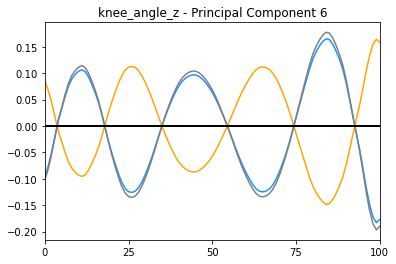

----------------------
Average Healthy Score: 0.2667359425842867
Average Injured Score: -0.17375847112175308
Average Recovered Score: 0.6876724385944232


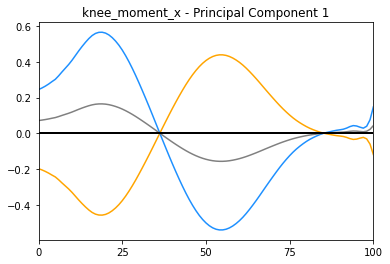

----------------------
Average Healthy Score: -0.18428465229698668
Average Injured Score: 0.033010227458258365
Average Recovered Score: -0.04297862917901513


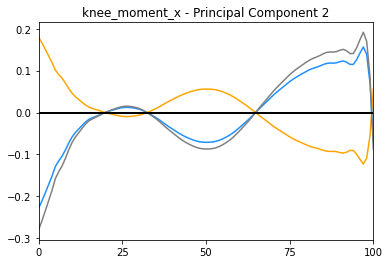

----------------------
Average Healthy Score: 0.045930175191136825
Average Injured Score: -0.2805423291223351
Average Recovered Score: -0.07998260146934176


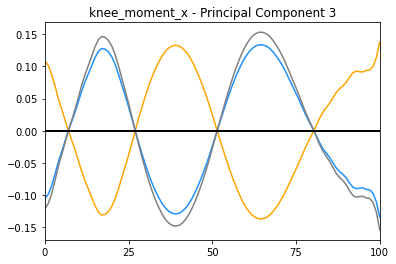

----------------------
Average Healthy Score: 0.05006721812607725
Average Injured Score: -0.03290990294472133
Average Recovered Score: -0.013791803335061878


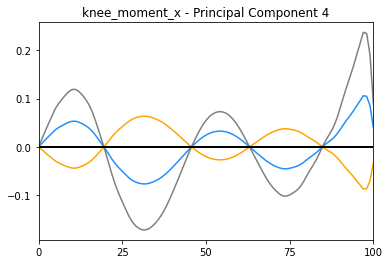

----------------------
Average Healthy Score: -0.0277035250426253
Average Injured Score: -0.0557246936884066
Average Recovered Score: 0.007687890520046932


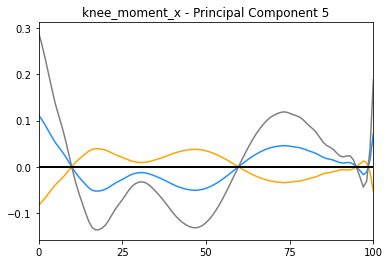

----------------------
Average Healthy Score: -0.09063090034229884
Average Injured Score: -0.020097023197280895
Average Recovered Score: 0.09953641863279016


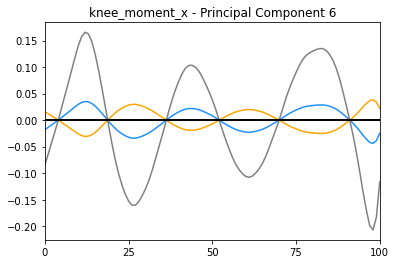

----------------------
Average Healthy Score: -0.297871640206201
Average Injured Score: -1.8131539625470998
Average Recovered Score: 1.577651214147906


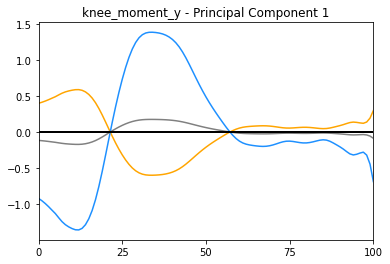

----------------------
Average Healthy Score: -0.5872132881640278
Average Injured Score: -0.009886798852549958
Average Recovered Score: -0.1720854883598227


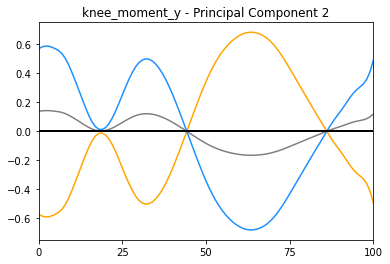

----------------------
Average Healthy Score: -0.19749137414702833
Average Injured Score: 0.3223840056964703
Average Recovered Score: -0.36098965257489984


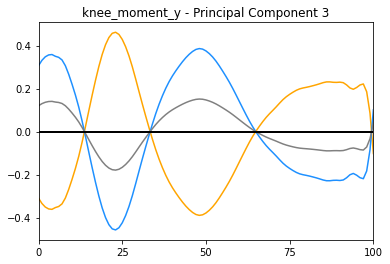

----------------------
Average Healthy Score: 0.5675970537106777
Average Injured Score: -0.1369786318670292
Average Recovered Score: -0.042201545859519206


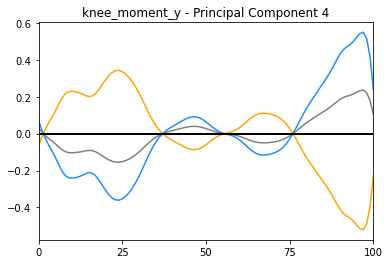

----------------------
Average Healthy Score: 0.04500544034861717
Average Injured Score: 0.3277030988946953
Average Recovered Score: -0.19085132078420966


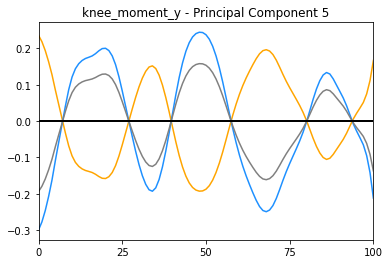

----------------------
Average Healthy Score: 0.20730855099046838
Average Injured Score: -0.055505442407135584
Average Recovered Score: 0.09250196728873135


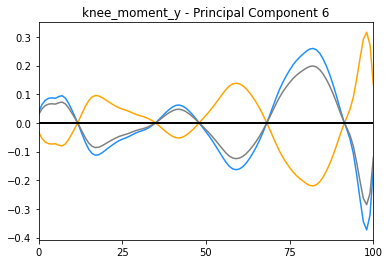

----------------------
Average Healthy Score: -0.6265985700441127
Average Injured Score: 0.7591721709772942
Average Recovered Score: -0.5828475262067166


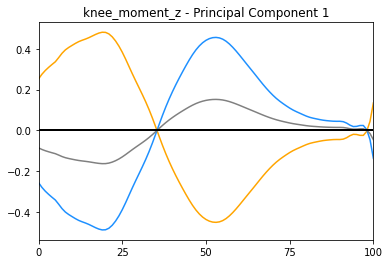

----------------------
Average Healthy Score: 0.0907122189938948
Average Injured Score: -0.3697099710866845
Average Recovered Score: 0.01712122783400749


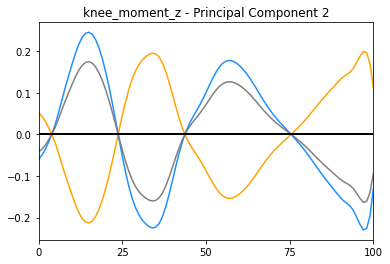

----------------------
Average Healthy Score: -0.032083333692987694
Average Injured Score: -0.04155719284238363
Average Recovered Score: 0.13683371298463068


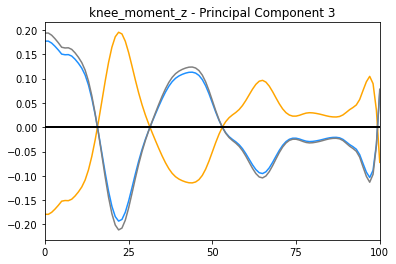

----------------------
Average Healthy Score: -0.1513579831096905
Average Injured Score: 0.028291804099928895
Average Recovered Score: 0.09557963426164673


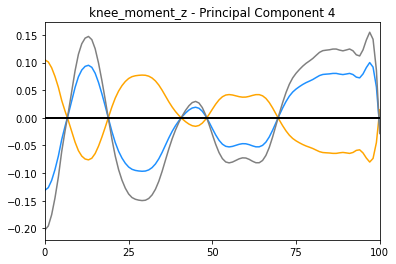

----------------------
Average Healthy Score: 0.012567905697148543
Average Injured Score: -0.13448265395735187
Average Recovered Score: 0.02684137682133823


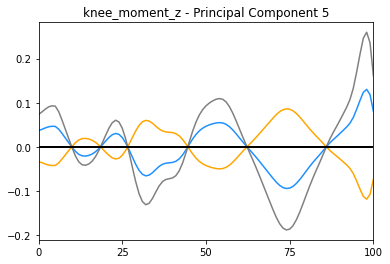

----------------------
Average Healthy Score: -0.06610628399883062
Average Injured Score: 0.036373921355342266
Average Recovered Score: -0.058146379549297224


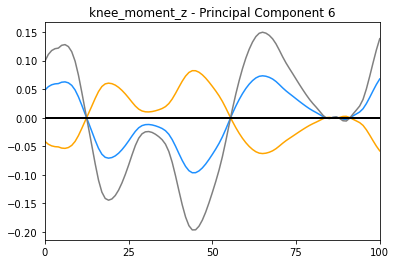

<Figure size 432x288 with 0 Axes>

In [5]:
#choose full gait cycle (GC) or stance phase (stance)
x_axis = 'stance'

#create an array to store eigenvectors, 5th percentile*eigenvector, and 95th percentile*eigenvector
final_kin_pc_eigenvectors_M1 = np.zeros((101,325))
final_kin_pc_eigenvectors_M1[:,0] = list(range(0,101))
column_names = ['x']

#directory for loadings
kin_loadings = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/loadings')))
#kin_loadings.remove('.DS_Store')
#directory for PC scores
kin_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores')))
#kin_pc_scores.remove('.DS_Store')

#initialize a counter
counter = 3

for file_idx, file_name in enumerate(kin_pc_scores):
    #get the current PC_scores_file
    score_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores',file_name)
    scores_matrix = pd.read_csv(score_path,sep=',')
    #load the loadings matrix 
    loadings_mat_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/loadings',file_name)
    loadings_matrix = pd.read_csv(loadings_mat_path,sep=',')
    
    #set range to 6 (i'd guess that everything after 5th PC is noise)
    for PC_num in range(6):
        #extract the row of the loadings matrix for the current PC
        loading = loadings_matrix.iloc[PC_num,0:]
        #calculate 5th and 95th percentile scores of the PC and group averages
        PC_scores = scores_matrix[str(PC_num)]
        #5th and 95th percentile
        fifth_percentile = np.percentile(PC_scores, 5)
        nintyfifth_percentile = np.percentile(PC_scores, 95)
        #mean scores
        healthy_scores = scores_matrix.loc[scores_matrix['label'].isin([1])]
        mean_healthy_score = np.average(healthy_scores[str(PC_num)])
        injured_scores = scores_matrix.loc[scores_matrix['label'].isin([3])]
        mean_injured_score = np.average(injured_scores[str(PC_num)])
        recovered_scores = scores_matrix.loc[scores_matrix['label'].isin([5])]
        mean_recovered_score = np.average(recovered_scores[str(PC_num)])
        
        #add eigenvector and eigenvector*percentiles to matrix
        final_kin_pc_eigenvectors_M1[:,counter-2] = pd.Series.to_numpy(loading)
        final_kin_pc_eigenvectors_M1[:,counter-1] = pd.Series.to_numpy(loading*fifth_percentile)
        final_kin_pc_eigenvectors_M1[:,counter] = pd.Series.to_numpy(loading*nintyfifth_percentile)
        #append labels for loadings matrix
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1))
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_5')
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_95')
        
        counter = counter + 3
        
        #Plot the loading vector multiplied by the 5th and 95th percentile of PC_score
        #plt.figure(PC_num)
        print("----------------------")
        print('Average Healthy Score:', mean_healthy_score)
        print('Average Injured Score:', mean_injured_score)
        print('Average Recovered Score:', mean_recovered_score)
        #print('5th Percentile Score:', fifth_percentile)
        #print('95th Percentile Score:', nintyfifth_percentile)
        plt.ion()
        #plt.plot(loading*mean_healthy_score, color = "green")
        #plt.plot(loading*mean_injured_score, color = "red")
        plt.plot(loading*fifth_percentile, color = "orange")
        plt.plot(loading*nintyfifth_percentile, color = "dodgerblue")
        plt.plot(loading, color='gray')
        plt.plot([0, 100], [0, 0], color='k', linewidth=2)
        plt.xlim(0,100)
        plt.title(file_name[0:-4]+' - Principal Component '+ str(PC_num+1))
        plt.xticks([0, 25, 50, 75, 100])
        plt.show()
        #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
        plt.clf()

#convert eigenvectors matrix to dataframe. will merge with EMG data frame later 
final_kin_pc_eigenvectors_M1_df = pd.DataFrame(final_kin_pc_eigenvectors_M1, columns=column_names)


----------------------
Average Healthy Score: 1.8192114080646866
Average Injured Score: -2.007548510464432


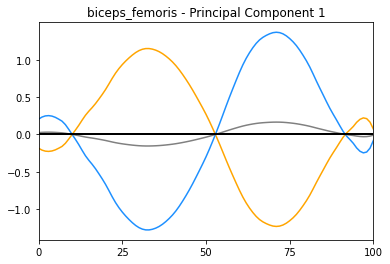

----------------------
Average Healthy Score: -0.4614174028608693
Average Injured Score: 0.6514081330025349


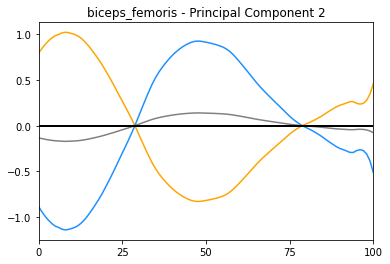

----------------------
Average Healthy Score: 0.011491548576929208
Average Injured Score: 0.31300613740562505


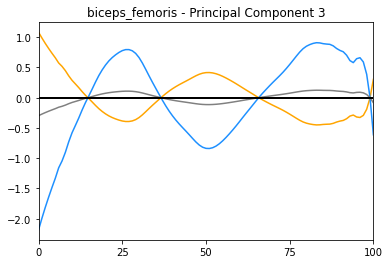

----------------------
Average Healthy Score: -0.8316936196724527
Average Injured Score: 0.6861760416138282


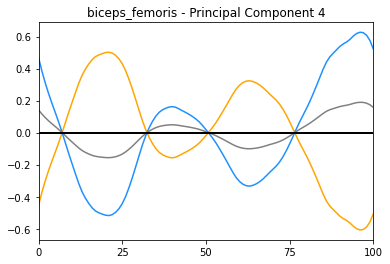

----------------------
Average Healthy Score: 0.08650287506473794
Average Injured Score: 0.2098207185012953


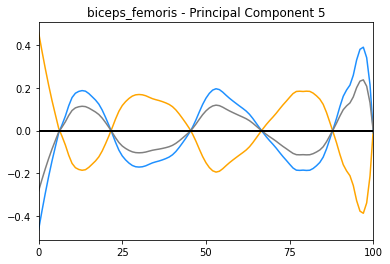

----------------------
Average Healthy Score: -0.23600321851028555
Average Injured Score: -0.00800475379825466


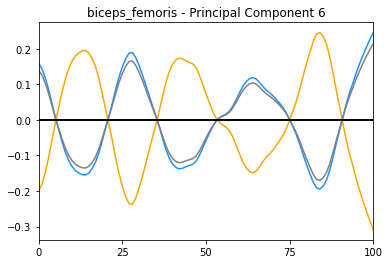

----------------------
Average Healthy Score: 1.093411501587619
Average Injured Score: -1.1390578852801758


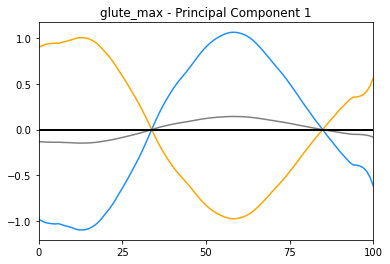

----------------------
Average Healthy Score: 1.5775473805535696
Average Injured Score: -1.8959283388749681


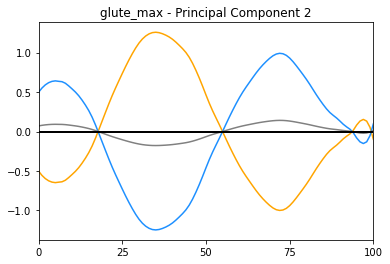

----------------------
Average Healthy Score: 0.22199315204933748
Average Injured Score: 0.6736755614620231


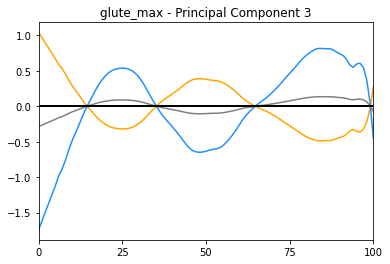

----------------------
Average Healthy Score: -0.8636251324605124
Average Injured Score: 0.742177055985565


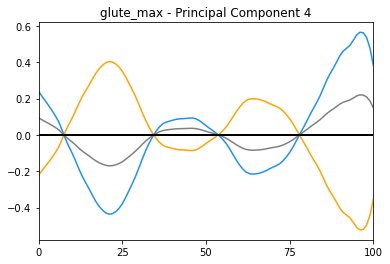

----------------------
Average Healthy Score: -0.05004153604631681
Average Injured Score: 0.016311374919770305


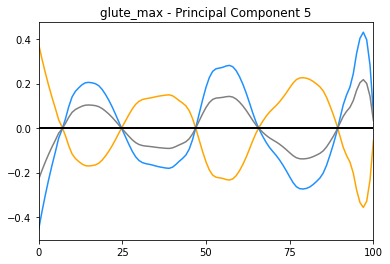

----------------------
Average Healthy Score: -0.2122485525530321
Average Injured Score: 0.21116734080235108


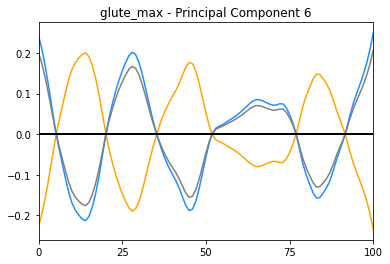

----------------------
Average Healthy Score: 1.7283265726023118
Average Injured Score: -0.7170851912760678


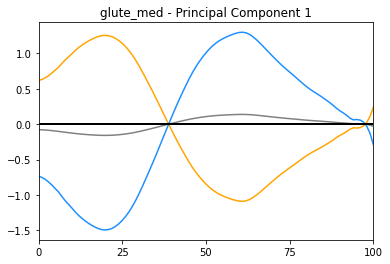

----------------------
Average Healthy Score: -0.6367919620500189
Average Injured Score: 1.1333071549991534


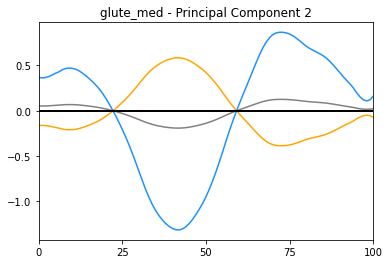

----------------------
Average Healthy Score: -0.6572618618171708
Average Injured Score: -0.0437486415155125


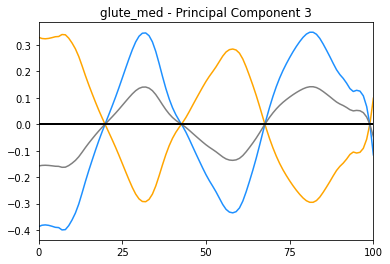

----------------------
Average Healthy Score: 0.38600956114158264
Average Injured Score: -0.10243544224667822


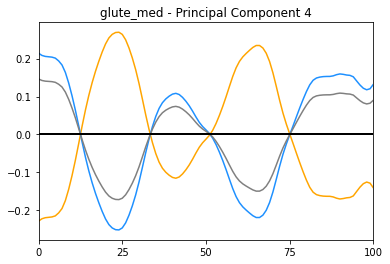

----------------------
Average Healthy Score: -0.0017625760295994681
Average Injured Score: -0.0003881484732671307


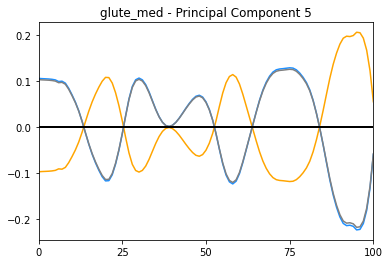

----------------------
Average Healthy Score: 0.1012924811599127
Average Injured Score: 0.01455794364824964


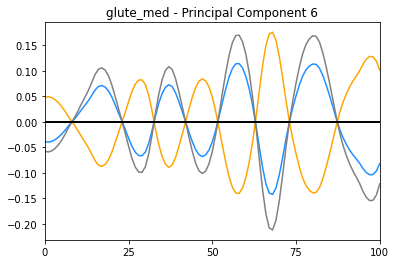

----------------------
Average Healthy Score: 2.0860638857807623
Average Injured Score: -0.906423831866413


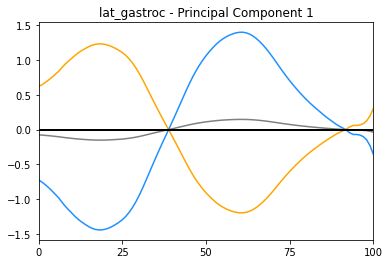

----------------------
Average Healthy Score: -1.1860346524344705
Average Injured Score: 1.1877081910101321


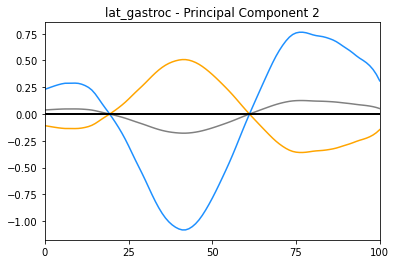

----------------------
Average Healthy Score: -0.1827926676235253
Average Injured Score: 0.6619000942438701


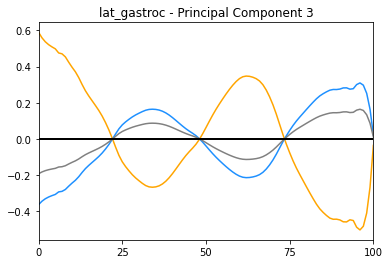

----------------------
Average Healthy Score: -0.5503646358957185
Average Injured Score: 0.2551007269946289


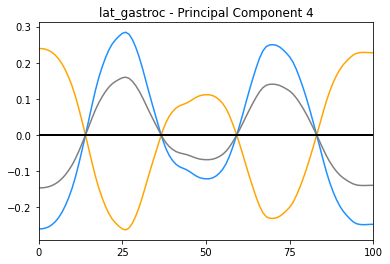

----------------------
Average Healthy Score: -0.11670133054568366
Average Injured Score: -0.05219724642230293


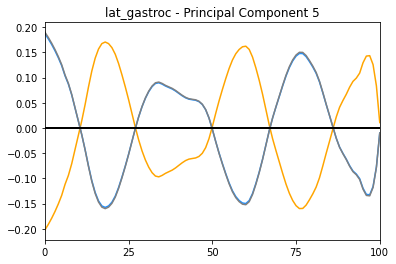

----------------------
Average Healthy Score: -0.03406966293167457
Average Injured Score: 0.04070506071356544


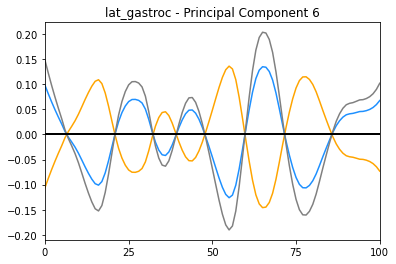

----------------------
Average Healthy Score: 2.092225384254737
Average Injured Score: -0.8487237815335268


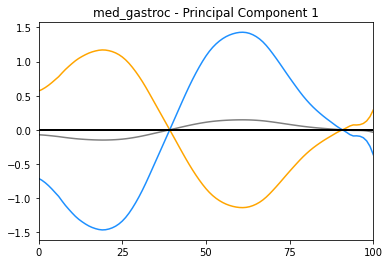

----------------------
Average Healthy Score: -1.3608604532089053
Average Injured Score: 1.1639675310536137


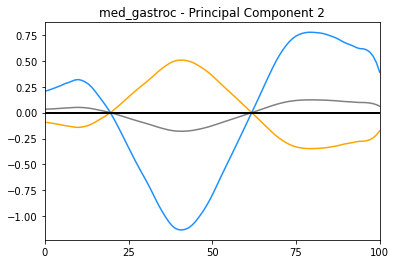

----------------------
Average Healthy Score: -0.07089531206140946
Average Injured Score: 0.40929750464032233


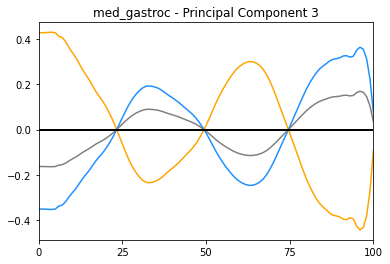

----------------------
Average Healthy Score: -0.5268023918321242
Average Injured Score: 0.2939684211649789


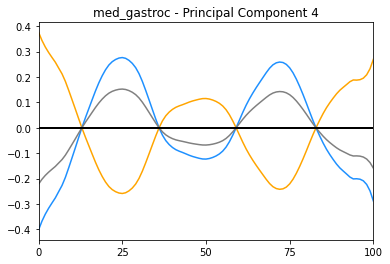

----------------------
Average Healthy Score: 0.18310941199619607
Average Injured Score: 0.056275703990059746


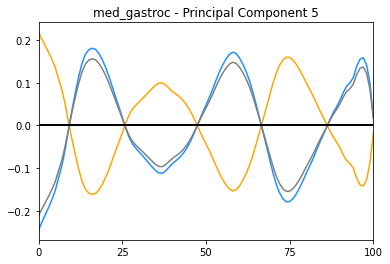

----------------------
Average Healthy Score: -0.07403961194215639
Average Injured Score: 0.1318672803082934


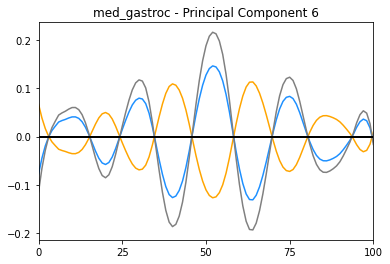

----------------------
Average Healthy Score: 0.8548163900695187
Average Injured Score: 0.2999903705368833


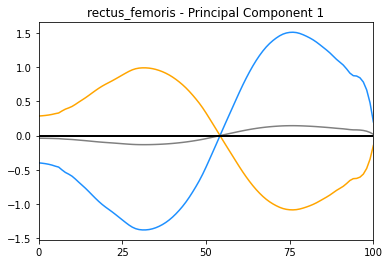

----------------------
Average Healthy Score: -1.4401730486477367
Average Injured Score: 1.294203290746337


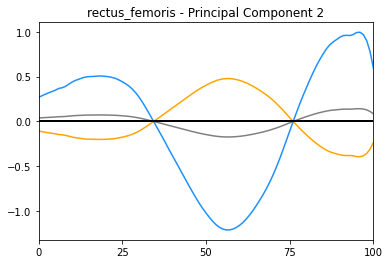

----------------------
Average Healthy Score: 0.08494227981256172
Average Injured Score: 0.04186376333103221


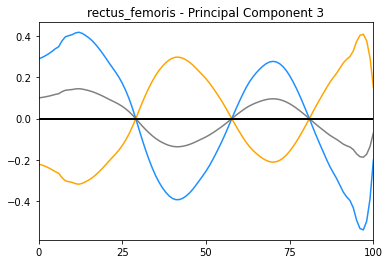

----------------------
Average Healthy Score: -0.2703445245376368
Average Injured Score: 0.02125369804750978


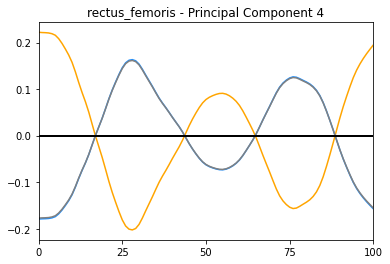

----------------------
Average Healthy Score: 0.025578169850689714
Average Injured Score: -0.25899621517432064


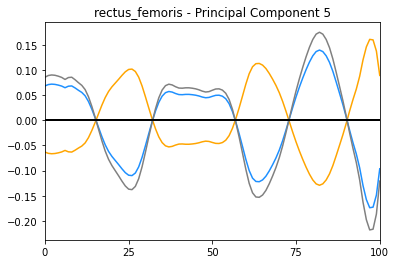

----------------------
Average Healthy Score: -0.07396102065246382
Average Injured Score: 0.09897006879839708


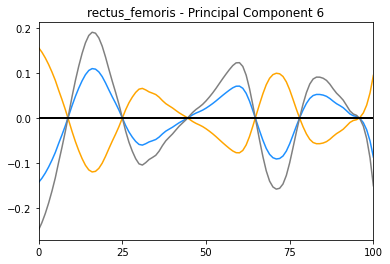

----------------------
Average Healthy Score: 1.9019395254739997
Average Injured Score: -0.37499571196577136


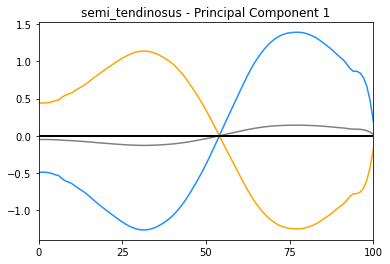

----------------------
Average Healthy Score: -1.2611732378703497
Average Injured Score: 0.8158502135476055


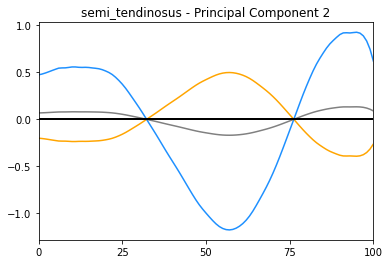

----------------------
Average Healthy Score: 0.6211325903715866
Average Injured Score: -0.9808202932482434


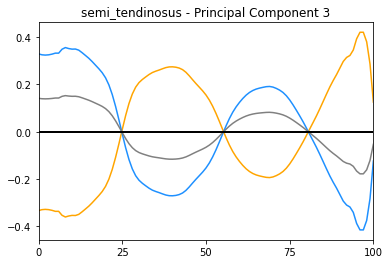

----------------------
Average Healthy Score: 0.018907034551374585
Average Injured Score: -0.16778241517630058


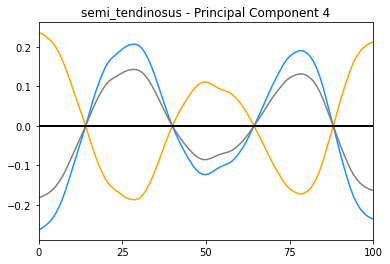

----------------------
Average Healthy Score: 0.025391976091632757
Average Injured Score: -0.17838390023320308


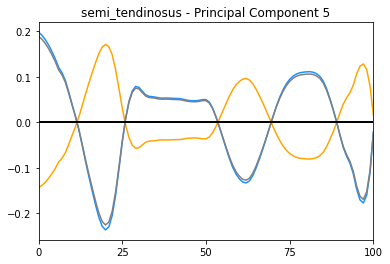

----------------------
Average Healthy Score: 0.07251342278786832
Average Injured Score: 0.06873141024287208


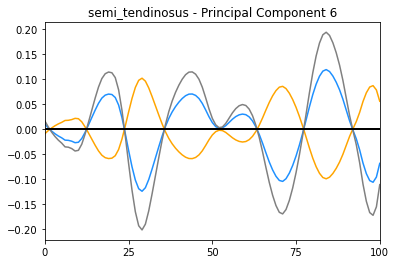

----------------------
Average Healthy Score: 1.4825202667261976
Average Injured Score: -0.09248495548438974


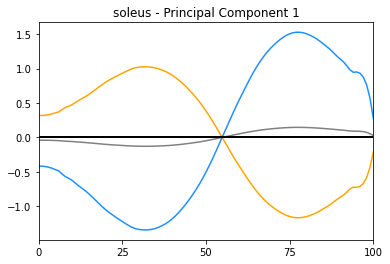

----------------------
Average Healthy Score: -1.5127484354172058
Average Injured Score: 1.1162366072938419


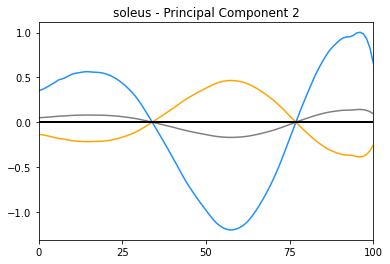

----------------------
Average Healthy Score: 0.3535960079759608
Average Injured Score: -0.4689012536048701


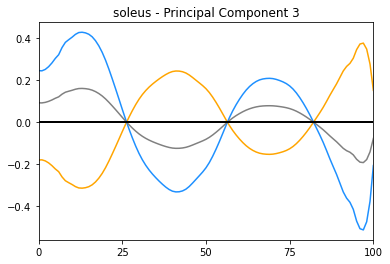

----------------------
Average Healthy Score: -0.3289008323918319
Average Injured Score: 0.10675997962025745


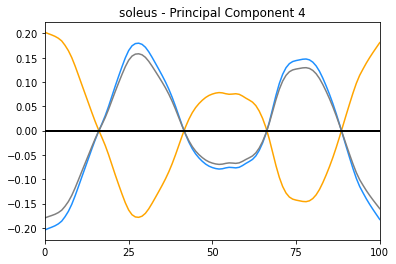

----------------------
Average Healthy Score: -0.01906646480266413
Average Injured Score: -0.23421242971146422


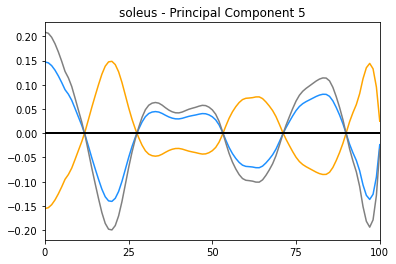

----------------------
Average Healthy Score: 0.021259186542085813
Average Injured Score: -0.029487092095173733


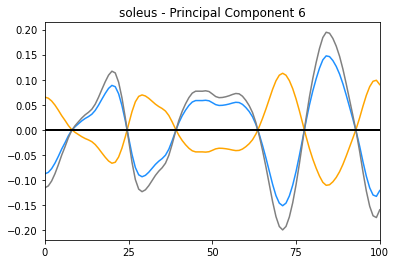

----------------------
Average Healthy Score: 2.4109863828358327
Average Injured Score: -0.6053444837220956


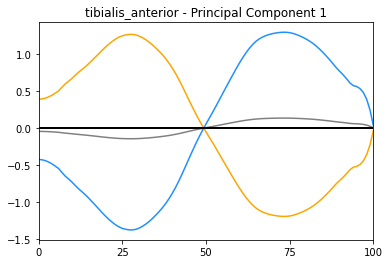

----------------------
Average Healthy Score: -1.3477678910692503
Average Injured Score: 1.0477602946267983


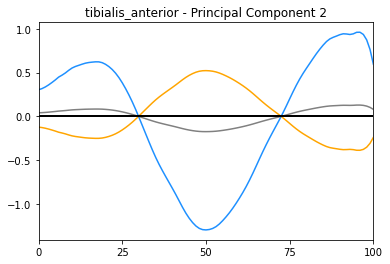

----------------------
Average Healthy Score: -0.4218073285268813
Average Injured Score: 0.32946689356067943


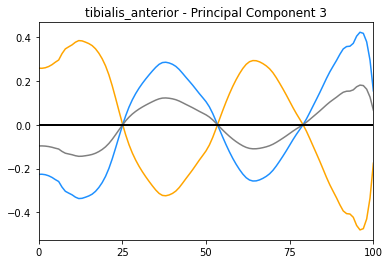

----------------------
Average Healthy Score: -0.10519555087304351
Average Injured Score: 0.24188423863391645


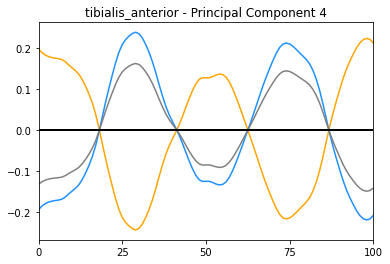

----------------------
Average Healthy Score: -0.08876490072293548
Average Injured Score: -0.05223042599347681


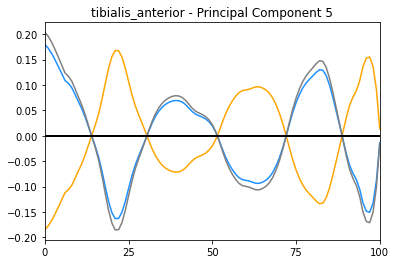

----------------------
Average Healthy Score: -0.07961513396791116
Average Injured Score: 0.05719682163339858


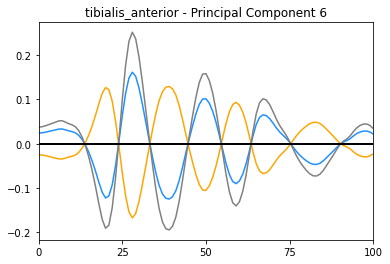

----------------------
Average Healthy Score: 1.3716385764462258
Average Injured Score: -0.34342432277481666


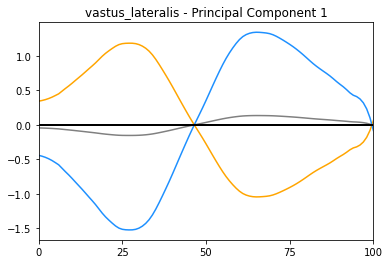

----------------------
Average Healthy Score: -1.3647851355435512
Average Injured Score: 0.4965020699533658


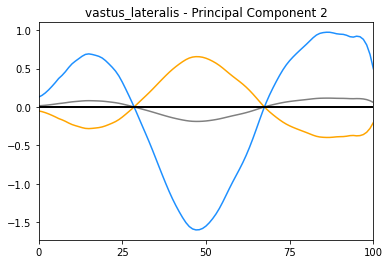

----------------------
Average Healthy Score: -0.3723775163279316
Average Injured Score: 0.4769208133102391


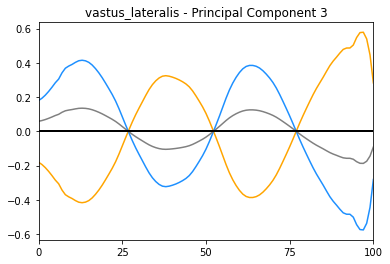

----------------------
Average Healthy Score: -0.047789917350564246
Average Injured Score: 0.06553094916967925


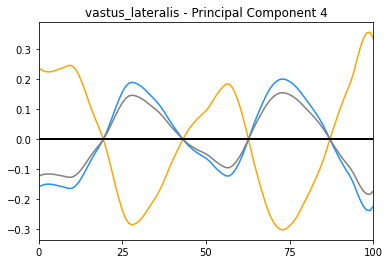

----------------------
Average Healthy Score: 0.17761605089181795
Average Injured Score: 0.06738494191809523


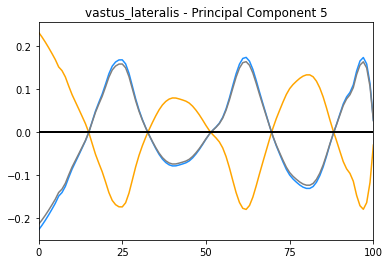

----------------------
Average Healthy Score: 0.03880913270622524
Average Injured Score: -0.0014859753407186263


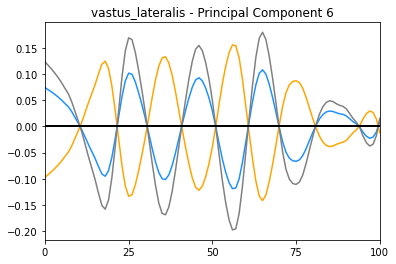

----------------------
Average Healthy Score: 1.478928558603999
Average Injured Score: 0.058658481288615186


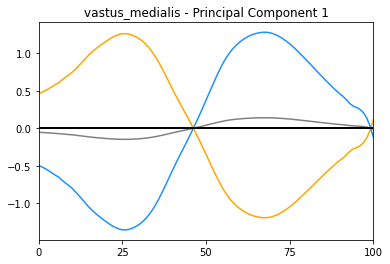

----------------------
Average Healthy Score: 0.1821429638836928
Average Injured Score: 0.08107491763237828


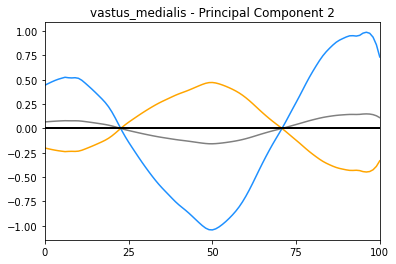

----------------------
Average Healthy Score: -0.057253505228884
Average Injured Score: -0.0034594996051734994


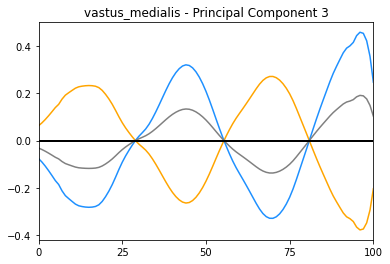

----------------------
Average Healthy Score: 0.14584337047462584
Average Injured Score: -0.14464103400932218


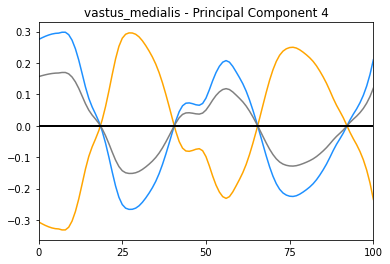

----------------------
Average Healthy Score: -0.1312869217244244
Average Injured Score: 0.02727330660590845


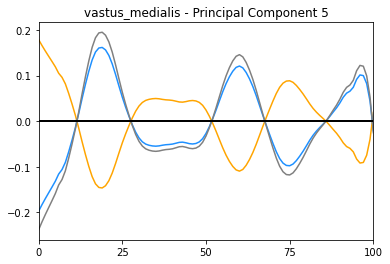

----------------------
Average Healthy Score: -0.20743834019493254
Average Injured Score: 0.009920013022654892


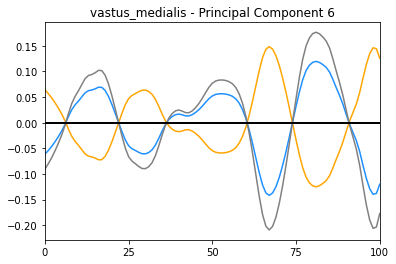

<Figure size 432x288 with 0 Axes>

In [94]:
#choose full gait cycle (GC) or stance phase (stance)
x_axis = 'stance'

#create an array to store eigenvectors, 5th percentile*eigenvector, and 95th percentile*eigenvector
final_emg_pc_eigenvectors_M1 = np.zeros((101,199))
final_emg_pc_eigenvectors_M1[:,0] = list(range(0,101))
column_names = ['x']

#directory for loadings
emg_loadings = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/loadings')))
#directory for scores
emg_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores')))
#emg_pc_scores.remove('.DS_Store')

#initialize a counter
counter = 3

for file_idx, file_name in enumerate(emg_pc_scores):
    #get the current PC_scores_file
    score_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores',file_name)
    scores_matrix = pd.read_csv(score_path,sep=',')
    #load the loadings matrix 
    loadings_mat_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/loadings',file_name)
    loadings_matrix = pd.read_csv(loadings_mat_path,sep=',')
    
    #set range to 6 (i'd guess that everything after 5th PC is noise)
    for PC_num in range(6):
        #extract the row of the loadings matrix for the current PC
        loading = loadings_matrix.iloc[PC_num,0:]
        #calculate 5th and 95th percentile scores of the PC and group averages
        PC_scores = scores_matrix[str(PC_num)]
        #5th and 95th percentile
        fifth_percentile = np.percentile(PC_scores, 5)
        nintyfifth_percentile = np.percentile(PC_scores, 95)
        #mean scores
        healthy_scores = scores_matrix.loc[scores_matrix['label'].isin([1])]
        mean_healthy_score = np.average(healthy_scores[str(PC_num)])
        injured_scores = scores_matrix.loc[scores_matrix['label'].isin([3])]
        mean_injured_score = np.average(injured_scores[str(PC_num)])
        
        #add eigenvector and eigenvector*percentiles to matrix
        final_emg_pc_eigenvectors_M1[:,counter-2] = pd.Series.to_numpy(loading)
        final_emg_pc_eigenvectors_M1[:,counter-1] = pd.Series.to_numpy(loading*fifth_percentile)
        final_emg_pc_eigenvectors_M1[:,counter] = pd.Series.to_numpy(loading*nintyfifth_percentile)
        #append labels for loadings matrix
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1))
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_5')
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_95')
        
        counter = counter + 3
        
        #Plot the loading vector multiplied by the 5th and 95th percentile of PC_score
        #plt.figure(PC_num)
        print("----------------------")
        print('Average Healthy Score:', mean_healthy_score)
        print('Average Injured Score:', mean_injured_score)
        #print('5th Percentile Score:', fifth_percentile)
        #print('95th Percentile Score:', nintyfifth_percentile)
        plt.ion()
        #plt.plot(loading*mean_healthy_score, color = "green")
        #plt.plot(loading*mean_injured_score, color = "red")
        plt.plot(loading*fifth_percentile, color = "orange")
        plt.plot(loading*nintyfifth_percentile, color = "dodgerblue")
        plt.plot(loading, color='gray')
        plt.plot([0, 100], [0, 0], color='k', linewidth=2)
        plt.xlim(0,100)
        plt.title(file_name[0:-4]+' - Principal Component '+ str(PC_num+1))
        plt.xticks([0,25,50,75,100])
        plt.show()
        #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
        plt.clf()
        
#convert eigenvectors matrix to dataframe. will merge with EMG data frame later 
final_emg_pc_eigenvectors_M1_df = pd.DataFrame(final_emg_pc_eigenvectors_M1, columns=column_names)


Merge the kinetic/kinematic eigenvectors with the EMG eigenvectors and export data

In [92]:
final_pc_eigenvectors_M1 = pd.concat([final_kin_pc_eigenvectors_M1_df, final_emg_pc_eigenvectors_M1_df], axis=1)
final_pc_eigenvectors_M1.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/eigenvectors/final_eigenvectors_M1.csv')

Plot average waveforms of both groups on same plot. Save matrices of enseble averages.

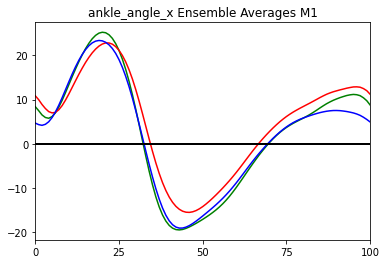

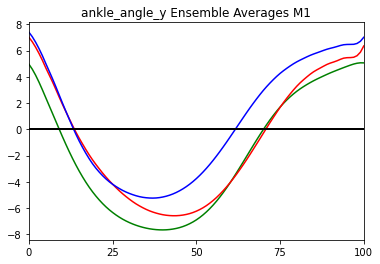

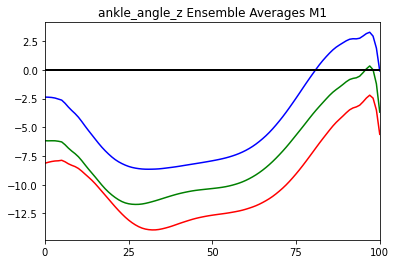

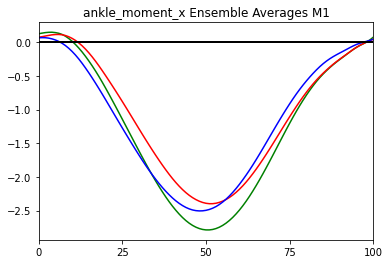

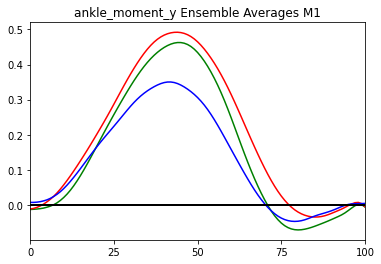

...

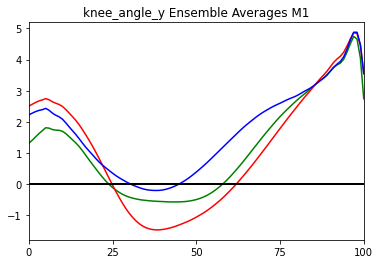

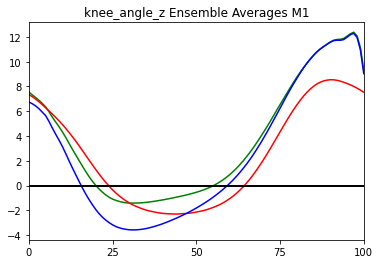

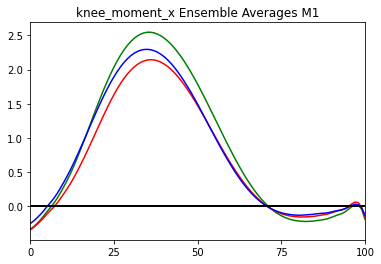

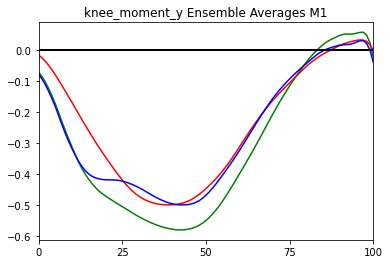

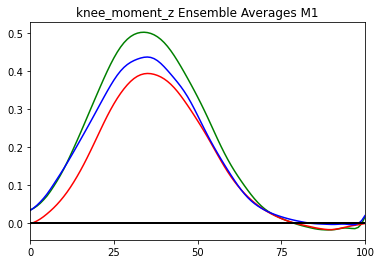

<Figure size 432x288 with 0 Axes>

In [55]:
kin_ensemble_waveforms_M1_healthy = np.zeros((101,19))
kin_ensemble_waveforms_M1_injured = np.zeros((101,19))
kin_ensemble_waveforms_M1_recovered = np.zeros((101,19))
kin_ensemble_waveforms_M1_healthy[:,0] = list(range(0,101))
kin_ensemble_waveforms_M1_injured[:,0] = list(range(0,101))
kin_ensemble_waveforms_M1_recovered[:,0] = list(range(0,101))
column_names = ['x']

#directory for variable waveforms
kin_waveforms = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped')))
kin_waveforms.remove('.DS_Store')

for file_idx, file_name in enumerate(kin_pc_scores):
    #get the current PC_scores_file
    waveform_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped/',file_name)
    waveform_matrix = pd.read_csv(waveform_path,sep=',')
    
    #calculate ensemble average waveforms for each group at M1
    healthy_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([1])].mean(axis=0).drop('label')
    injured_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([3])].mean(axis=0).drop('label')
    recovered_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([5])].mean(axis=0).drop('label')
    
    #add ensemble average to array
    kin_ensemble_waveforms_M1_healthy[:,file_idx+1] = pd.Series.to_numpy(healthy_ensemble)
    kin_ensemble_waveforms_M1_injured[:,file_idx+1] = pd.Series.to_numpy(injured_ensemble)
    kin_ensemble_waveforms_M1_recovered[:,file_idx+1] = pd.Series.to_numpy(recovered_ensemble)
    #create a list of column names 
    column_names.append(file_name[0:-4])

    #Plot ensembles
    plt.ion()
    plt.plot(healthy_ensemble, color = "green")
    plt.plot(injured_ensemble, color = "red")
    plt.plot(recovered_ensemble, color="blue")
    plt.plot([0, 100], [0, 0], color='k', linewidth=2)
    plt.xlim(0,100)
    plt.title(file_name[0:-4]+' Ensemble Averages M1')
    plt.xticks([0, 25, 50, 75, 100])
    plt.show()
    #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
    plt.clf()

#convert ensemble aveage matrices to pandas data frames
healthy_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M1_healthy, columns=column_names)
injured_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M1_injured, columns=column_names)
recovered_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M1_recovered, columns=column_names)
#save data frames
healthy_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_healthy_M1.csv')
injured_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_injured_M1.csv')
recovered_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_recovered_M1.csv')

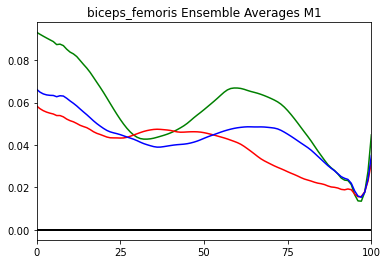

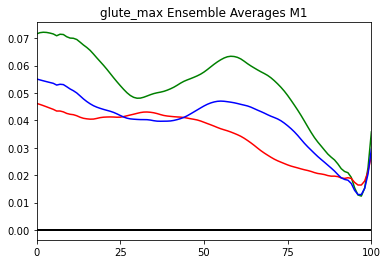

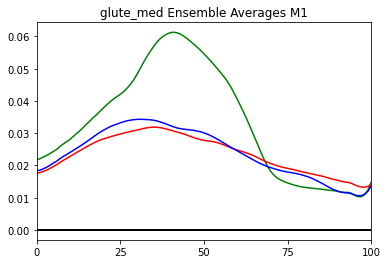

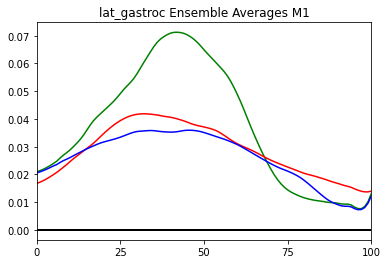

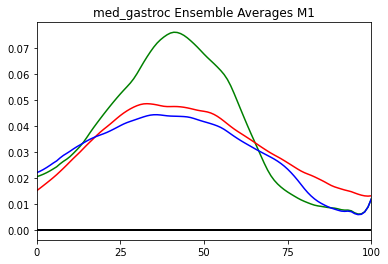

...

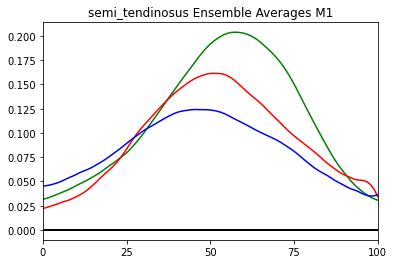

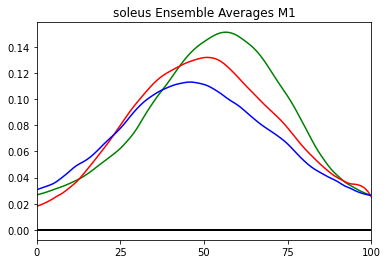

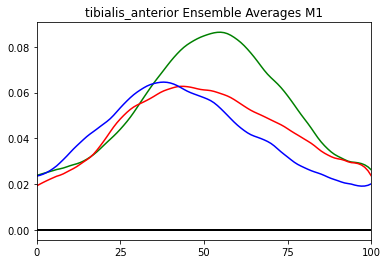

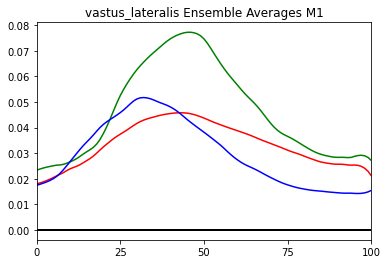

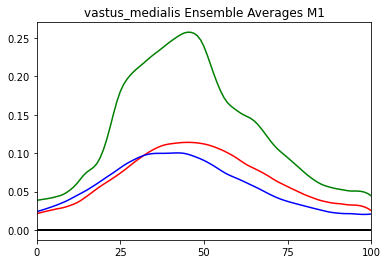

<Figure size 432x288 with 0 Axes>

In [58]:
EMG_ensemble_waveforms_M1_healthy = np.zeros((101,12))
EMG_ensemble_waveforms_M1_injured = np.zeros((101,12))
EMG_ensemble_waveforms_M1_recovered = np.zeros((101,12))
EMG_ensemble_waveforms_M1_healthy[:,0] = list(range(0,101))
EMG_ensemble_waveforms_M1_injured[:,0] = list(range(0,101))
EMG_ensemble_waveforms_M1_recovered[:,0] = list(range(0,101))
column_names = ['x']

#directory for variable waveforms
emg_waveforms = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped')))
#emg_waveforms.remove('.DS_Store')

for file_idx, file_name in enumerate(emg_pc_scores):
    #get the current PC_scores_file
    waveform_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped/',file_name)
    waveform_matrix = pd.read_csv(waveform_path,sep=',')
    
    #calculate ensemble average waveforms for each group at M1
    healthy_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([1])].mean(axis=0).drop('label')
    injured_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([3])].mean(axis=0).drop('label')
    recovered_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([5])].mean(axis=0).drop('label')
    
    #add ensemble average to array
    EMG_ensemble_waveforms_M1_healthy[:,file_idx+1] = pd.Series.to_numpy(healthy_ensemble)
    EMG_ensemble_waveforms_M1_injured[:,file_idx+1] = pd.Series.to_numpy(injured_ensemble)
    EMG_ensemble_waveforms_M1_recovered[:,file_idx+1] = pd.Series.to_numpy(recovered_ensemble)
    #create a list of column names 
    column_names.append(file_name[0:-4])
        
    #Plot ensembles
    plt.ion()
    plt.plot(healthy_ensemble, color = "green")
    plt.plot(injured_ensemble, color = "red")
    plt.plot(recovered_ensemble, color="blue")
    plt.plot([0, 100], [0, 0], color='k', linewidth=2)
    plt.xlim(0,100)
    plt.title(file_name[0:-4]+' Ensemble Averages M1')
    plt.xticks([0, 25, 50, 75, 100])
    plt.show()
    #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
    plt.clf()
    
#convert ensemble aveage matrices to pandas data frames
healthy_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M1_healthy, columns=column_names)
injured_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M1_injured, columns=column_names)
recovered_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M1_recovered, columns=column_names)
#save data frames
healthy_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_healthy_M1.csv')
injured_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_injured_M1.csv')
recovered_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_recovered_M1.csv')

# Part 9: Plot Principal Components and ensemble average waveforms at M21

Currently have it set to multiply the mean score for the healthy and injured groups by the loading instead of using 5th and 95th percentile scores. 
    

----------------------
Average Healthy Score: 0.39944977400375387
Average Injured Score: -1.0998135982156354
Average Recovered Score: 0.306356742980168


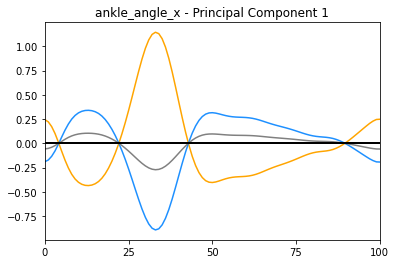

----------------------
Average Healthy Score: 0.624669214132296
Average Injured Score: -0.3584643060442008
Average Recovered Score: 0.9247574262942743


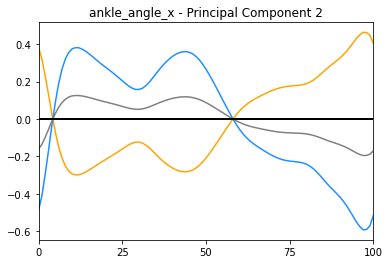

----------------------
Average Healthy Score: -0.7457758343285457
Average Injured Score: 0.02269187628142209
Average Recovered Score: 0.3805918958737953


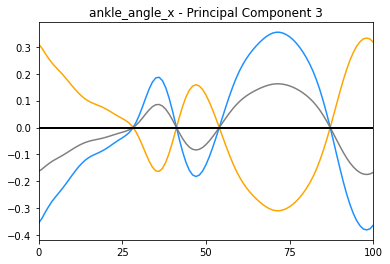

----------------------
Average Healthy Score: -0.059630510809428654
Average Injured Score: -0.105067994141767
Average Recovered Score: 0.1306772280021341


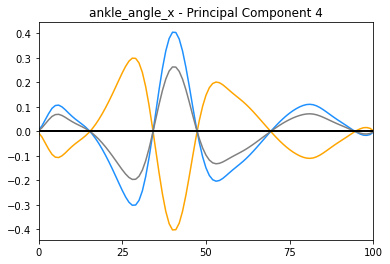

----------------------
Average Healthy Score: -0.07625323178549832
Average Injured Score: 0.19507649680670472
Average Recovered Score: 0.10518349257365318


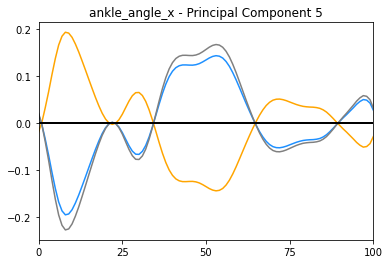

----------------------
Average Healthy Score: 0.058097226930518574
Average Injured Score: -0.02033989635957283
Average Recovered Score: -0.31203387650577413


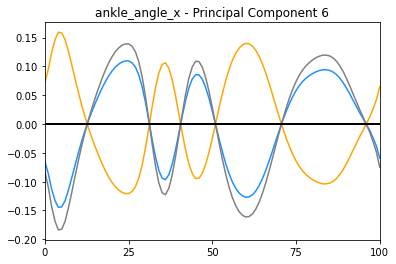

----------------------
Average Healthy Score: -0.33107238034298364
Average Injured Score: 1.0435730145667894
Average Recovered Score: -0.012736541155187556


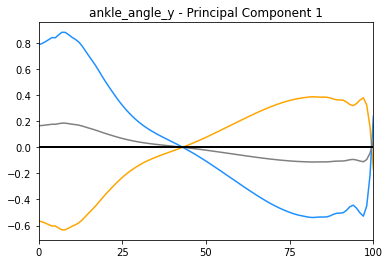

----------------------
Average Healthy Score: -0.3956962710002101
Average Injured Score: -0.9996028709700208
Average Recovered Score: 1.2801553065290319


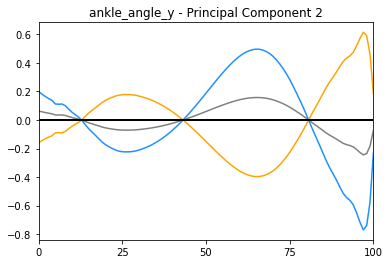

----------------------
Average Healthy Score: 0.13622194570665508
Average Injured Score: -0.30588204938220764
Average Recovered Score: -0.03255010564139277


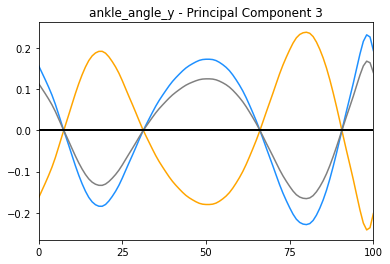

----------------------
Average Healthy Score: 0.02944177309306992
Average Injured Score: 0.10989962703725815
Average Recovered Score: -0.03400536059244808


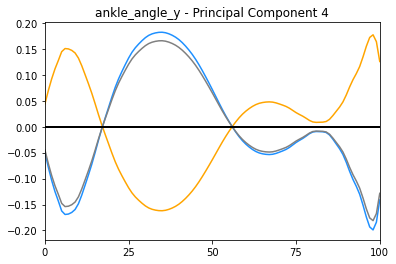

----------------------
Average Healthy Score: -0.1734229075269825
Average Injured Score: 0.22619916304284873
Average Recovered Score: 0.0417833329371692


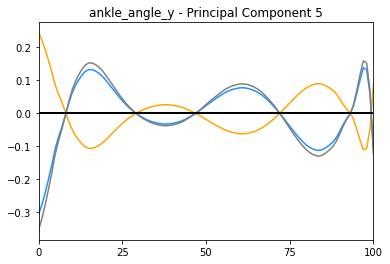

----------------------
Average Healthy Score: 0.12047947986092465
Average Injured Score: -0.09676490037937267
Average Recovered Score: 0.009379190430606161


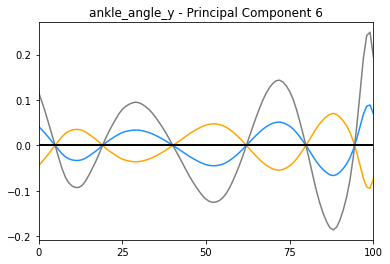

----------------------
Average Healthy Score: 0.2940664952463017
Average Injured Score: 1.1191351542716064
Average Recovered Score: -0.21997321924432875


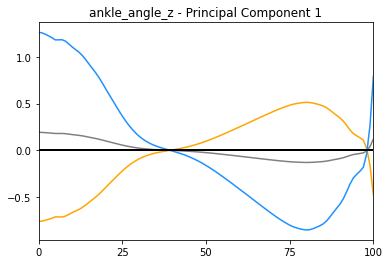

----------------------
Average Healthy Score: 0.21301878613175346
Average Injured Score: -0.2595991931896089
Average Recovered Score: -0.26363232600289277


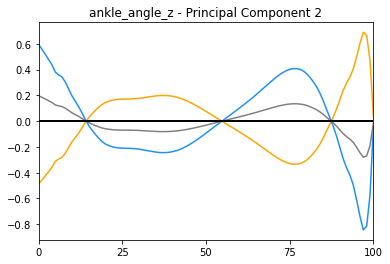

----------------------
Average Healthy Score: 0.6094398849394977
Average Injured Score: -0.31641017467558136
Average Recovered Score: 0.15460203593384336


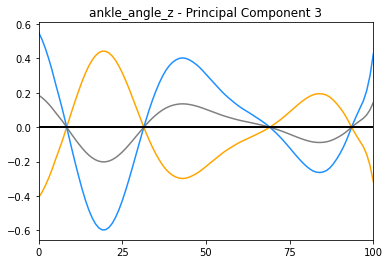

----------------------
Average Healthy Score: -0.009539654035767599
Average Injured Score: -0.501938235584917
Average Recovered Score: 0.3812125437362633


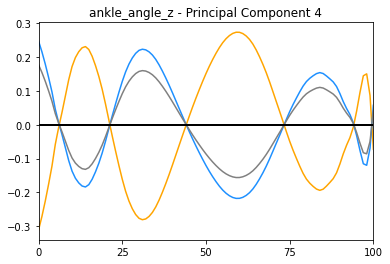

----------------------
Average Healthy Score: 0.11321844950444117
Average Injured Score: 0.07386367405485487
Average Recovered Score: -0.14142408839089587


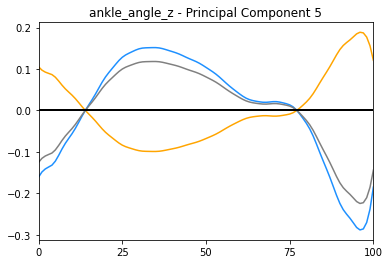

----------------------
Average Healthy Score: -0.01358511177827051
Average Injured Score: -0.12054467148516138
Average Recovered Score: 0.04456012406506001


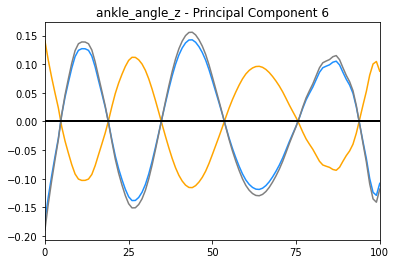

----------------------
Average Healthy Score: -0.19662407060099796
Average Injured Score: -0.5828853633667
Average Recovered Score: 0.7223241520036682


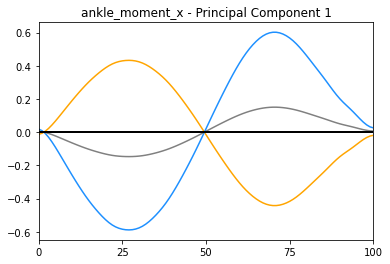

----------------------
Average Healthy Score: 0.2688168363232692
Average Injured Score: -0.18602459365702814
Average Recovered Score: 0.035430058239267606


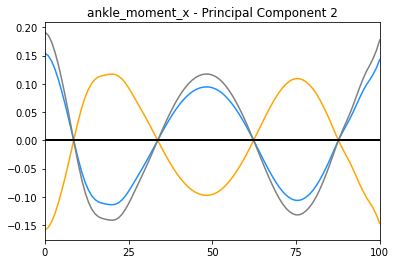

----------------------
Average Healthy Score: -0.040048590244075706
Average Injured Score: 0.01842043219988065
Average Recovered Score: -0.030058667567599517


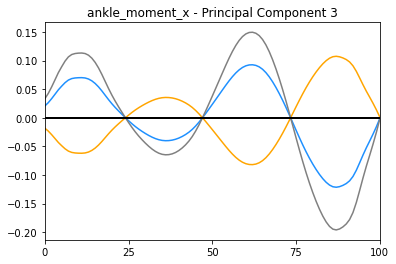

----------------------
Average Healthy Score: -0.08850640598223589
Average Injured Score: 0.0769581519778012
Average Recovered Score: -0.014313899318578524


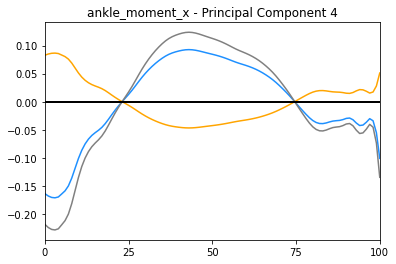

----------------------
Average Healthy Score: -0.017714465323953845
Average Injured Score: -0.0037102503723474537
Average Recovered Score: 0.034609318999512535


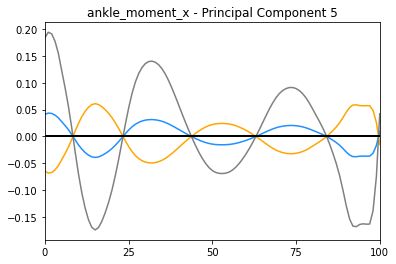

----------------------
Average Healthy Score: 0.005901962217397814
Average Injured Score: -0.021142742833439393
Average Recovered Score: -0.02270020758564952


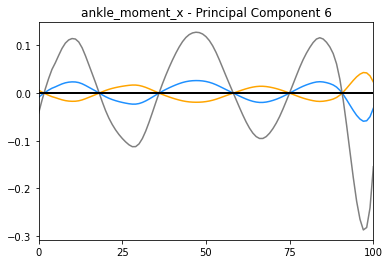

----------------------
Average Healthy Score: -0.7301787082566695
Average Injured Score: -0.7241881629256629
Average Recovered Score: 1.3040536782655865


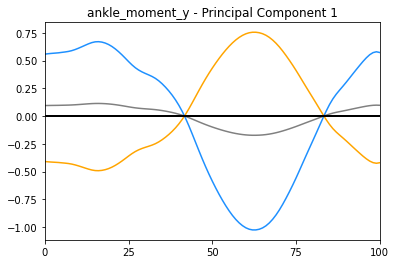

----------------------
Average Healthy Score: 0.05231868481467091
Average Injured Score: -0.08254640943370771
Average Recovered Score: 0.25952725348777334


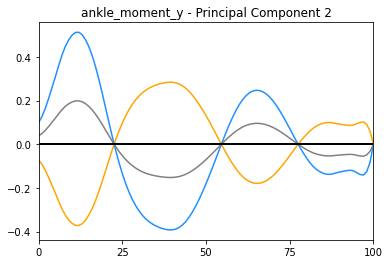

----------------------
Average Healthy Score: 0.003989192805108159
Average Injured Score: -0.10360071268867731
Average Recovered Score: -0.09610131977786825


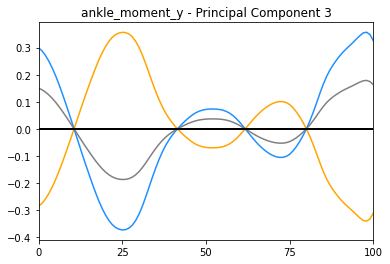

----------------------
Average Healthy Score: -0.2972322176280681
Average Injured Score: -0.01494899758235049
Average Recovered Score: 0.17015343645725212


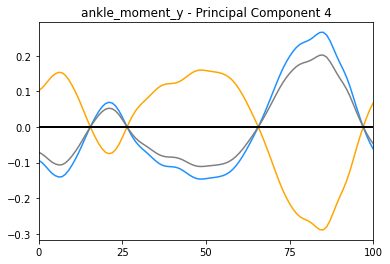

----------------------
Average Healthy Score: 0.17442873622606342
Average Injured Score: -0.19274914034725074
Average Recovered Score: -0.01289043494100082


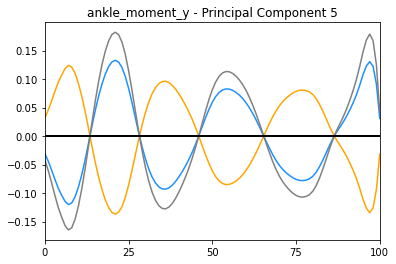

----------------------
Average Healthy Score: 0.053251061175092915
Average Injured Score: 0.02520320731427456
Average Recovered Score: -0.025759460471581046


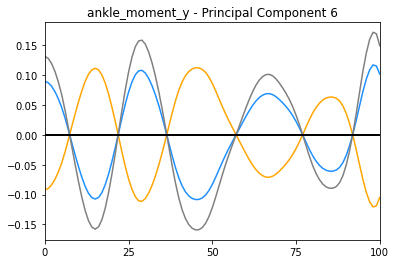

----------------------
Average Healthy Score: -0.9364172737991213
Average Injured Score: 1.90328314114556
Average Recovered Score: -1.0604829968180007


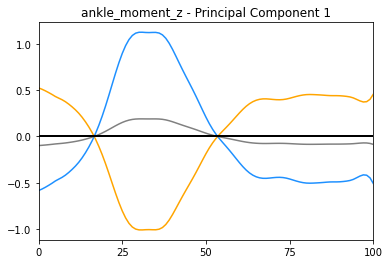

----------------------
Average Healthy Score: -0.3635981839497864
Average Injured Score: -0.08655079002243372
Average Recovered Score: 0.33014084423564666


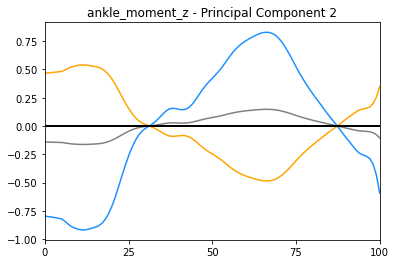

----------------------
Average Healthy Score: 0.21524497767932557
Average Injured Score: -0.12687201713480106
Average Recovered Score: 0.2675941718404878


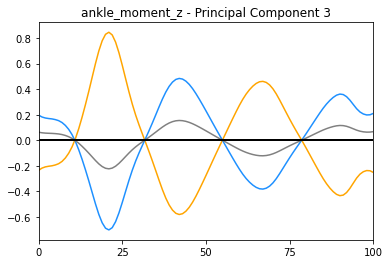

----------------------
Average Healthy Score: -0.5151534256724581
Average Injured Score: -0.39278825606763446
Average Recovered Score: 0.9505439962201597


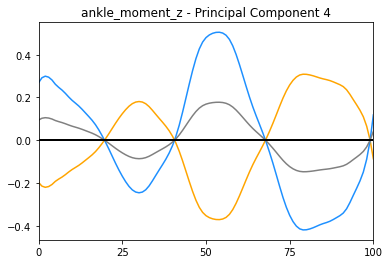

----------------------
Average Healthy Score: 0.3076662693751061
Average Injured Score: -0.16255136795514932
Average Recovered Score: -0.2985399313078994


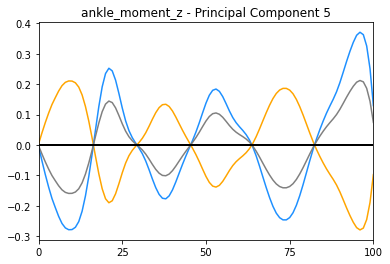

----------------------
Average Healthy Score: -0.0005408790039815351
Average Injured Score: -0.01880880670697005
Average Recovered Score: 0.16202133390887516


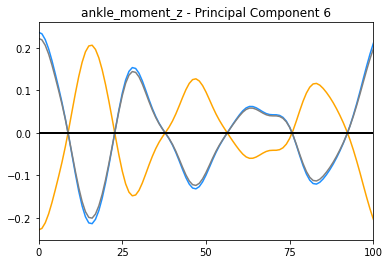

----------------------
Average Healthy Score: 0.6542134927288161
Average Injured Score: -0.43418858094933593
Average Recovered Score: -0.18371412428743228


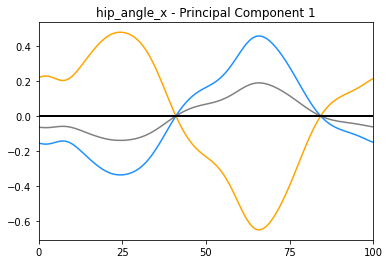

----------------------
Average Healthy Score: -0.0061972631702497056
Average Injured Score: -0.10820097956871548
Average Recovered Score: 0.11669427410568615


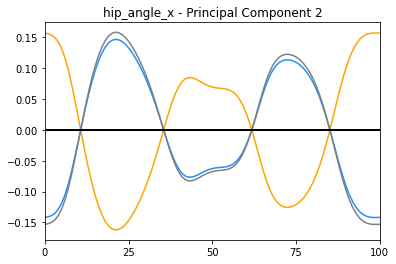

----------------------
Average Healthy Score: 0.026997777547538175
Average Injured Score: -0.13320487443414408
Average Recovered Score: -0.1095909395652811


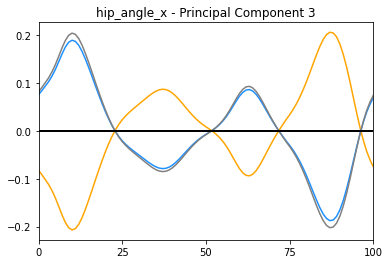

----------------------
Average Healthy Score: -0.0694215892479211
Average Injured Score: 0.012467939907671035
Average Recovered Score: 0.13863882633319083


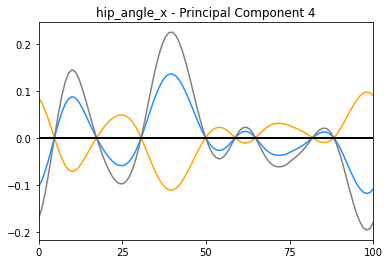

----------------------
Average Healthy Score: -0.07199450722412681
Average Injured Score: 0.09613573530631778
Average Recovered Score: 0.09833881843728305


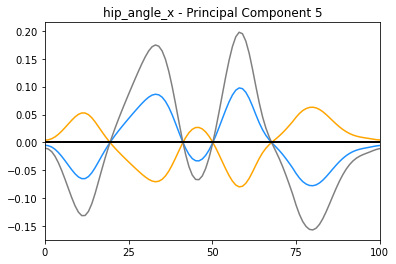

----------------------
Average Healthy Score: 0.009830929753567866
Average Injured Score: 0.008748201437439517
Average Recovered Score: -0.042115073190820806


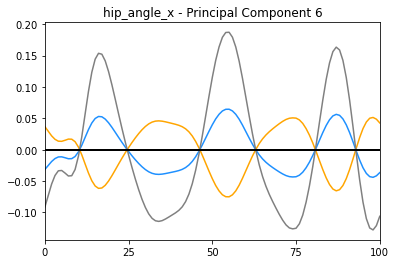

----------------------
Average Healthy Score: 0.7692454540610815
Average Injured Score: -0.9143092908377237
Average Recovered Score: -0.4615469852779949


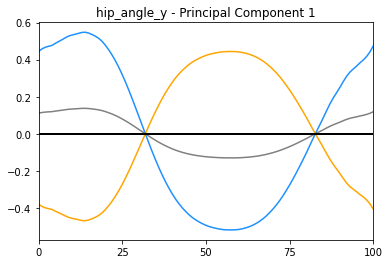

----------------------
Average Healthy Score: 0.37427141403125336
Average Injured Score: -0.6378645442546124
Average Recovered Score: 0.06591551571581891


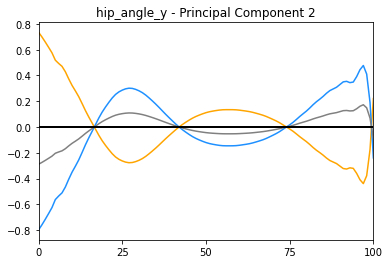

----------------------
Average Healthy Score: -0.22826940687428987
Average Injured Score: 0.3705516259930596
Average Recovered Score: -0.16249066686778627


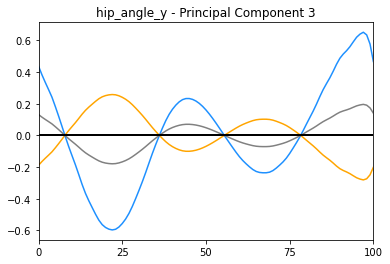

----------------------
Average Healthy Score: 0.2623166557136784
Average Injured Score: 0.2556297506426774
Average Recovered Score: -0.26878974092911373


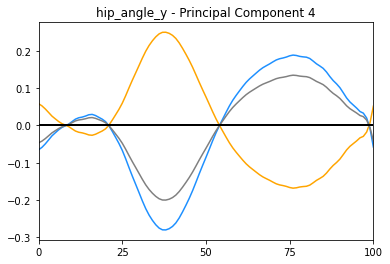

----------------------
Average Healthy Score: 0.0010083685537500165
Average Injured Score: 0.24716280276461777
Average Recovered Score: 0.018425129174100868


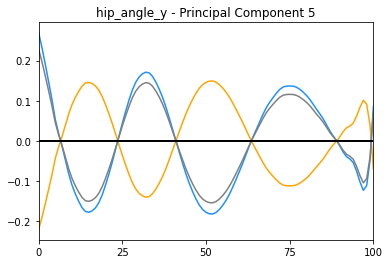

----------------------
Average Healthy Score: -0.12425434035964106
Average Injured Score: 0.05288016041726213
Average Recovered Score: 0.1363505764196742


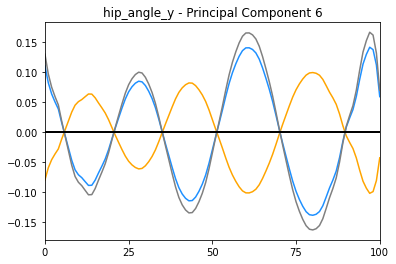

----------------------
Average Healthy Score: -0.27128365038353
Average Injured Score: -0.08997177270937692
Average Recovered Score: 0.6204585304947301


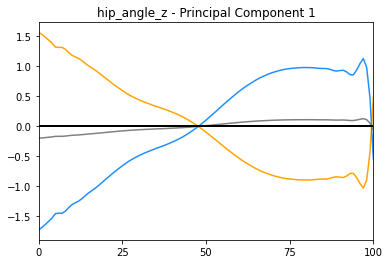

----------------------
Average Healthy Score: 0.152580357980146
Average Injured Score: -0.8785616606654744
Average Recovered Score: -0.37712476820444674


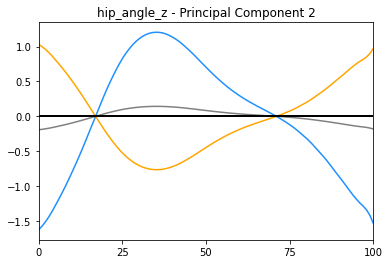

----------------------
Average Healthy Score: -0.07043146322172669
Average Injured Score: 0.652689121742822
Average Recovered Score: -0.5592514122923299


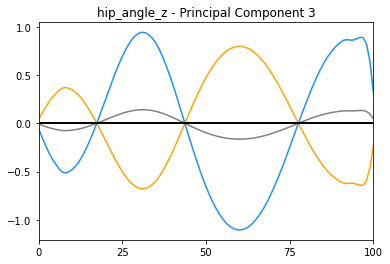

----------------------
Average Healthy Score: 0.9771125862569761
Average Injured Score: -1.0862797799365203
Average Recovered Score: 0.05201048534020991


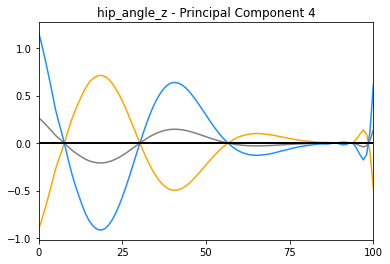

----------------------
Average Healthy Score: -0.5714542649119476
Average Injured Score: 0.04731685418453157
Average Recovered Score: 0.10560165552609363


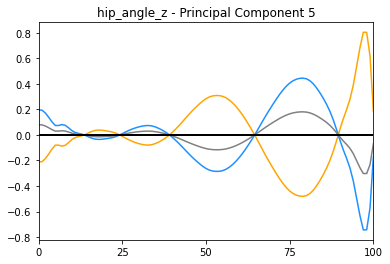

----------------------
Average Healthy Score: -0.28288121724362714
Average Injured Score: 0.4049912565528023
Average Recovered Score: -0.3215919364176015


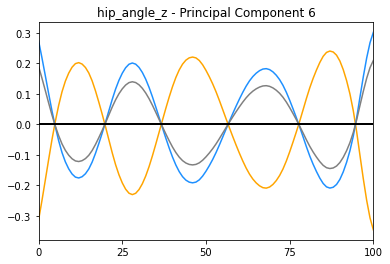

----------------------
Average Healthy Score: 0.0037144989076898895
Average Injured Score: 0.24113634482622479
Average Recovered Score: 0.16432354626703696


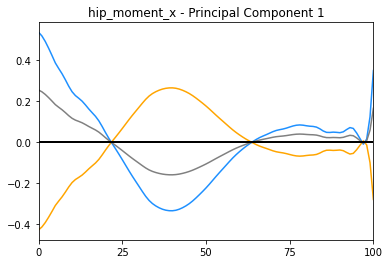

----------------------
Average Healthy Score: 0.0593282920026059
Average Injured Score: 0.126538299310707
Average Recovered Score: -0.052305183623282216


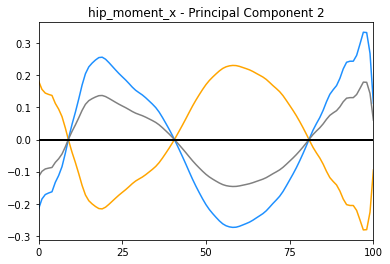

----------------------
Average Healthy Score: -0.09159831207559246
Average Injured Score: 0.17970043109004177
Average Recovered Score: 0.12075814772186584


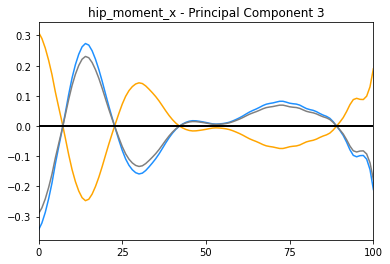

----------------------
Average Healthy Score: -0.03226669608921835
Average Injured Score: -0.15873194790226922
Average Recovered Score: -0.21397223614905792


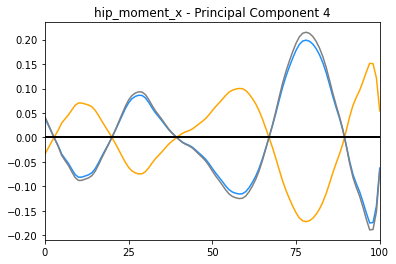

----------------------
Average Healthy Score: -0.027111897450067056
Average Injured Score: 0.2272090193536629
Average Recovered Score: -0.12152249901866764


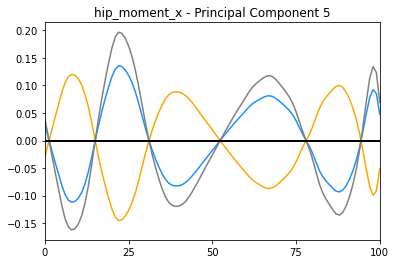

----------------------
Average Healthy Score: 0.057241331154878325
Average Injured Score: -0.09078011843469276
Average Recovered Score: 0.07918725943319214


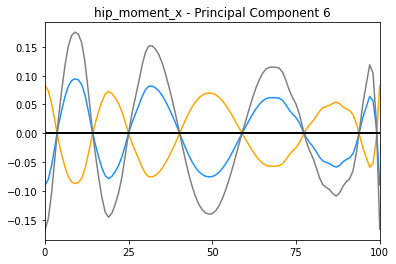

----------------------
Average Healthy Score: 2.1808657321195053
Average Injured Score: -1.785411213216887
Average Recovered Score: -1.9787050118124034


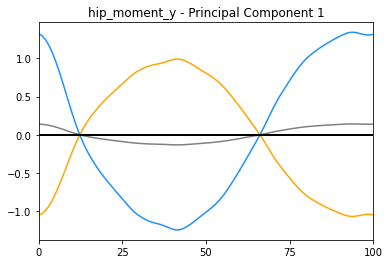

----------------------
Average Healthy Score: -0.4123130300693024
Average Injured Score: 0.5012543517931922
Average Recovered Score: 0.011629457465254308


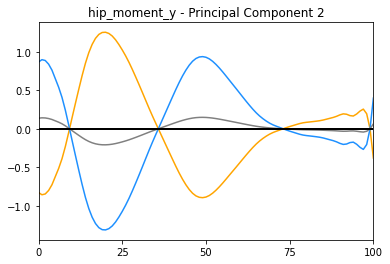

----------------------
Average Healthy Score: -0.6597883043533908
Average Injured Score: 1.7842891139979316
Average Recovered Score: 0.07508602249709828


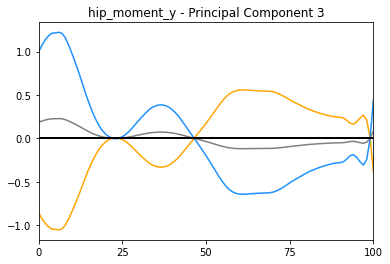

----------------------
Average Healthy Score: -0.2748895814616771
Average Injured Score: -0.5561478017242535
Average Recovered Score: 1.233053681929495


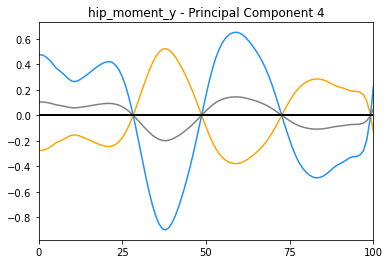

----------------------
Average Healthy Score: -0.2704204905754561
Average Injured Score: 0.12458875411778772
Average Recovered Score: -0.3072343039831366


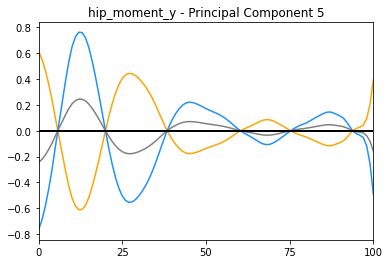

----------------------
Average Healthy Score: 0.03447410537169852
Average Injured Score: -0.13187973166468353
Average Recovered Score: 0.0717067416195551


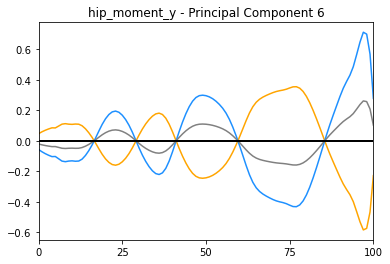

----------------------
Average Healthy Score: 0.059846521146588776
Average Injured Score: 0.36125340680465207
Average Recovered Score: -0.06109444783033443


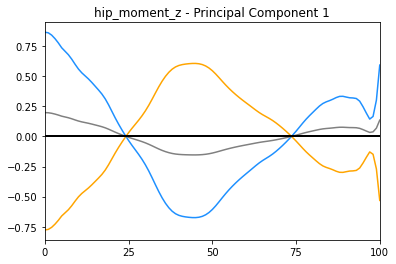

----------------------
Average Healthy Score: 0.016843961216382177
Average Injured Score: -0.29854931345941127
Average Recovered Score: -0.00279592731009524


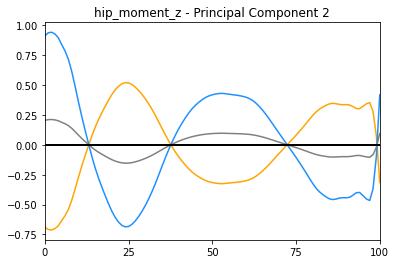

----------------------
Average Healthy Score: 0.4535571871871601
Average Injured Score: -0.3685116788113172
Average Recovered Score: -0.5389614650086797


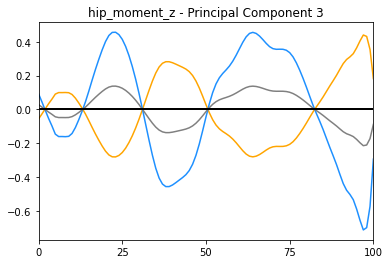

----------------------
Average Healthy Score: 0.5753411974469768
Average Injured Score: -0.20154992551286033
Average Recovered Score: -0.3786297990304392


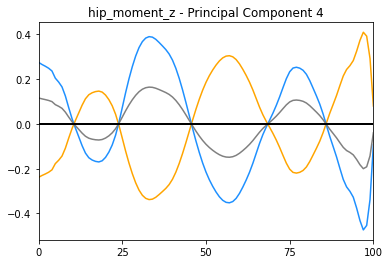

----------------------
Average Healthy Score: -0.1919063213499365
Average Injured Score: 0.014001167269925745
Average Recovered Score: 0.1492704731695141


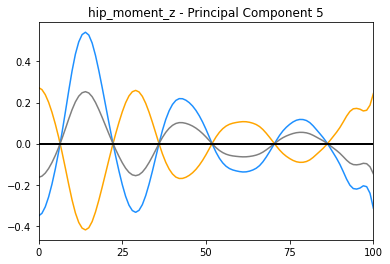

----------------------
Average Healthy Score: -0.3402201951362702
Average Injured Score: 0.1827718113559425
Average Recovered Score: -0.027659003927022755


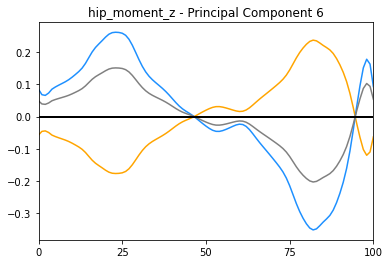

----------------------
Average Healthy Score: 0.5326846788919836
Average Injured Score: -0.537789100243259
Average Recovered Score: -0.16888403882280403


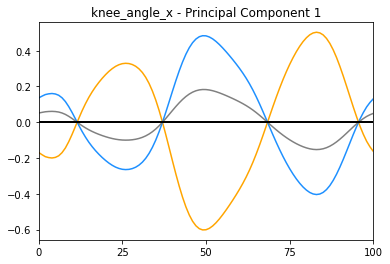

----------------------
Average Healthy Score: -0.07394409857196658
Average Injured Score: 0.009642250134778109
Average Recovered Score: 0.14377194827508474


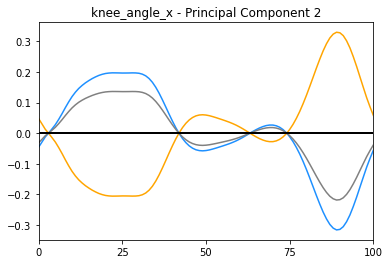

----------------------
Average Healthy Score: -0.2413672563023574
Average Injured Score: 0.3851157435928626
Average Recovered Score: -0.04924790454179722


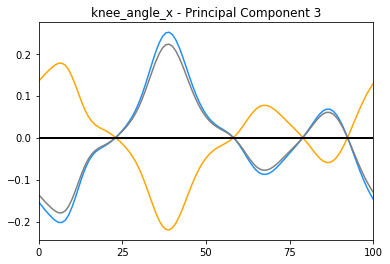

----------------------
Average Healthy Score: -0.04031111708078815
Average Injured Score: -0.0833988262244796
Average Recovered Score: 0.1594801302561429


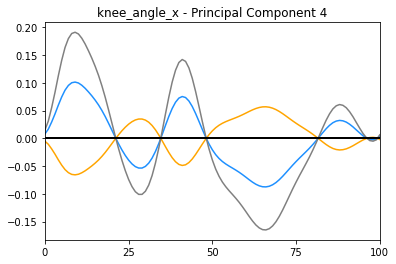

----------------------
Average Healthy Score: -0.025094119890677013
Average Injured Score: 0.014477151939444276
Average Recovered Score: 0.05512618549544357


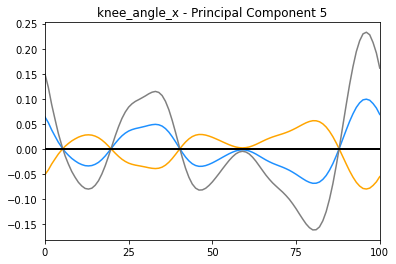

----------------------
Average Healthy Score: 0.07671643720417576
Average Injured Score: -0.07771332388413288
Average Recovered Score: -0.07134836972089424


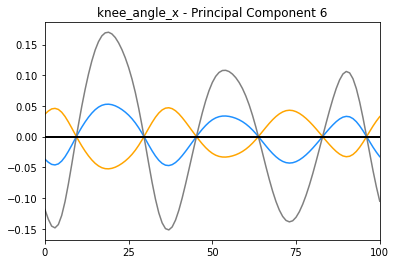

----------------------
Average Healthy Score: 0.4233270610192579
Average Injured Score: -0.2620847806914727
Average Recovered Score: 0.14900859370376773


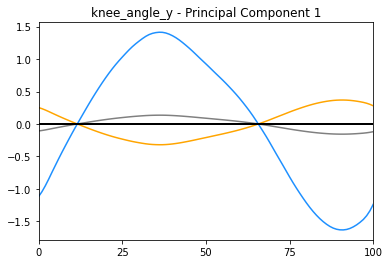

----------------------
Average Healthy Score: -0.28843588003699966
Average Injured Score: 1.7232006118399472
Average Recovered Score: -0.8882332144009922


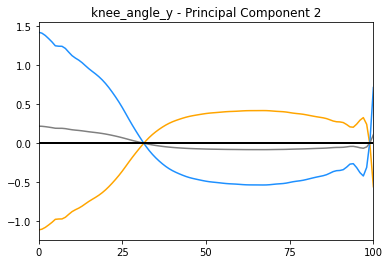

----------------------
Average Healthy Score: 0.31646002413406127
Average Injured Score: -0.02395009478065822
Average Recovered Score: 0.001621105541662421


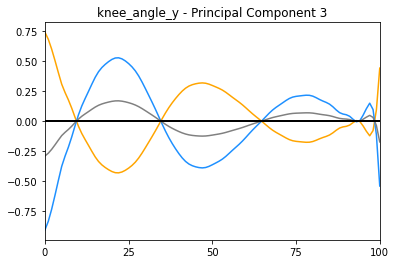

----------------------
Average Healthy Score: -0.7152568981023804
Average Injured Score: -0.17872683157439753
Average Recovered Score: 0.6158873114064233


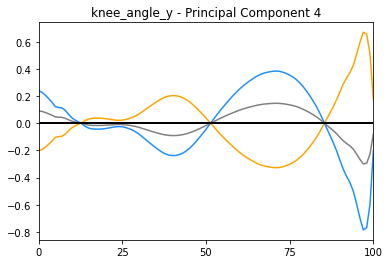

----------------------
Average Healthy Score: -0.29298831766625166
Average Injured Score: -0.12836614087190618
Average Recovered Score: -0.11512193266987188


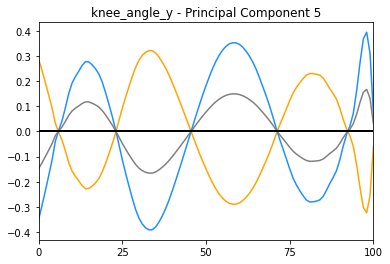

----------------------
Average Healthy Score: 0.21223966352877535
Average Injured Score: 0.04100585008230011
Average Recovered Score: -0.511880849104442


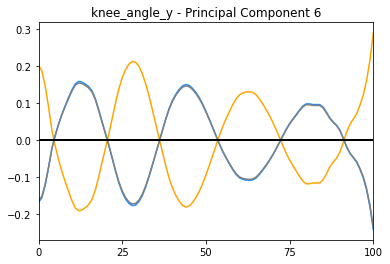

----------------------
Average Healthy Score: 0.007827532704398532
Average Injured Score: 2.1494476586915847
Average Recovered Score: -0.756456526394861


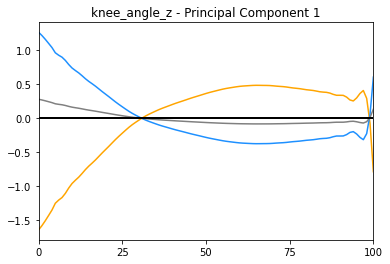

----------------------
Average Healthy Score: -0.11521538410778802
Average Injured Score: 0.37073154509827677
Average Recovered Score: -0.3140820324107904


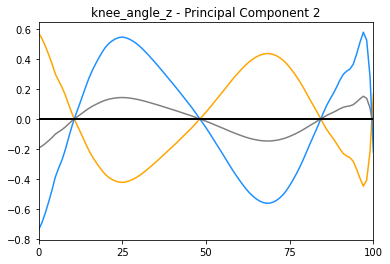

----------------------
Average Healthy Score: 0.13077094532138583
Average Injured Score: 0.601413676088067
Average Recovered Score: -0.43271618075671076


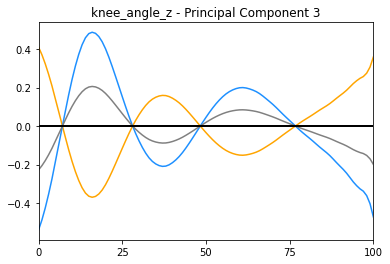

----------------------
Average Healthy Score: 0.8723544788487
Average Injured Score: -0.2901291023059861
Average Recovered Score: -0.10627519255753977


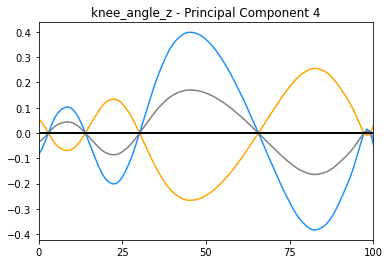

----------------------
Average Healthy Score: -0.18163268588537101
Average Injured Score: 0.16539150328535426
Average Recovered Score: -0.36153826049639


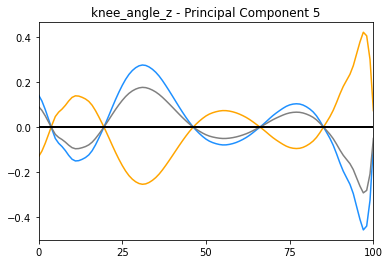

----------------------
Average Healthy Score: -0.10741362808464024
Average Injured Score: -0.07508505731329196
Average Recovered Score: -0.0313773571078701


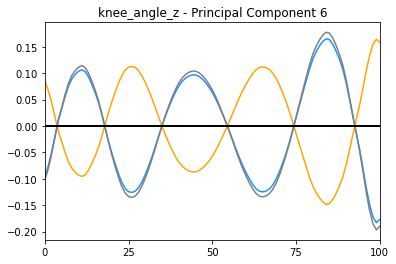

----------------------
Average Healthy Score: -0.4237237517452597
Average Injured Score: -0.5991364313433954
Average Recovered Score: 0.4102730423994667


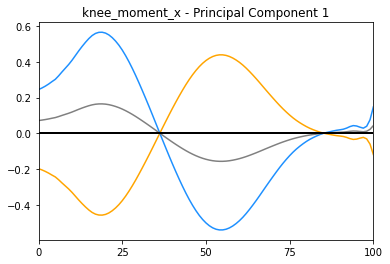

----------------------
Average Healthy Score: -0.2108243080731779
Average Injured Score: 0.6186349057740248
Average Recovered Score: -0.2233878257959422


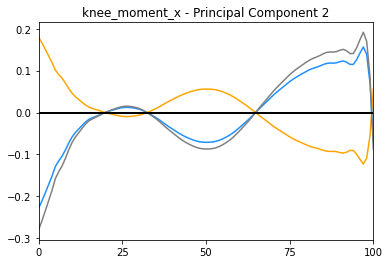

----------------------
Average Healthy Score: 0.4144525573801493
Average Injured Score: -0.10807668046681285
Average Recovered Score: -0.042106969724093474


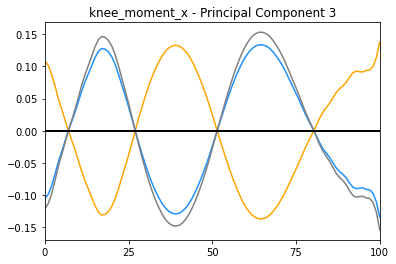

----------------------
Average Healthy Score: -0.009784016638403984
Average Injured Score: -0.0852529311537663
Average Recovered Score: 0.10129444125703846


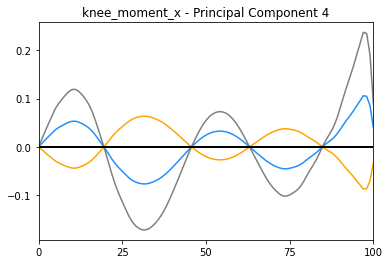

----------------------
Average Healthy Score: 0.052861056892612356
Average Injured Score: 0.015775528106905103
Average Recovered Score: 0.0074725545125536265


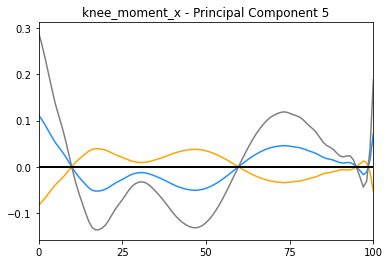

----------------------
Average Healthy Score: -0.02956289873162472
Average Injured Score: 0.00683785066287618
Average Recovered Score: 0.06617486483308656


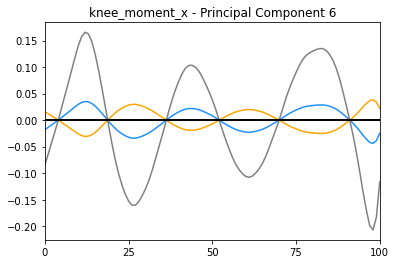

----------------------
Average Healthy Score: 0.6254765246663857
Average Injured Score: -1.0254467006944952
Average Recovered Score: 1.3245434540587233


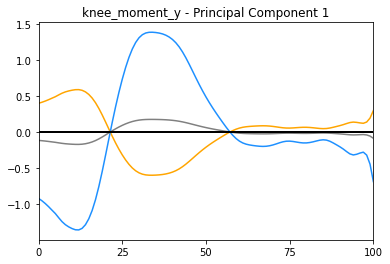

----------------------
Average Healthy Score: 0.03955140089910607
Average Injured Score: 0.21268741976659292
Average Recovered Score: 0.6200621230412612


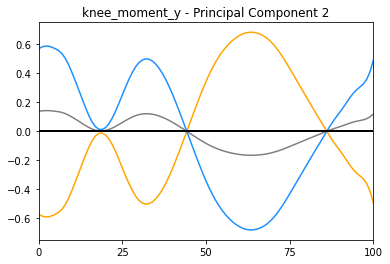

----------------------
Average Healthy Score: -0.619056205118293
Average Injured Score: 1.3202770191530462
Average Recovered Score: -0.5347637356678833


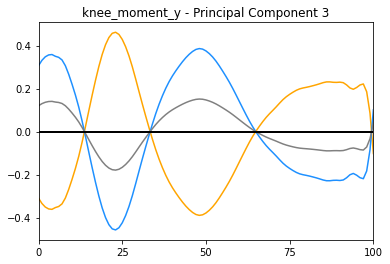

----------------------
Average Healthy Score: 0.21043819390279944
Average Injured Score: -0.37653711406254864
Average Recovered Score: -0.33124081007282014


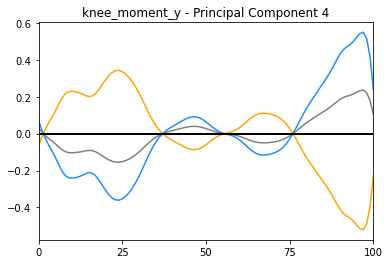

----------------------
Average Healthy Score: -0.029324092625012475
Average Injured Score: 0.09305850905701894
Average Recovered Score: -0.31963890648062976


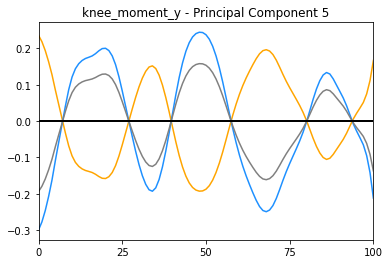

----------------------
Average Healthy Score: -0.3226467201941151
Average Injured Score: 0.1665916032630366
Average Recovered Score: -0.07792977678272342


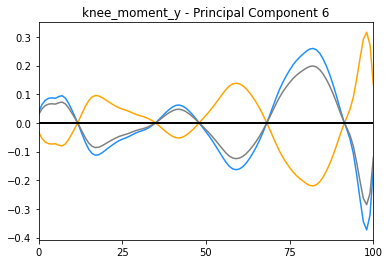

----------------------
Average Healthy Score: 0.06528845386935263
Average Injured Score: 0.7273130879513293
Average Recovered Score: -0.4497476306582276


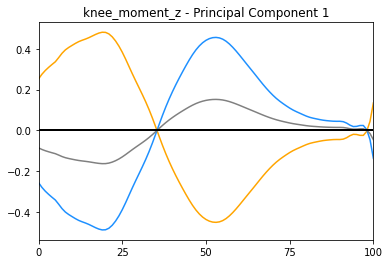

----------------------
Average Healthy Score: 0.0845892160103195
Average Injured Score: 0.04885309343450622
Average Recovered Score: 0.13808500233826584


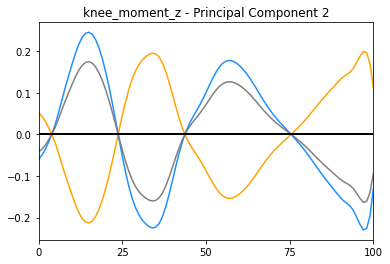

----------------------
Average Healthy Score: -0.07599977271504682
Average Injured Score: -0.2461989769289715
Average Recovered Score: 0.3339857014253269


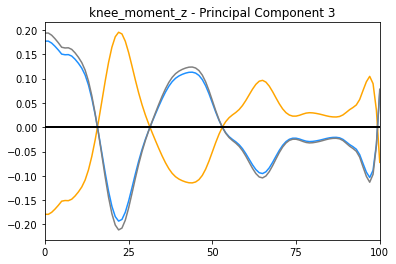

----------------------
Average Healthy Score: -0.08580037765834554
Average Injured Score: 0.13372155458578844
Average Recovered Score: 0.011852731565061317


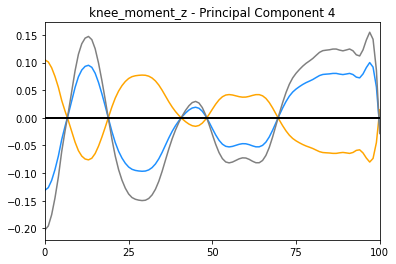

----------------------
Average Healthy Score: -0.09164772219105292
Average Injured Score: 0.019961811401997903
Average Recovered Score: 0.20561604344395434


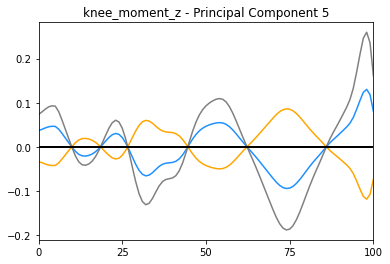

----------------------
Average Healthy Score: -0.07006641097033
Average Injured Score: 0.08127882351320669
Average Recovered Score: 0.09110071258077457


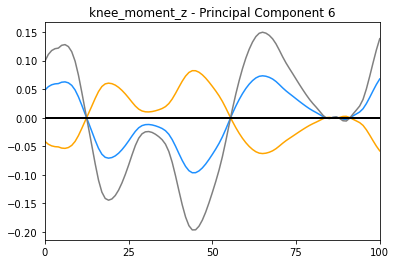

<Figure size 432x288 with 0 Axes>

In [7]:
#choose full gait cycle (GC) or stance phase (stance)
x_axis = 'stance'

#create an array to store eigenvectors, 5th percentile*eigenvector, and 95th percentile*eigenvector
final_kin_pc_eigenvectors_M21 = np.zeros((101,325))
final_kin_pc_eigenvectors_M21[:,0] = list(range(0,101))
column_names = ['x']

#directory for loadings
kin_loadings = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/loadings')))
#kin_loadings.remove('.DS_Store')
#directory for PC scores
kin_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores')))
#kin_pc_scores.remove('.DS_Store')

#initialize a counter
counter = 3

for file_idx, file_name in enumerate(kin_pc_scores):
    #get the current PC_scores_file
    score_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/scores',file_name)
    scores_matrix = pd.read_csv(score_path,sep=',')
    #load the loadings matrix 
    loadings_mat_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/PCA_data_'+x_axis+'/loadings',file_name)
    loadings_matrix = pd.read_csv(loadings_mat_path,sep=',')
    
    #set range to 6 (i'd guess that everything after 5th PC is noise)
    for PC_num in range(6):
        #extract the row of the loadings matrix for the current PC
        loading = loadings_matrix.iloc[PC_num,0:]
        #calculate 5th and 95th percentile scores of the PC and group averages
        PC_scores = scores_matrix[str(PC_num)]
        #5th and 95th percentile
        fifth_percentile = np.percentile(PC_scores, 5)
        nintyfifth_percentile = np.percentile(PC_scores, 95)
        #mean scores
        healthy_scores = scores_matrix.loc[scores_matrix['label'].isin([2])]
        mean_healthy_score = np.average(healthy_scores[str(PC_num)])
        injured_scores = scores_matrix.loc[scores_matrix['label'].isin([4])]
        mean_injured_score = np.average(injured_scores[str(PC_num)])
        recovered_scores = scores_matrix.loc[scores_matrix['label'].isin([6])]
        mean_recovered_score = np.average(recovered_scores[str(PC_num)])
        
        #add eigenvector and eigenvector*percentiles to matrix
        final_kin_pc_eigenvectors_M21[:,counter-2] = pd.Series.to_numpy(loading)
        final_kin_pc_eigenvectors_M21[:,counter-1] = pd.Series.to_numpy(loading*fifth_percentile)
        final_kin_pc_eigenvectors_M21[:,counter] = pd.Series.to_numpy(loading*nintyfifth_percentile)
        #append labels for loadings matrix
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1))
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_5')
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_95')
        
        counter = counter + 3
        
        #Plot the loading vector multiplied by the 5th and 95th percentile of PC_score
        #plt.figure(PC_num)
        print("----------------------")
        print('Average Healthy Score:', mean_healthy_score)
        print('Average Injured Score:', mean_injured_score)
        print('Average Recovered Score:', mean_recovered_score)

        #print('5th Percentile Score:', fifth_percentile)
        #print('95th Percentile Score:', nintyfifth_percentile)
        plt.ion()
        #plt.plot(loading*mean_healthy_score, color = "green")
        #plt.plot(loading*mean_injured_score, color = "red")
        plt.plot(loading*fifth_percentile, color = "orange")
        plt.plot(loading*nintyfifth_percentile, color = "dodgerblue")
        plt.plot(loading, color='gray')
        plt.plot([0, 100], [0, 0], color='k', linewidth=2)
        plt.xlim(0,100)
        plt.title(file_name[0:-4]+' - Principal Component '+ str(PC_num+1))
        plt.xticks([0, 25, 50, 75, 100])
        plt.show()
        #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
        plt.clf()

#convert eigenvectors matrix to dataframe. will merge with EMG data frame later 
final_kin_pc_eigenvectors_M21_df = pd.DataFrame(final_kin_pc_eigenvectors_M21, columns=column_names)

----------------------
Average Healthy Score: 0.9336497194070337
Average Injured Score: -1.7388398844806083


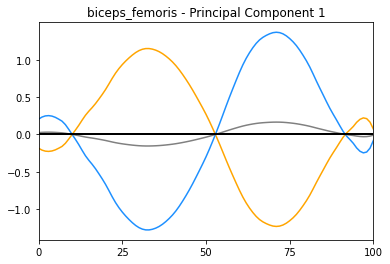

----------------------
Average Healthy Score: -0.47227754871912797
Average Injured Score: -1.308951791767601


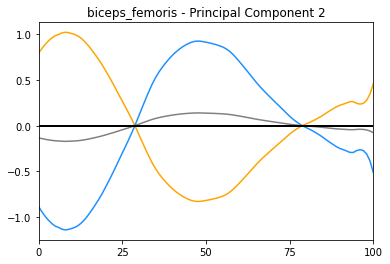

----------------------
Average Healthy Score: -0.40858367025458703
Average Injured Score: 0.11444639010482852


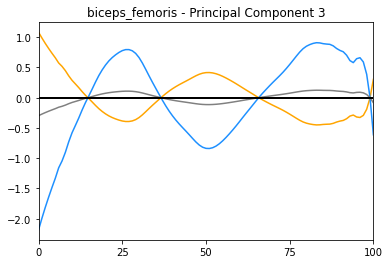

----------------------
Average Healthy Score: -0.5582328783210883
Average Injured Score: 0.5714579067095519


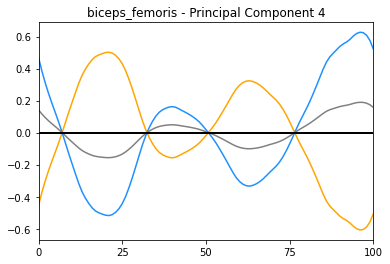

----------------------
Average Healthy Score: 0.1423844601874041
Average Injured Score: -0.28168953690541876


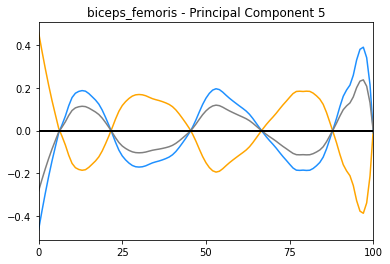

----------------------
Average Healthy Score: 0.09203593730182921
Average Injured Score: 0.016418265996047194


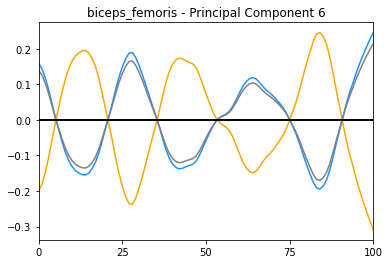

----------------------
Average Healthy Score: -0.09391349361328102
Average Injured Score: -1.591104992890085


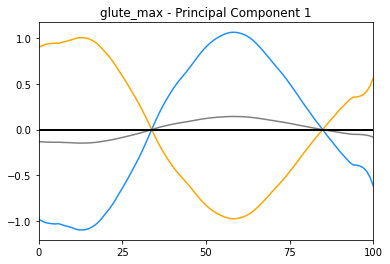

----------------------
Average Healthy Score: 0.8669037941367942
Average Injured Score: -0.6728048934621625


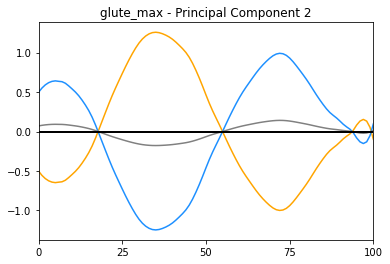

----------------------
Average Healthy Score: -0.716178493971043
Average Injured Score: 0.39386222065795495


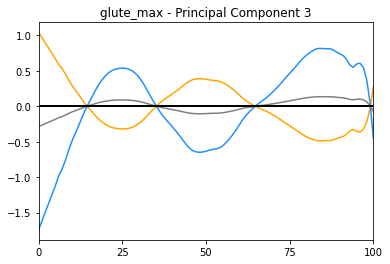

----------------------
Average Healthy Score: -0.17321799079542613
Average Injured Score: 0.48655415981898453


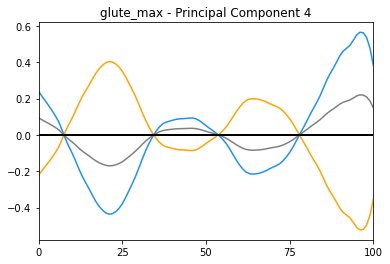

----------------------
Average Healthy Score: 0.21411829609683639
Average Injured Score: 0.12779342853137493


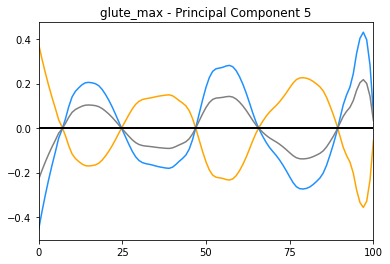

----------------------
Average Healthy Score: -0.21771907684994726
Average Injured Score: 0.13642837157542523


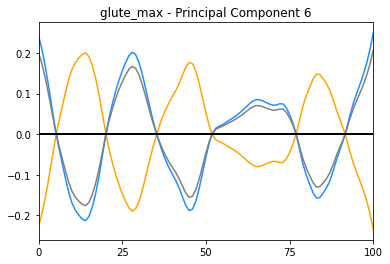

----------------------
Average Healthy Score: 1.300166278062828
Average Injured Score: -0.46066090310560365


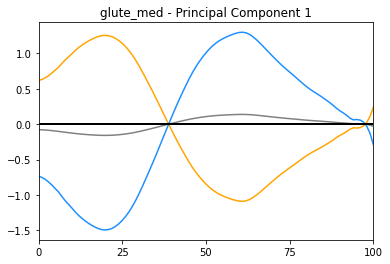

----------------------
Average Healthy Score: -0.7321065889164365
Average Injured Score: 0.4944482276958766


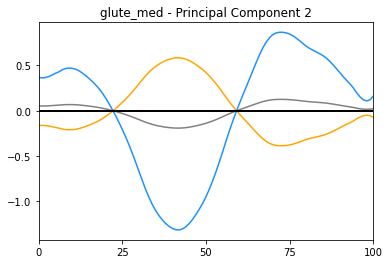

----------------------
Average Healthy Score: -0.07009836923842491
Average Injured Score: 0.5839013908180688


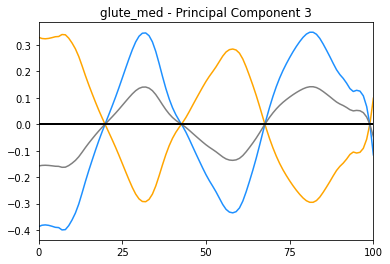

----------------------
Average Healthy Score: 0.32030615393229833
Average Injured Score: -0.29806107956612954


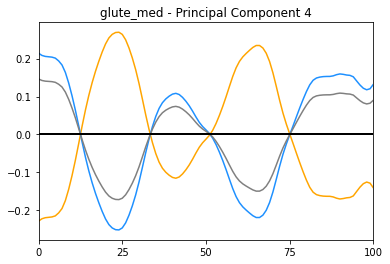

----------------------
Average Healthy Score: 0.027540650624436846
Average Injured Score: -0.3992213995716757


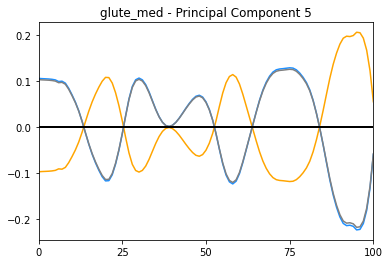

----------------------
Average Healthy Score: -0.0944748335760022
Average Injured Score: -0.0010401083484436072


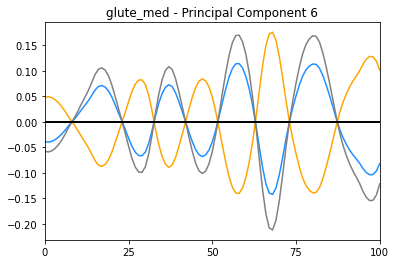

----------------------
Average Healthy Score: 1.1887474855760651
Average Injured Score: -1.0407969496893215


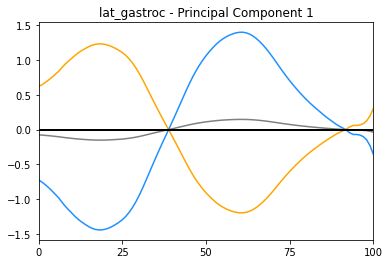

----------------------
Average Healthy Score: -1.1022209476591684
Average Injured Score: 0.9135274226373565


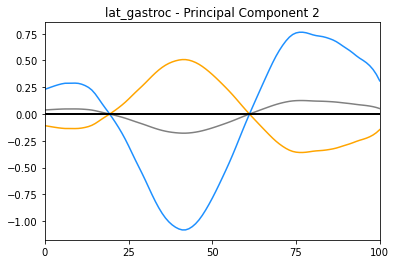

----------------------
Average Healthy Score: 0.09902525051694178
Average Injured Score: 0.6003391178290665


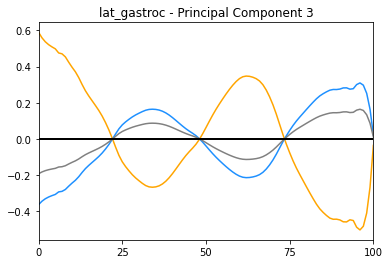

----------------------
Average Healthy Score: -0.1940738013470232
Average Injured Score: 0.3816225362923817


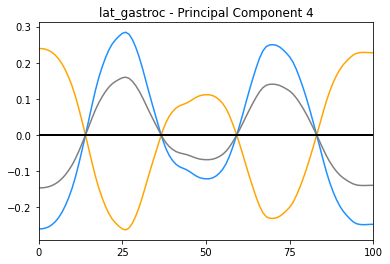

----------------------
Average Healthy Score: 0.13930942293596177
Average Injured Score: -0.18213362663464303


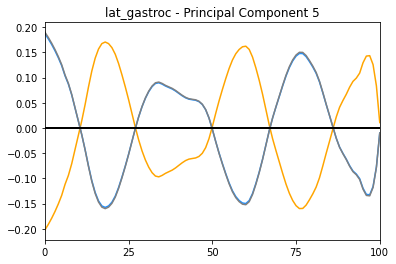

----------------------
Average Healthy Score: 0.04791984364454516
Average Injured Score: -0.08018777507524644


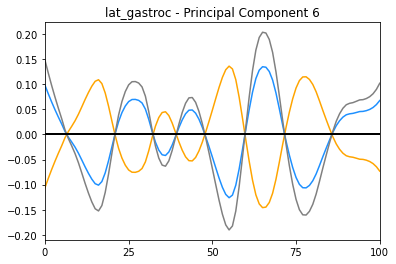

----------------------
Average Healthy Score: 1.2631263638418972
Average Injured Score: -0.6905183744337439


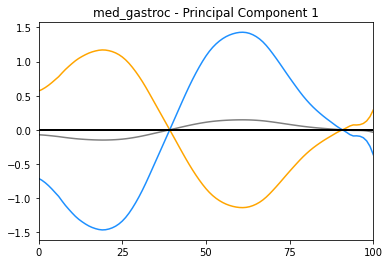

----------------------
Average Healthy Score: -1.1511238136604574
Average Injured Score: 1.1401902798381922


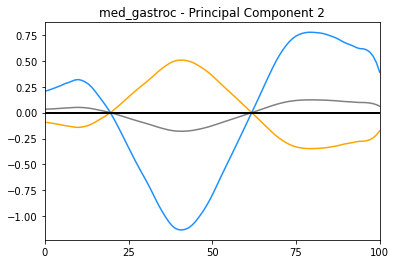

----------------------
Average Healthy Score: 0.14582111229194114
Average Injured Score: 0.6866629014779051


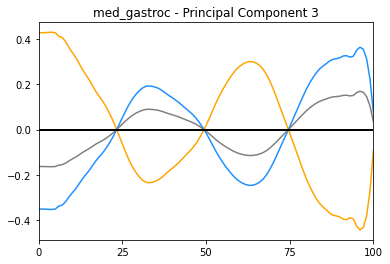

----------------------
Average Healthy Score: -0.17901642992612762
Average Injured Score: 0.5548505786268109


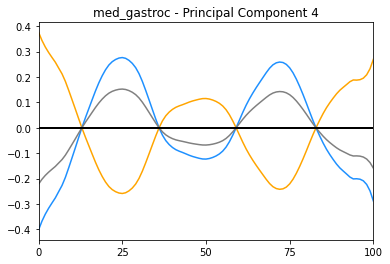

----------------------
Average Healthy Score: -0.03452184560535717
Average Injured Score: 0.09752325370745023


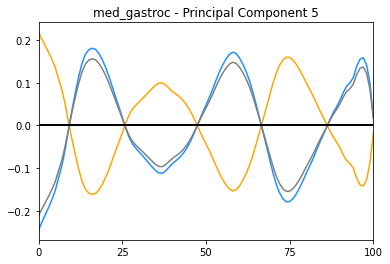

----------------------
Average Healthy Score: -0.06548270034473298
Average Injured Score: 0.21430947276923376


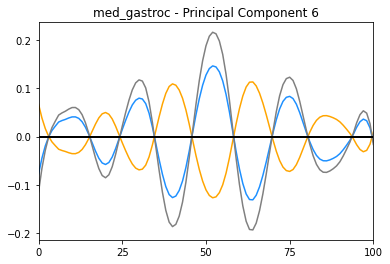

----------------------
Average Healthy Score: 0.9100087230992092
Average Injured Score: 1.0289600468064517


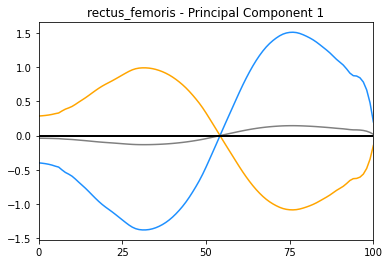

----------------------
Average Healthy Score: -1.323549077784676
Average Injured Score: 0.3528842002562284


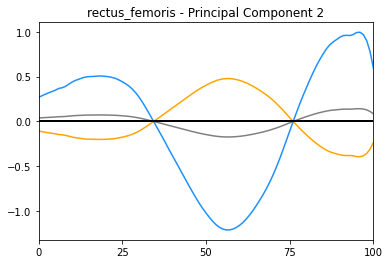

----------------------
Average Healthy Score: 0.05815576318390501
Average Injured Score: -0.10921414666111297


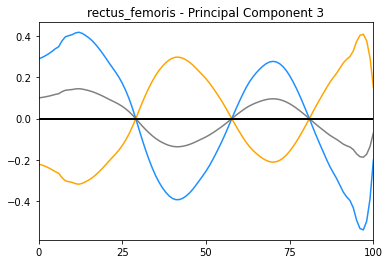

----------------------
Average Healthy Score: -0.04819784696866991
Average Injured Score: 0.20567200123455318


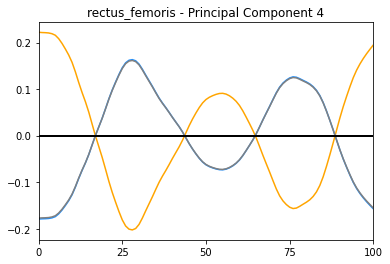

----------------------
Average Healthy Score: -0.05954700321309734
Average Injured Score: 0.009258074322182055


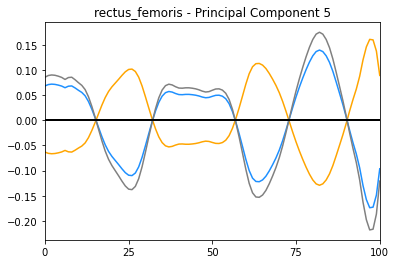

----------------------
Average Healthy Score: -0.16006285281829868
Average Injured Score: -0.016538520064982347


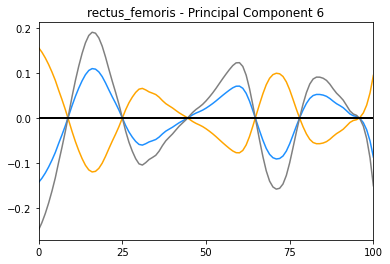

----------------------
Average Healthy Score: 1.3121206146701805
Average Injured Score: 0.9532672429123071


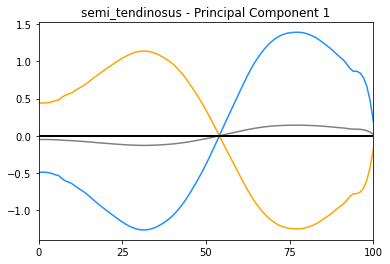

----------------------
Average Healthy Score: -1.0175109232185138
Average Injured Score: 0.7334666464391681


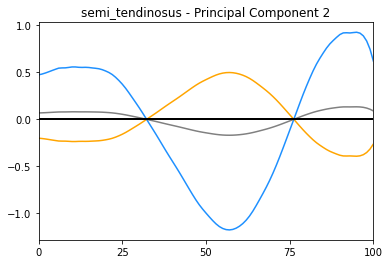

----------------------
Average Healthy Score: -0.11490153718628783
Average Injured Score: -0.06022346910709483


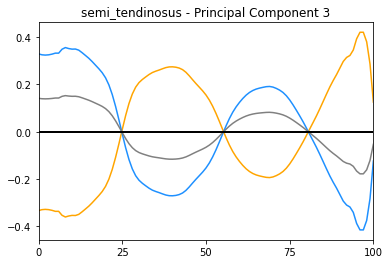

----------------------
Average Healthy Score: 0.0727479753195385
Average Injured Score: -0.1804736651963866


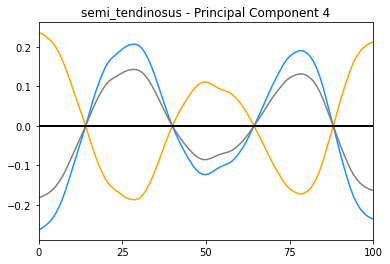

----------------------
Average Healthy Score: 0.06997336472063624
Average Injured Score: 0.03325014426589719


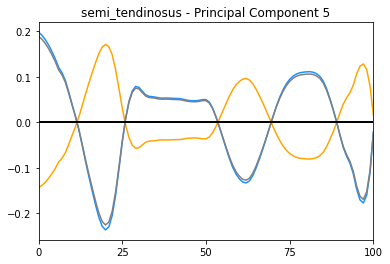

----------------------
Average Healthy Score: -0.027587971519402503
Average Injured Score: -0.04514537915074725


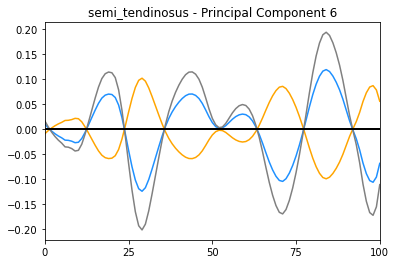

----------------------
Average Healthy Score: 1.1367213769364615
Average Injured Score: 0.8696182661239936


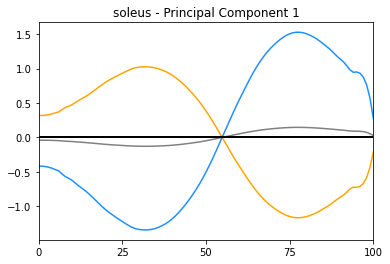

----------------------
Average Healthy Score: -1.1791043893992879
Average Injured Score: 0.7766657675626628


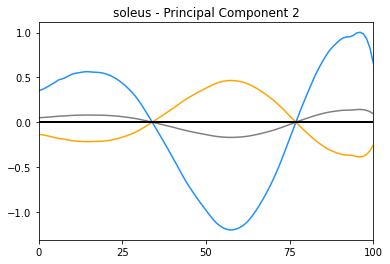

----------------------
Average Healthy Score: -0.09673342315348003
Average Injured Score: -0.1405708307775397


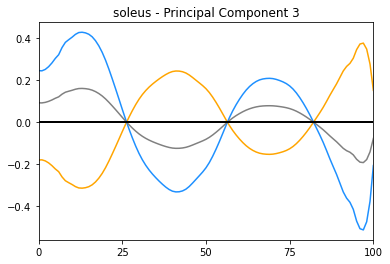

----------------------
Average Healthy Score: 0.17299953610564198
Average Injured Score: -0.007222781477823467


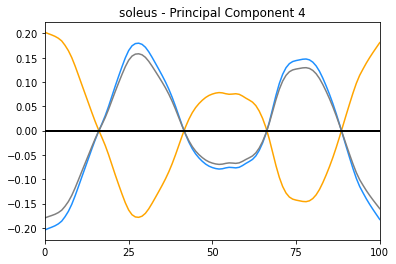

----------------------
Average Healthy Score: 0.1252752922843804
Average Injured Score: -0.0034933755854123665


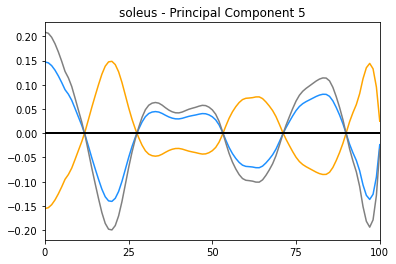

----------------------
Average Healthy Score: -0.059169412254667084
Average Injured Score: -0.020453940487765814


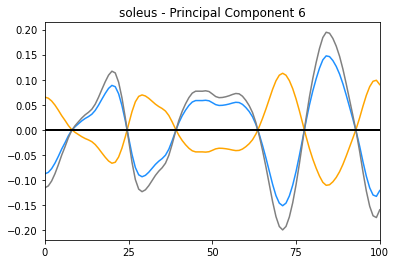

----------------------
Average Healthy Score: 1.7429258983440437
Average Injured Score: -0.006710130986528411


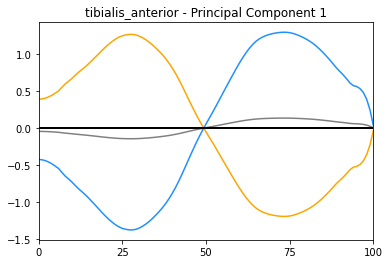

----------------------
Average Healthy Score: -1.170225952187721
Average Injured Score: 0.8802932373043882


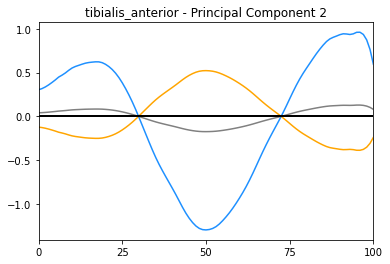

----------------------
Average Healthy Score: 0.19322170579461942
Average Injured Score: 0.0675294972516577


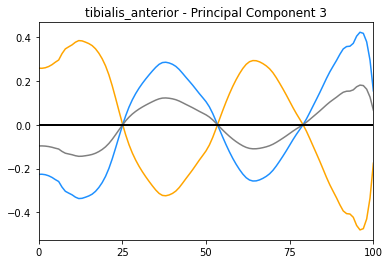

----------------------
Average Healthy Score: 0.0534993471591545
Average Injured Score: -0.19909635786397953


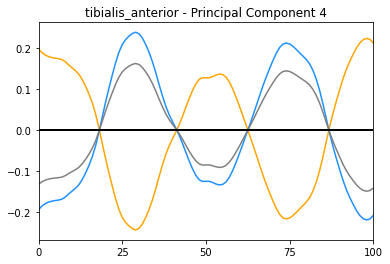

----------------------
Average Healthy Score: 0.10786186702805318
Average Injured Score: -0.16873094391792473


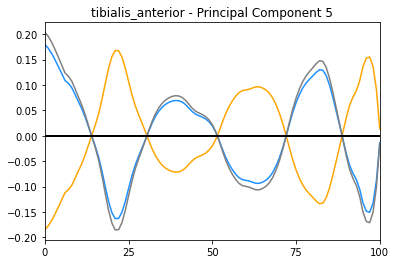

----------------------
Average Healthy Score: -0.03639974230725749
Average Injured Score: 0.1149542406439912


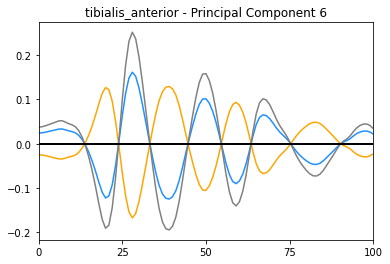

----------------------
Average Healthy Score: 0.9803744349815844
Average Injured Score: 0.963311343572782


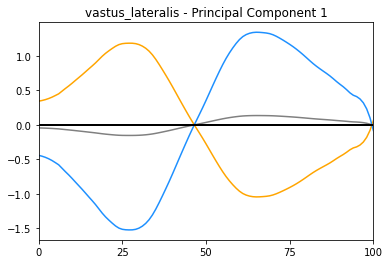

----------------------
Average Healthy Score: -0.48859249765077367
Average Injured Score: 1.1588529671508656


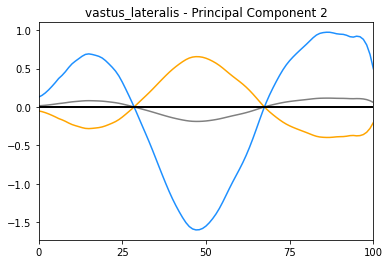

----------------------
Average Healthy Score: -0.3572609343795224
Average Injured Score: 0.13486880005952215


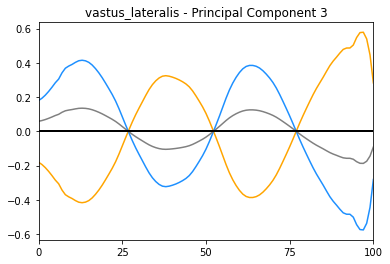

----------------------
Average Healthy Score: 0.21960940096065815
Average Injured Score: -0.15872583351428363


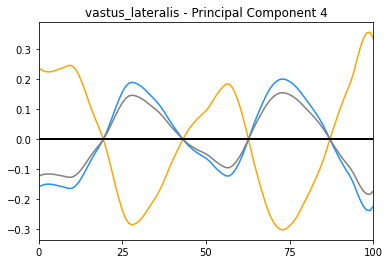

----------------------
Average Healthy Score: -0.3275776673727229
Average Injured Score: 0.12036836581759551


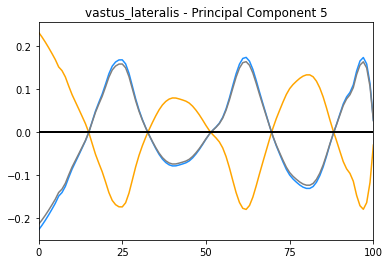

----------------------
Average Healthy Score: 0.0887269894516173
Average Injured Score: -0.047288110217090215


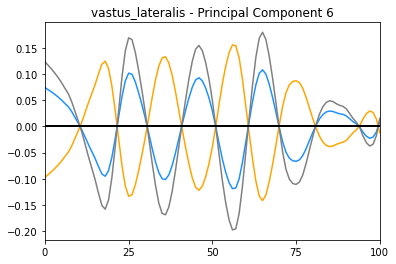

----------------------
Average Healthy Score: 0.9541190433474902
Average Injured Score: 1.3775950301632893


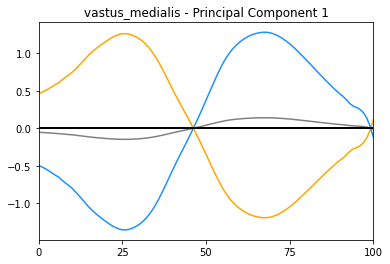

----------------------
Average Healthy Score: -0.07340179424537495
Average Injured Score: 0.17371469355295124


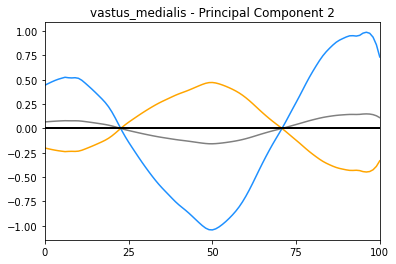

----------------------
Average Healthy Score: 0.20284810635352102
Average Injured Score: 0.4223023622478675


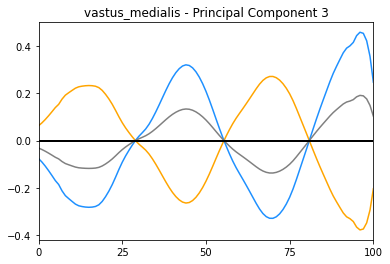

----------------------
Average Healthy Score: -0.14389903875649582
Average Injured Score: 0.13808203197797256


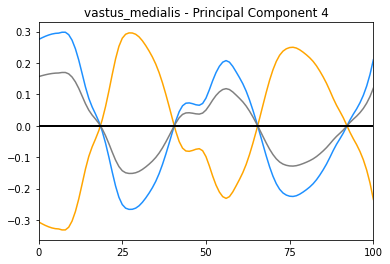

----------------------
Average Healthy Score: -0.15725933008465845
Average Injured Score: 0.17690072784852814


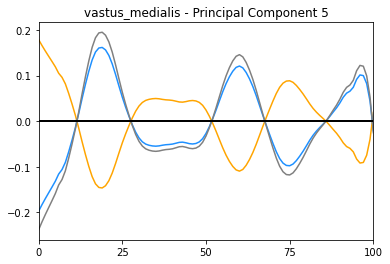

----------------------
Average Healthy Score: -0.09385089748851273
Average Injured Score: 0.21892694685285055


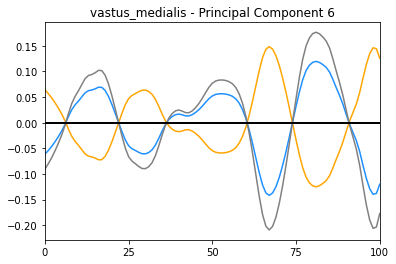

<Figure size 432x288 with 0 Axes>

In [96]:
#choose full gait cycle (GC) or stance phase (stance)
x_axis = 'stance'

#create an array to store eigenvectors, 5th percentile*eigenvector, and 95th percentile*eigenvector
final_emg_pc_eigenvectors_M21 = np.zeros((101,199))
final_emg_pc_eigenvectors_M21[:,0] = list(range(0,101))
column_names = ['x']

#directory for loadings
emg_loadings = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/loadings')))
#directory for scores
emg_pc_scores = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores')))
#emg_pc_scores.remove('.DS_Store')

#initialize a counter
counter = 3

for file_idx, file_name in enumerate(emg_pc_scores):
    #get the current PC_scores_file
    score_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/scores',file_name)
    scores_matrix = pd.read_csv(score_path,sep=',')
    #load the loadings matrix 
    loadings_mat_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/PCA_data_'+x_axis+'/loadings',file_name)
    loadings_matrix = pd.read_csv(loadings_mat_path,sep=',')
    
    #set range to 6 (i'd guess that everything after 5th PC is noise)
    for PC_num in range(6):
        #extract the row of the loadings matrix for the current PC
        loading = loadings_matrix.iloc[PC_num,0:]
        #calculate 5th and 95th percentile scores of the PC and group averages
        PC_scores = scores_matrix[str(PC_num)]
        #5th and 95th percentile
        fifth_percentile = np.percentile(PC_scores, 5)
        nintyfifth_percentile = np.percentile(PC_scores, 95)
        #mean scores
        healthy_scores = scores_matrix.loc[scores_matrix['label'].isin([2])]
        mean_healthy_score = np.average(healthy_scores[str(PC_num)])
        injured_scores = scores_matrix.loc[scores_matrix['label'].isin([4])]
        mean_injured_score = np.average(injured_scores[str(PC_num)])
        
        #add eigenvector and eigenvector*percentiles to matrix
        final_emg_pc_eigenvectors_M21[:,counter-2] = pd.Series.to_numpy(loading)
        final_emg_pc_eigenvectors_M21[:,counter-1] = pd.Series.to_numpy(loading*fifth_percentile)
        final_emg_pc_eigenvectors_M21[:,counter] = pd.Series.to_numpy(loading*nintyfifth_percentile)
        #append labels for loadings matrix
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1))
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_5')
        column_names.append(file_name[0:-4]+'_pc_'+str(PC_num+1)+'_95')
        
        counter = counter + 3
        
        #Plot the loading vector multiplied by the 5th and 95th percentile of PC_score
        #plt.figure(PC_num)
        print("----------------------")
        print('Average Healthy Score:', mean_healthy_score)
        print('Average Injured Score:', mean_injured_score)
        #print('5th Percentile Score:', fifth_percentile)
        #print('95th Percentile Score:', nintyfifth_percentile)
        plt.ion()
        #plt.plot(loading*mean_healthy_score, color = "green")
        #plt.plot(loading*mean_injured_score, color = "red")
        plt.plot(loading*fifth_percentile, color = "orange")
        plt.plot(loading*nintyfifth_percentile, color = "dodgerblue")
        plt.plot(loading, color='gray')
        plt.plot([0, 100], [0, 0], color='k', linewidth=2)
        plt.xlim(0,100)
        plt.title(file_name[0:-4]+' - Principal Component '+ str(PC_num+1))
        plt.xticks([0,25,50,75,100])
        plt.show()
        #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
        plt.clf()
        
#convert eigenvectors matrix to dataframe. will merge with EMG data frame later 
final_emg_pc_eigenvectors_M21_df = pd.DataFrame(final_emg_pc_eigenvectors_M21, columns=column_names)

Merge eigenvectors and eigenvectors*percentile scores into one data frame and export for plotting in R.

In [97]:
final_pc_eigenvectors_M21 = pd.concat([final_kin_pc_eigenvectors_M21_df, final_emg_pc_eigenvectors_M21_df], axis=1)
final_pc_eigenvectors_M21.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/eigenvectors/final_eigenvectors_M21.csv')

Plot ensemble averages of each group on same plot and export

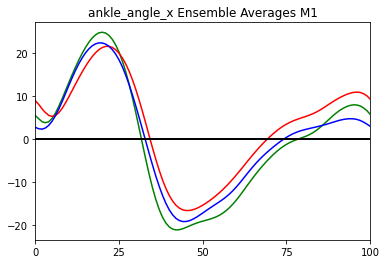

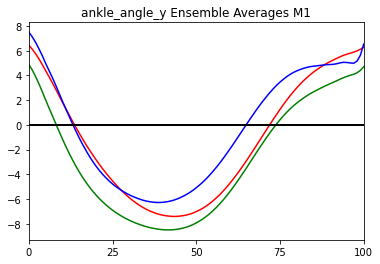

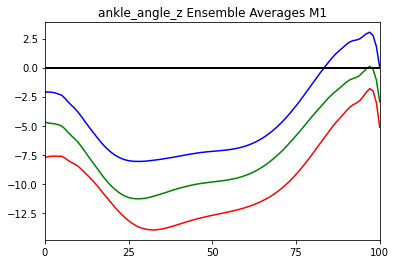

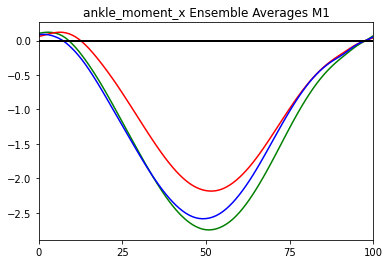

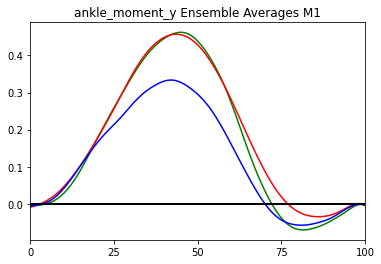

...

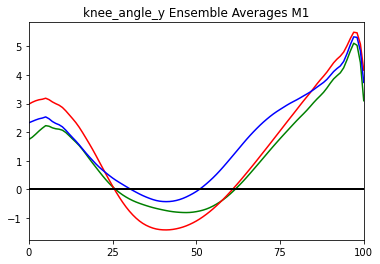

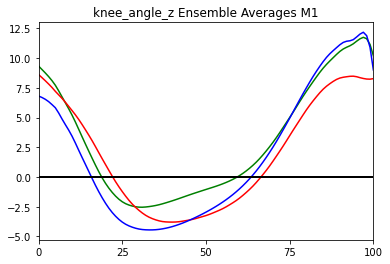

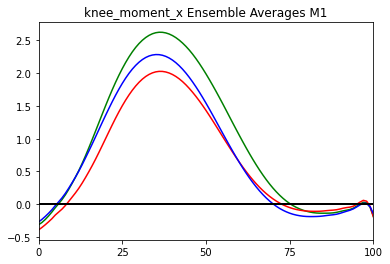

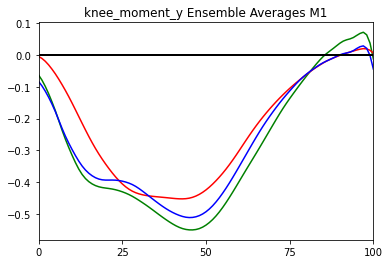

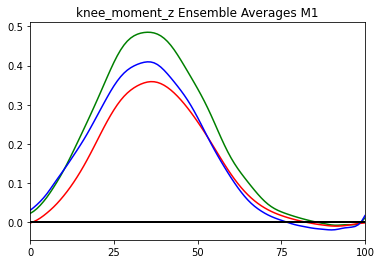

<Figure size 432x288 with 0 Axes>

In [98]:
kin_ensemble_waveforms_M21_healthy = np.zeros((101,19))
kin_ensemble_waveforms_M21_injured = np.zeros((101,19))
kin_ensemble_waveforms_M21_recovered = np.zeros((101,19))
kin_ensemble_waveforms_M21_healthy[:,0] = list(range(0,101))
kin_ensemble_waveforms_M21_injured[:,0] = list(range(0,101))
kin_ensemble_waveforms_M21_recovered[:,0] = list(range(0,101))
column_names = ['x']

#directory for variable waveforms
kin_waveforms = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped')))
kin_waveforms.remove('.DS_Store')

for file_idx, file_name in enumerate(kin_pc_scores):
    #get the current PC_scores_file
    waveform_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic_2/Data/variable_matrices_clipped/',file_name)
    waveform_matrix = pd.read_csv(waveform_path,sep=',')
    
    #calculate ensemble average waveforms for each group at M1
    healthy_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([2])].mean(axis=0).drop('label')
    injured_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([4])].mean(axis=0).drop('label')
    recovered_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([6])].mean(axis=0).drop('label')
    
    #add ensemble average to array
    kin_ensemble_waveforms_M21_healthy[:,file_idx+1] = pd.Series.to_numpy(healthy_ensemble)
    kin_ensemble_waveforms_M21_injured[:,file_idx+1] = pd.Series.to_numpy(injured_ensemble)
    kin_ensemble_waveforms_M21_recovered[:,file_idx+1] = pd.Series.to_numpy(recovered_ensemble)
    #create a list of column names 
    column_names.append(file_name[0:-4])

    #Plot ensembles
    plt.ion()
    plt.plot(healthy_ensemble, color = "green")
    plt.plot(injured_ensemble, color = "red")
    plt.plot(recovered_ensemble, color="blue")
    plt.plot([0, 100], [0, 0], color='k', linewidth=2)
    plt.xlim(0,100)
    plt.title(file_name[0:-4]+' Ensemble Averages M21')
    plt.xticks([0, 25, 50, 75, 100])
    plt.show()
    #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
    plt.clf()

#convert ensemble aveage matrices to pandas data frames
healthy_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M21_healthy, columns=column_names)
injured_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M21_injured, columns=column_names)
recovered_ensemble_df = pd.DataFrame(kin_ensemble_waveforms_M21_recovered, columns=column_names)
#save data frames
healthy_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_healthy_M21.csv')
injured_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_injured_M21.csv')
recovered_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/kin_recovered_M21.csv')

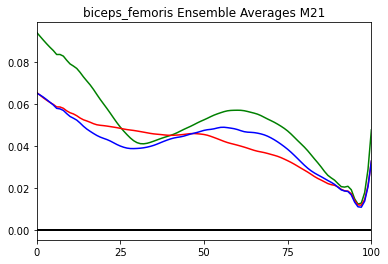

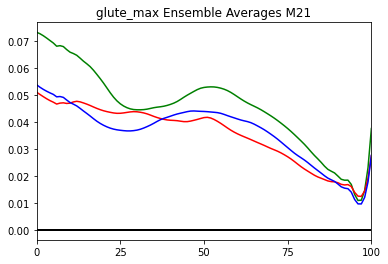

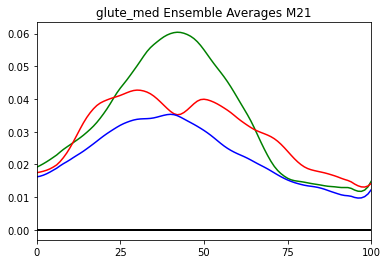

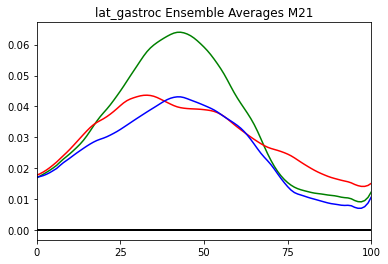

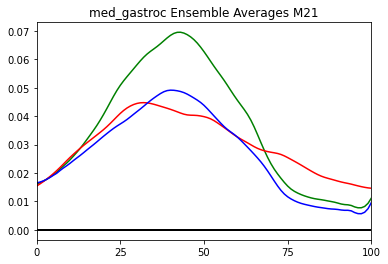

...

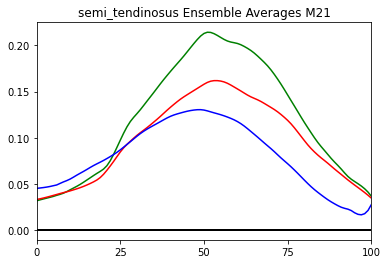

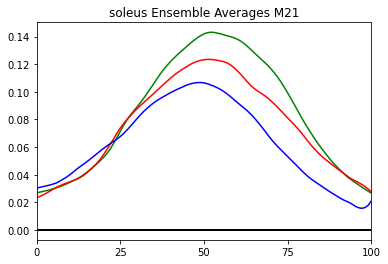

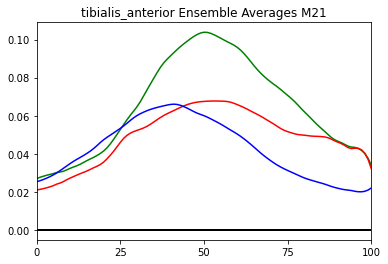

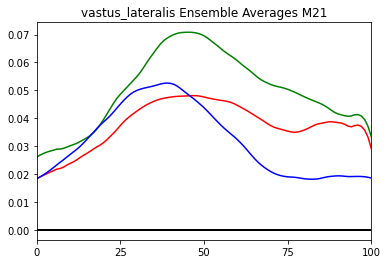

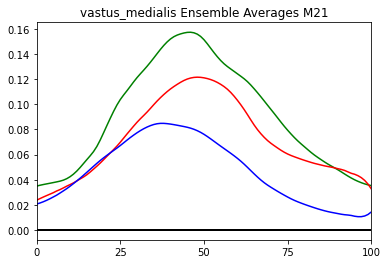

<Figure size 432x288 with 0 Axes>

In [99]:
EMG_ensemble_waveforms_M21_healthy = np.zeros((101,12))
EMG_ensemble_waveforms_M21_injured = np.zeros((101,12))
EMG_ensemble_waveforms_M21_recovered = np.zeros((101,12))
EMG_ensemble_waveforms_M21_healthy[:,0] = list(range(0,101))
EMG_ensemble_waveforms_M21_injured[:,0] = list(range(0,101))
EMG_ensemble_waveforms_M21_recovered[:,0] = list(range(0,101))
column_names = ['x']

#directory for variable waveforms
emg_waveforms = sorted(os.listdir(os.chdir('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped')))
#emg_waveforms.remove('.DS_Store')

for file_idx, file_name in enumerate(emg_pc_scores):
    #get the current PC_scores_file
    waveform_path = os.path.join('/Users/rossbrancati/Desktop/PFP_Project/EMG_2/Data/variable_matrices_clipped/',file_name)
    waveform_matrix = pd.read_csv(waveform_path,sep=',')
    
    #calculate ensemble average waveforms for each group at M1
    healthy_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([2])].mean(axis=0).drop('label')
    injured_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([4])].mean(axis=0).drop('label')
    recovered_ensemble = waveform_matrix.loc[waveform_matrix['label'].isin([6])].mean(axis=0).drop('label')
    
    #add ensemble average to array
    EMG_ensemble_waveforms_M21_healthy[:,file_idx+1] = pd.Series.to_numpy(healthy_ensemble)
    EMG_ensemble_waveforms_M21_injured[:,file_idx+1] = pd.Series.to_numpy(injured_ensemble)
    EMG_ensemble_waveforms_M21_recovered[:,file_idx+1] = pd.Series.to_numpy(recovered_ensemble)
    #create a list of column names 
    column_names.append(file_name[0:-4])
        
    #Plot ensembles
    plt.ion()
    plt.plot(healthy_ensemble, color = "green")
    plt.plot(injured_ensemble, color = "red")
    plt.plot(recovered_ensemble, color="blue")
    plt.plot([0, 100], [0, 0], color='k', linewidth=2)
    plt.xlim(0,100)
    plt.title(file_name[0:-4]+' Ensemble Averages M21')
    plt.xticks([0, 25, 50, 75, 100])
    plt.show()
    #plt.savefig('/Users/rossbrancati/Desktop/PFP_Project/kinetic_kinematic/plots/5_and_95_plots/'+file_name[0:-4]+'/'+file_name[0:-4]+'_PC_'+PC_number)
    plt.clf()
    
#convert ensemble aveage matrices to pandas data frames
healthy_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M21_healthy, columns=column_names)
injured_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M21_injured, columns=column_names)
recovered_ensemble_df = pd.DataFrame(EMG_ensemble_waveforms_M21_recovered, columns=column_names)
#save data frames
healthy_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_healthy_M21.csv')
injured_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_injured_M21.csv')
recovered_ensemble_df.to_csv('/Users/rossbrancati/Desktop/PFP_Project/machine_learning_2/results/mean_waveforms/EMG_recovered_M21.csv')